# Overcoming Catastrophic Forgetting

https://arxiv.org/abs/1612.00796

## Mnist first then Fmnist

In [1]:
import tensorflow as tf

gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
  tf.config.experimental.set_memory_growth(gpu, True)

2024-05-20 13:25:06.620287: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2024-05-20 13:25:09.434908: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2024-05-20 13:25:09.436443: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2024-05-20 13:25:09.577748: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:65:00.0 name: Quadro RTX 5000 computeCapability: 7.5
coreClock: 1.815GHz coreCount: 48 deviceMemorySize: 15.74GiB deviceMemoryBandwidth: 417.29GiB/s
2024-05-20 13:25:09.577794: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2024-05-20 13:25:09.579658: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublas.so.10
2024-

In [2]:
import numpy as np
import tensorflow as tf
import tensorflow.keras.backend as K
from tensorflow.keras.regularizers import Regularizer

#tf.compat.v1.disable_eager_execution()

def computer_fisher(model, imgset, num_sample=30):
    f_accum = []
    for i in range(len(model.weights)):
        f_accum.append(np.zeros(K.int_shape(model.weights[i])))
    f_accum = np.array(f_accum)
    for j in range(num_sample):
        img_index = np.random.randint(imgset.shape[0])
        for m in range(len(model.weights)):                           
            grads = K.gradients(K.log(model.output), model.weights)[m]
            result = K.function([model.input], [grads])
            f_accum[m] += np.square(result([np.expand_dims(imgset[img_index], 0)])[0])
    f_accum /= num_sample
    return f_accum

"""
def ecomputer_fisher(model, imgset, num_sample=30000):
    f_accum = []
    for i in range(len(model.weights)):
        f_accum.append(tf.zeros(model.weights[i].shape))
    f_accum = np.array(f_accum)
    for j in range(num_sample):
        img_index = np.random.randint(len(imgset))
        for m in range(len(model.weights)):
            with tf.GradientTape() as tape:                
                y_preds=tf.math.log(WGN(imgset[img_index]))
            grads = tape.gradient(y_preds, model.weights)[m]
            f_accum[m] += tf.square(grads[0])
    f_accum /= num_sample
    return f_accum
"""
"""
def ecomputer_fisher(model, imgset, num_sample=30000):
    f_accum = [tf.zeros_like(weight) for weight in model.weights]
    for j in range(num_sample):
        img_index = np.random.randint(len(imgset))
        with tf.GradientTape() as tape:
            y_preds = model(imgset[img_index])  # Assuming model directly predicts logit values
            loss = tf.reduce_sum(tf.math.log(y_preds))  # Compute log likelihood
        grads = tape.gradient(loss, model.weights)
        for m in range(len(model.weights)):
            f_accum[m] += tf.square(grads[m])
    f_accum = np.asarray(f_accum)/num_sample
    return f_accum
"""
def ecomputer_fisher(model, imgset, num_sample=30, epsilon=1e-10):
    f_accum = [tf.zeros_like(weight) for weight in model.weights]
    for j in range(num_sample):
        img_index = np.random.randint(len(imgset))
        with tf.GradientTape() as tape:
            y_preds = model(imgset[img_index])
            # Clip probabilities to avoid taking the logarithm of zero or one
            y_preds = tf.clip_by_value(y_preds, epsilon, 1.0 - epsilon)
            # Compute log likelihood
            loss = tf.reduce_sum(tf.math.log(y_preds))
        grads = tape.gradient(loss, model.weights)
        for m in range(len(model.weights)):
            f_accum[m] += tf.square(grads[m])
    f_accum = np.asarray(f_accum)/num_sample
    return f_accum

def ecomputer_fisher_full(model, imgset, epsilon=1e-10):
    f_accum = [tf.zeros_like(weight) for weight in model.weights]
    for i in range(len(imgset)):
        with tf.GradientTape() as tape:
            y_preds = model(imgset[i])
            # Clip probabilities to avoid taking the logarithm of zero or one
            y_preds = tf.clip_by_value(y_preds, epsilon, 1.0 - epsilon)
            # Compute log likelihood
            loss = tf.reduce_sum(tf.math.log(y_preds))
        grads = tape.gradient(loss, model.weights)
        for m in range(len(model.weights)):
            f_accum[m] += tf.square(grads[m])
    f_accum = np.asarray(f_accum)/len(imgset)
    return f_accum

class ewc_reg(Regularizer):
    def __init__(self, fisher, prior_weights, Lambda=0.1):
        self.fisher = fisher
        self.prior_weights = prior_weights
        self.Lambda = Lambda

    def __call__(self, x):
        regularization = 0.
        regularization += self.Lambda * tf.reduce_sum(self.fisher * tf.square(x - self.prior_weights))
        return regularization

    def get_config(self):
        return {'Lambda': float(self.Lambda)}

2024-05-20 13:25:11.316284: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-05-20 13:25:11.317391: I tensorflow/compiler/jit/xla_gpu_device.cc:99] Not creating XLA devices, tf_xla_enable_xla_devices not set
2024-05-20 13:25:11.318347: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:65:00.0 name: Quadro RTX 5000 computeCapability: 7.5
coreClock: 1.815GHz coreCount: 48 deviceMemorySize: 15.74GiB deviceMemoryBandwidth: 417.29GiB/s
2024-05-20 13:25:11.318394: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2024-05-20 13:25:11.318455: I tensorflow/stream_executor/platform/de

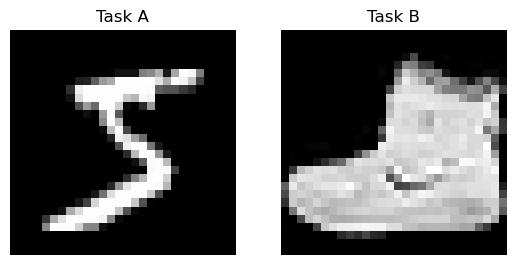

In [3]:
from tensorflow.keras.layers import Dense
from tensorflow.keras.datasets import mnist, fashion_mnist
from tensorflow.keras.models import Sequential
import numpy as np
import matplotlib.pyplot as plt

(x_train, y_train), (x_test, y_test) = mnist.load_data()
x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
x_train /= 255
x_test /= 255

# convert class vectors to binary class matrices
y_train = tf.keras.utils.to_categorical(y_train, 10)
y_test = tf.keras.utils.to_categorical(y_test, 10)

a = np.zeros((len(y_train),1))
b = np.zeros((len(y_test),1))

for i in range(10):
    y_train = np.hstack((y_train, a))
    y_test = np.hstack((y_test, b))

# Original MNIST for Task A
x_train = x_train.reshape((-1, 784))
x_test = x_test.reshape((-1, 784))

# fmnist for Task B
(x_train1, y_train1), (x_test1, y_test1) = fashion_mnist.load_data()
x_train1 = x_train1.astype('float32')
x_test1 = x_test1.astype('float32')
x_train1 /= 255
x_test1 /= 255

x_train1 = x_train1.reshape((-1, 784))
x_test1 = x_test1.reshape((-1, 784))

# convert class vectors to binary class matrices
y_train1 = tf.keras.utils.to_categorical(y_train1, 10)
y_test1 = tf.keras.utils.to_categorical(y_test1, 10)

for i in range(10):
    y_train1 = np.hstack((a, y_train1))
    y_test1 = np.hstack((b, y_test1))

train_dataset = tf.data.Dataset.from_tensor_slices(
    (x_train.reshape(60000, 784).astype("float32") / 255, y_train.reshape(60000, 20))
)
test_dataset = tf.data.Dataset.from_tensor_slices(
    (x_test.reshape(10000, 784).astype("float32") / 255, y_test.reshape(10000, 20))
)

train_dataset1 = tf.data.Dataset.from_tensor_slices(
    (x_train1.reshape(60000, 784).astype("float32") / 255, y_train1.reshape(60000, 20))
)
test_dataset1 = tf.data.Dataset.from_tensor_slices(
    (x_test1.reshape(10000, 784).astype("float32") / 255, y_test1.reshape(10000, 20))
)

train_dataset = train_dataset.shuffle(buffer_size=60000).batch(1)
test_dataset = test_dataset.shuffle(buffer_size=10000).batch(1)
train_dataset1 = train_dataset1.shuffle(buffer_size=60000).batch(1)
test_dataset1 = test_dataset1.shuffle(buffer_size=10000).batch(1)

# Display three Tasks Dataset images
plt.figure()
plt.subplot(1, 2, 1)
plt.imshow(x_train[0].reshape((28, 28)), cmap='gray')
plt.title('Task A')
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(x_train1[0].reshape((28, 28)), cmap='gray')
plt.title('Task B')
plt.axis('off')
plt.show()



In [4]:
abx_train = np.concatenate((x_train, x_train1), axis=0)
aby_train = np.concatenate((y_train, y_train1), axis=0)
abx_test = np.concatenate((x_test, x_test1), axis=0)
aby_test = np.concatenate((y_test, y_test1), axis=0)

abtrain_dataset = tf.data.Dataset.from_tensor_slices(
    (abx_train.reshape(120000, 784).astype("float32") / 255, aby_train.reshape(120000, 20))
)
abtest_dataset = tf.data.Dataset.from_tensor_slices(
    (abx_test.reshape(20000, 784).astype("float32") / 255, aby_test.reshape(20000, 20))
)
abtrain_dataset = abtrain_dataset.shuffle(buffer_size=120000).batch(1)
abtest_dataset = abtest_dataset.shuffle(buffer_size=20000).batch(1)

In [5]:
import tensorflow as tf
from tensorflow import keras 
import tensorflow.keras.backend as K
import numpy as np

input_dim = 784
classes = 20

main_network = keras.Sequential(
    [
        keras.layers.Dense(128, activation=tf.nn.relu),
        keras.layers.Dense(classes),
    ]
)

for layer in main_network.layers:
    layer.built = True

# number of weight coefficients to generate
num_weights_to_generate = (classes * 128 + classes) + (128 * input_dim + 128)

#instead of tanh, this normalises weight distribution inherently 
#while being positive output function simultaneously solving NaN values of loglikelihood of Fisher Matrix
#Also non monotonicity of gaussian function gives better universal function apporiximation for positive output Neural Net
def gaussian_activation(x): 
    return K.exp(-K.pow(x,2))    

# hypernetwork that generates the weights of the `main_network.
WGN = keras.Sequential(
    [
        keras.layers.Dense(128, activation=tf.nn.gelu),
        #keras.layers.Dense(1024, activation=tf.nn.relu),
        keras.layers.Dense(num_weights_to_generate, activation=gaussian_activation),
    ]
)

In [6]:
# Loss and optimizer.
loss_fn = tf.keras.losses.CategoricalCrossentropy(from_logits=True)
acc_fn = tf.keras.metrics.CategoricalAccuracy()
optimizer = tf.keras.optimizers.Adam()

#@tf.function
def train_step(x, y, WGN, step, ada = 1):
    with tf.GradientTape() as tape:
        if step == 0:
            weights_init = tf.random.uniform((1,num_weights_to_generate))
            # Reshape them to the expected shapes for w and b for the outer model.
            # Layer 0 kernel.
            start_index = 0
            w0_shape = (input_dim, 128)
            w0_coeffs = weights_init[:, start_index : start_index + np.prod(w0_shape)]
            w0 = tf.reshape(w0_coeffs, w0_shape)
            start_index += np.prod(w0_shape)
            # Layer 0 bias.
            b0_shape = (128,)
            b0_coeffs = weights_init[:, start_index : start_index + np.prod(b0_shape)]
            b0 = tf.reshape(b0_coeffs, b0_shape)
            start_index += np.prod(b0_shape)
            # Layer 1 kernel.
            w1_shape = (128, classes)
            w1_coeffs = weights_init[:, start_index : start_index + np.prod(w1_shape)]
            w1 = tf.reshape(w1_coeffs, w1_shape)
            start_index += np.prod(w1_shape)
            # Layer 1 bias.
            b1_shape = (classes,)
            b1_coeffs = weights_init[:, start_index : start_index + np.prod(b1_shape)]
            b1 = tf.reshape(b1_coeffs, b1_shape)
            start_index += np.prod(b1_shape)

            main_network.layers[0].kernel = w0
            main_network.layers[0].bias = b0
            main_network.layers[1].kernel = w1
            main_network.layers[1].bias = b1
        
        # Predict weights for the outer model.
        weights_pred = WGN(x)

        # Reshape them to the expected shapes for w and b for the outer model.
        # Layer 0 kernel.
        start_index = 0
        w0_shape = (input_dim, 128)
        w0_coeffs = weights_pred[:, start_index : start_index + np.prod(w0_shape)]
        w0 = tf.reshape(w0_coeffs, w0_shape)
        start_index += np.prod(w0_shape)
        # Layer 0 bias.
        b0_shape = (128,)
        b0_coeffs = weights_pred[:, start_index : start_index + np.prod(b0_shape)]
        b0 = tf.reshape(b0_coeffs, b0_shape)
        start_index += np.prod(b0_shape)
        # Layer 1 kernel.
        w1_shape = (128, classes)
        w1_coeffs = weights_pred[:, start_index : start_index + np.prod(w1_shape)]
        w1 = tf.reshape(w1_coeffs, w1_shape)
        start_index += np.prod(w1_shape)
        # Layer 1 bias.
        b1_shape = (classes,)
        b1_coeffs = weights_pred[:, start_index : start_index + np.prod(b1_shape)]
        b1 = tf.reshape(b1_coeffs, b1_shape)
        start_index += np.prod(b1_shape)

        
        # Set the weight predictions as the weight variables on the outer model.
        main_network.layers[0].kernel = (1-ada)*main_network.layers[0].kernel + ada*w0
        main_network.layers[0].bias = (1-ada)*main_network.layers[0].bias + ada*b0
        main_network.layers[1].kernel = (1-ada)*main_network.layers[1].kernel + ada*w1
        main_network.layers[1].bias = (1-ada)*main_network.layers[1].bias + ada*b1
        
        # Inference on the outer model.
        preds = main_network(x)
        loss = loss_fn(y, preds)

    # update accuracy.
    acc_fn.update_state(y, preds)
    train_acc = acc_fn.result()
    # Train only inner model.    
    grads = tape.gradient(loss, WGN.trainable_weights)
    optimizer.apply_gradients(zip(grads, WGN.trainable_weights))
    return loss, train_acc


In [7]:
tstloss_fn = tf.keras.losses.CategoricalCrossentropy(from_logits=True)
tstacc_fn = tf.keras.metrics.CategoricalAccuracy()

from tensorflow.keras import backend as K

#@tf.function
def test_step(x, y, WGN, ada = 1):
    # Predict weights for the outer model.
    weights_pred = WGN(x)

    # Reshape them to the expected shapes for w and b for the outer model.
    # Layer 0 kernel.
    start_index = 0
    w0_shape = (input_dim, 128)
    w0_coeffs = weights_pred[:, start_index : start_index + np.prod(w0_shape)]
    w0 = tf.reshape(w0_coeffs, w0_shape)
    start_index += np.prod(w0_shape)
    # Layer 0 bias.
    b0_shape = (128,)
    b0_coeffs = weights_pred[:, start_index : start_index + np.prod(b0_shape)]
    b0 = tf.reshape(b0_coeffs, b0_shape)
    start_index += np.prod(b0_shape)
    # Layer 1 kernel.
    w1_shape = (128, classes)
    w1_coeffs = weights_pred[:, start_index : start_index + np.prod(w1_shape)]
    w1 = tf.reshape(w1_coeffs, w1_shape)
    start_index += np.prod(w1_shape)
    # Layer 1 bias.
    b1_shape = (classes,)
    b1_coeffs = weights_pred[:, start_index : start_index + np.prod(b1_shape)]
    b1 = tf.reshape(b1_coeffs, b1_shape)
    start_index += np.prod(b1_shape)

    # Set the weight predictions as the weight variables on the outer model.
    main_network.layers[0].kernel = (1-ada)*main_network.layers[0].kernel + ada*w0
    main_network.layers[0].bias = (1-ada)*main_network.layers[0].bias + ada*b0
    main_network.layers[1].kernel = (1-ada)*main_network.layers[1].kernel + ada*w1
    main_network.layers[1].bias = (1-ada)*main_network.layers[1].bias + ada*b1

    # Inference on the outer model.
    preds = main_network(x)
    loss = tstloss_fn(y, preds)

    # here X is param 1 (input) and the function returns output from layers
    # Inference on the outer model.
    get_layer_output = K.function(
      [main_network.layers[0].input], # param 1 will be treated as layer[0].output
      [main_network.layers[1].output]) 

    lyr = get_layer_output(x)

    # update accuracy.
    tstacc_fn.update_state(y, preds)
    test_acc = tstacc_fn.result()
 
    return loss, test_acc, preds, lyr, weights_pred

In [8]:
losses = []  # Keep track of the losses over time.
train_accs = []
test_accs = []

#main_network.compile(loss=loss_fn, optimizer=optimizer, metrics=acc_fn)
epochs = 10
for i in range(epochs):
    for step, (x, y) in enumerate(train_dataset):
        loss, train_acc = train_step(x, y, WGN, step)
    
        # Logging.
        losses.append(float(loss))
        train_accs.append(train_acc)
        if step%10000 == 0:
            print("Epochs:", i, "Step in progress:", step)            
    
    acc_fn.reset_states()
    #evaluate on testdata
    for tstep, (xt, yt) in enumerate(test_dataset):
        test_loss, test_acc, preds, _, _ = test_step(xt, yt, WGN)
        test_accs.append(test_acc)
    tstacc_fn.reset_states()
    
    print("Epochs:", i, "Step:", step, "Train Loss:", sum(losses) / len(losses), "Train Acc:", train_acc, "Test Acc:", test_acc)

2024-05-20 13:25:14.740477: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublas.so.10


Epochs: 0 Step in progress: 0
Epochs: 0 Step in progress: 10000
Epochs: 0 Step in progress: 20000
Epochs: 0 Step in progress: 30000
Epochs: 0 Step in progress: 40000
Epochs: 0 Step in progress: 50000
Epochs: 0 Step: 59999 Train Loss: 0.4172199558439708 Train Acc: tf.Tensor(0.87168336, shape=(), dtype=float32) Test Acc: tf.Tensor(0.9206, shape=(), dtype=float32)
Epochs: 1 Step in progress: 0
Epochs: 1 Step in progress: 10000
Epochs: 1 Step in progress: 20000
Epochs: 1 Step in progress: 30000
Epochs: 1 Step in progress: 40000
Epochs: 1 Step in progress: 50000
Epochs: 1 Step: 59999 Train Loss: 0.3037090891186323 Train Acc: tf.Tensor(0.9417, shape=(), dtype=float32) Test Acc: tf.Tensor(0.9511, shape=(), dtype=float32)
Epochs: 2 Step in progress: 0
Epochs: 2 Step in progress: 10000
Epochs: 2 Step in progress: 20000
Epochs: 2 Step in progress: 30000
Epochs: 2 Step in progress: 40000
Epochs: 2 Step in progress: 50000
Epochs: 2 Step: 59999 Train Loss: 0.24444015497553148 Train Acc: tf.Tensor(0

In [9]:

#savemodel
losses = np.cumsum(np.asarray(losses))/range(1,len(losses)+1)
WGN.save("EWGNcc_MnistA.h5")
with open('EWGNcc_MnistA_losses.npy', 'wb') as f:
    np.save(f, losses)
    
with open('EWGNcc_MnistA_tracc.npy', 'wb') as f:
    np.save(f, np.array(train_accs))
with open('EWGNcc_MnistA_tstacc.npy', 'wb') as f:
    np.save(f, np.array(test_accs))

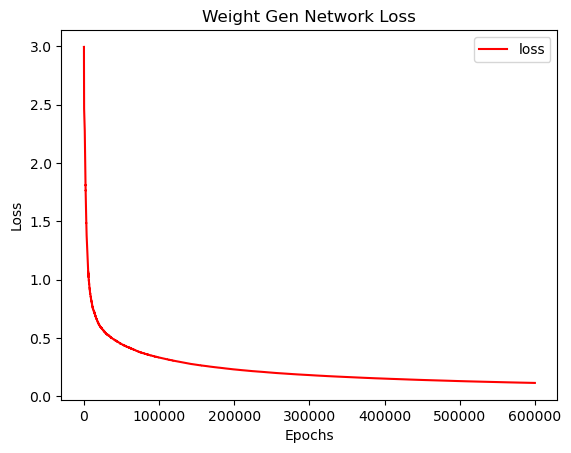

In [10]:
import matplotlib.pyplot as plt

plt.plot(losses, 'r', label='loss')
plt.title('Weight Gen Network Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

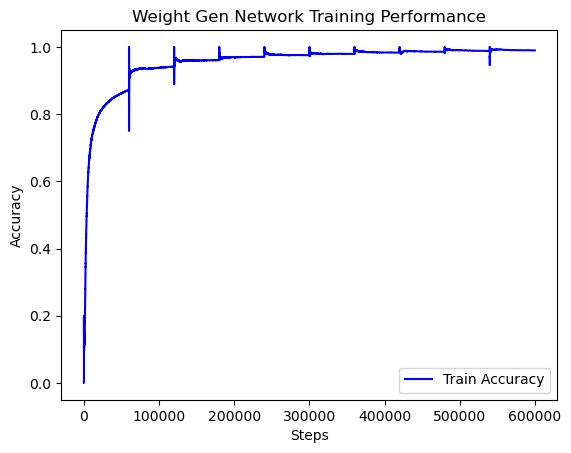

In [11]:
import matplotlib.pyplot as plt

plt.plot(train_accs, 'b', label='Train Accuracy')
plt.title('Weight Gen Network Training Performance')
plt.xlabel('Steps')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

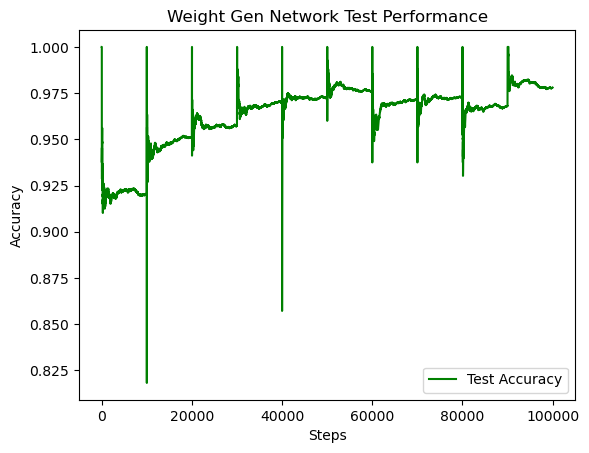

In [12]:
plt.plot(test_accs, 'g', label='Test Accuracy')
plt.title('Weight Gen Network Test Performance')
plt.xlabel('Steps')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [13]:
WGN(x_train[0].reshape(1,784))
WGN.load_weights("EWGNcc_MnistA.h5")

In [14]:
"""
weights_init = tf.random.uniform((1,num_weights_to_generate))
# Reshape them to the expected shapes for w and b for the outer model.
# Layer 0 kernel.
start_index = 0
w0_shape = (input_dim, 128)
w0_coeffs = weights_init[:, start_index : start_index + np.prod(w0_shape)]
w0 = tf.reshape(w0_coeffs, w0_shape)
start_index += np.prod(w0_shape)
# Layer 0 bias.
b0_shape = (128,)
b0_coeffs = weights_init[:, start_index : start_index + np.prod(b0_shape)]
b0 = tf.reshape(b0_coeffs, b0_shape)
start_index += np.prod(b0_shape)
# Layer 1 kernel.
w1_shape = (128, classes)
w1_coeffs = weights_init[:, start_index : start_index + np.prod(w1_shape)]
w1 = tf.reshape(w1_coeffs, w1_shape)
start_index += np.prod(w1_shape)
# Layer 1 bias.
b1_shape = (classes,)
b1_coeffs = weights_init[:, start_index : start_index + np.prod(b1_shape)]
b1 = tf.reshape(b1_coeffs, b1_shape)
start_index += np.prod(b1_shape)

main_network.layers[0].kernel = w0
main_network.layers[0].bias = b0
main_network.layers[1].kernel = w1
main_network.layers[1].bias = b1
"""

'\nweights_init = tf.random.uniform((1,num_weights_to_generate))\n# Reshape them to the expected shapes for w and b for the outer model.\n# Layer 0 kernel.\nstart_index = 0\nw0_shape = (input_dim, 128)\nw0_coeffs = weights_init[:, start_index : start_index + np.prod(w0_shape)]\nw0 = tf.reshape(w0_coeffs, w0_shape)\nstart_index += np.prod(w0_shape)\n# Layer 0 bias.\nb0_shape = (128,)\nb0_coeffs = weights_init[:, start_index : start_index + np.prod(b0_shape)]\nb0 = tf.reshape(b0_coeffs, b0_shape)\nstart_index += np.prod(b0_shape)\n# Layer 1 kernel.\nw1_shape = (128, classes)\nw1_coeffs = weights_init[:, start_index : start_index + np.prod(w1_shape)]\nw1 = tf.reshape(w1_coeffs, w1_shape)\nstart_index += np.prod(w1_shape)\n# Layer 1 bias.\nb1_shape = (classes,)\nb1_coeffs = weights_init[:, start_index : start_index + np.prod(b1_shape)]\nb1 = tf.reshape(b1_coeffs, b1_shape)\nstart_index += np.prod(b1_shape)\n\nmain_network.layers[0].kernel = w0\nmain_network.layers[0].bias = b0\nmain_networ

In [15]:
#evaluate on testdata
step = 0
test_accs = []
test_losses = []
for tstep, (xt, yt) in enumerate(test_dataset):
    test_loss, test_acc, preds, _, _ = test_step(xt, yt, WGN)
    test_accs.append(test_acc)
tstacc_fn.reset_states()


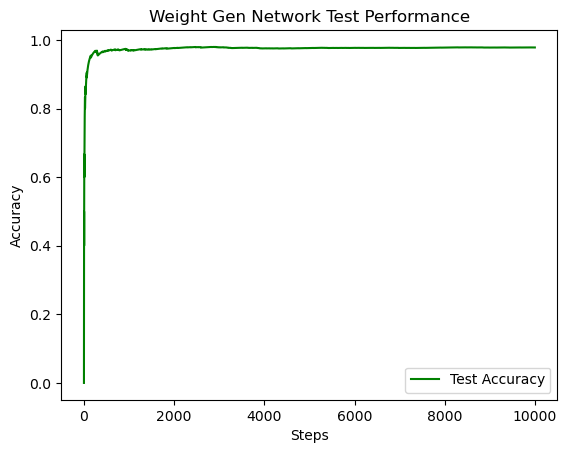

In [16]:
plt.plot(test_accs, 'g', label='Test Accuracy')
plt.title('Weight Gen Network Test Performance')
plt.xlabel('Steps')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [17]:
# Compute the Fisher Information for each parameter in Task A
print('Processing Fisher Information...')
I = ecomputer_fisher_full(WGN, x_train.reshape(60000, 1, 784))
print('Processing Finish!')

Processing Fisher Information...
Processing Finish!


/tmp/ipykernel_29897/3188200143.py:80: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  f_accum = np.asarray(f_accum)/len(imgset)


In [18]:
with open('EWGNcc_MnistA_Fisher.npy', 'wb') as f:
    np.save(f, I)

In [19]:
print(I)

[<tf.Tensor: shape=(784, 128), dtype=float32, numpy=
 array([[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)>
 <tf.Tensor: shape=(128,), dtype=float32, numpy=
 array([ 5794.002 , 12919.599 , 14029.14  , 12033.499 ,  3353.7307,
         2458.7322, 12859.389 ,  4455.5957,  6256.2197,  5495.092 ,
         3834.1238, 18758.084 ,  1590.0466,  7898.76  , 11366.441 ,
        14945.356 , 11863.593 , 12178.274 ,  3839.6592, 10859.664 ,
         5480.5474, 12691.572 ,  5400.1494, 11323.348 ,  5498.8735,
         6320.8164,  5927.2114,  2688.5354,  6515.171 , 12876.644 ,
        11463.82  ,  4104.8374,  8260.187 ,  3797.3052, 10052.315 ,
         2099.0574, 10497.973 , 11799.868 ,  2010.4716, 15098.55  ,
         1849.5858,  6401.9604, 10566.474 ,  7301.2954,  6982.395 ,
         5978.2026, 11

In [20]:
"""
ewc_strength = 0.0001

kreg = ewc_reg(I[0], WGN.weights[0], Lambda = ewc_strength)
print(kreg(x=WGN_ewcB.weights[0]))
breg = ewc_reg(I[1], WGN.weights[1], Lambda = ewc_strength)
print(kreg(x=WGN_ewcB.weights[1]))

kreg = ewc_reg(I[2], WGN.weights[2], Lambda = ewc_strength)
print(kreg(x=WGN_ewcB.weights[2]))
breg = ewc_reg(I[3], WGN.weights[3], Lambda = ewc_strength)
print(kreg(x=WGN_ewcB.weights[3]))

"""
"""
tf.Tensor(235.743, shape=(), dtype=float32)
tf.Tensor(2993.8042, shape=(), dtype=float32)
tf.Tensor(19218.791, shape=(), dtype=float32)
tf.Tensor(67722.83, shape=(), dtype=float32)
"""

'\ntf.Tensor(235.743, shape=(), dtype=float32)\ntf.Tensor(2993.8042, shape=(), dtype=float32)\ntf.Tensor(19218.791, shape=(), dtype=float32)\ntf.Tensor(67722.83, shape=(), dtype=float32)\n'

In [21]:
# Task B penalty training
ewc_strength = 0.1
# WGN that generates the weights of the `main_network.
WGN_ewcB = keras.Sequential(
    [
        keras.layers.Dense(128, activation=tf.nn.gelu, kernel_regularizer=ewc_reg(I[0], WGN.weights[0], Lambda = ewc_strength),
                 bias_regularizer=ewc_reg(I[1], WGN.weights[1], Lambda = ewc_strength)),
        keras.layers.Dense(num_weights_to_generate, activation=gaussian_activation, kernel_regularizer=ewc_reg(I[2], WGN.weights[2], Lambda = ewc_strength),
                 bias_regularizer=ewc_reg(I[3], WGN.weights[3], Lambda = ewc_strength)),
    ]
)

In [22]:
WGN_ewcB(x_train1[0].reshape(1,784))
WGN_ewcB.load_weights('EWGNcc_MnistA.h5')

In [23]:
WGN_ewcB.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (1, 128)                  100480    
_________________________________________________________________
dense_5 (Dense)              (1, 103060)               13294740  
Total params: 13,395,220
Trainable params: 13,395,220
Non-trainable params: 0
_________________________________________________________________


In [24]:

#evaluate on testdata
test_accs = []
test_losses = []
for tstep, (xt, yt) in enumerate(test_dataset):
    test_loss, test_acc, preds, _, _ = test_step(xt, yt, WGN_ewcB)
    test_accs.append(test_acc)
tstacc_fn.reset_states()



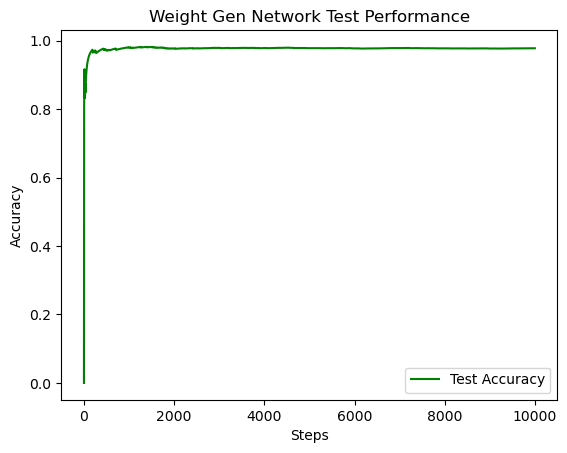

In [25]:

plt.plot(test_accs, 'g', label='Test Accuracy')
plt.title('Weight Gen Network Test Performance')
plt.xlabel('Steps')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


In [26]:
#evaluate on testdata
test_accs1 = []
test_losses1 = []
for tstep, (xt, yt) in enumerate(test_dataset1):
    test_loss, test_acc, preds, _, _ = test_step(xt, yt, WGN_ewcB)
    test_accs1.append(test_acc)
tstacc_fn.reset_states()

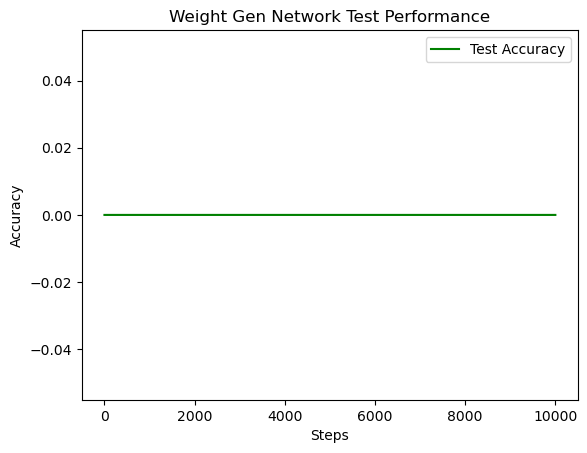

In [27]:
plt.plot(test_accs1, 'g', label='Test Accuracy')
plt.title('Weight Gen Network Test Performance')
plt.xlabel('Steps')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [28]:
def ewc_loss(model, fisher_information, old_weights, lambda_ewc=0.1):
    ewc_loss_value = 0.0
    for i, weight in enumerate(model.trainable_weights):
        fisher_info = fisher_information[i]
        old_weight = old_weights[i]
        ewc_loss_value += tf.reduce_sum(fisher_info * tf.square(weight - old_weight))
    return lambda_ewc * ewc_loss_value

In [29]:
#@tf.function
def train_step_ewc(x, y, WGNc, step, ada = 1):
    with tf.GradientTape() as tape:
        if step == 0:
            weights_init = tf.random.uniform((1,num_weights_to_generate))
            # Reshape them to the expected shapes for w and b for the outer model.
            # Layer 0 kernel.
            start_index = 0
            w0_shape = (input_dim, 128)
            w0_coeffs = weights_init[:, start_index : start_index + np.prod(w0_shape)]
            w0 = tf.reshape(w0_coeffs, w0_shape)
            start_index += np.prod(w0_shape)
            # Layer 0 bias.
            b0_shape = (128,)
            b0_coeffs = weights_init[:, start_index : start_index + np.prod(b0_shape)]
            b0 = tf.reshape(b0_coeffs, b0_shape)
            start_index += np.prod(b0_shape)
            # Layer 1 kernel.
            w1_shape = (128, classes)
            w1_coeffs = weights_init[:, start_index : start_index + np.prod(w1_shape)]
            w1 = tf.reshape(w1_coeffs, w1_shape)
            start_index += np.prod(w1_shape)
            # Layer 1 bias.
            b1_shape = (classes,)
            b1_coeffs = weights_init[:, start_index : start_index + np.prod(b1_shape)]
            b1 = tf.reshape(b1_coeffs, b1_shape)
            start_index += np.prod(b1_shape)

            main_network.layers[0].kernel = w0
            main_network.layers[0].bias = b0
            main_network.layers[1].kernel = w1
            main_network.layers[1].bias = b1
        
        # Predict weights for the outer model.
        weights_pred = WGNc(x)

        # Reshape them to the expected shapes for w and b for the outer model.
        # Layer 0 kernel.
        start_index = 0
        w0_shape = (input_dim, 128)
        w0_coeffs = weights_pred[:, start_index : start_index + np.prod(w0_shape)]
        w0 = tf.reshape(w0_coeffs, w0_shape)
        start_index += np.prod(w0_shape)
        # Layer 0 bias.
        b0_shape = (128,)
        b0_coeffs = weights_pred[:, start_index : start_index + np.prod(b0_shape)]
        b0 = tf.reshape(b0_coeffs, b0_shape)
        start_index += np.prod(b0_shape)
        # Layer 1 kernel.
        w1_shape = (128, classes)
        w1_coeffs = weights_pred[:, start_index : start_index + np.prod(w1_shape)]
        w1 = tf.reshape(w1_coeffs, w1_shape)
        start_index += np.prod(w1_shape)
        # Layer 1 bias.
        b1_shape = (classes,)
        b1_coeffs = weights_pred[:, start_index : start_index + np.prod(b1_shape)]
        b1 = tf.reshape(b1_coeffs, b1_shape)
        start_index += np.prod(b1_shape)

        
        # Set the weight predictions as the weight variables on the outer model.
        main_network.layers[0].kernel = (1-ada)*main_network.layers[0].kernel + ada*w0
        main_network.layers[0].bias = (1-ada)*main_network.layers[0].bias + ada*b0
        main_network.layers[1].kernel = (1-ada)*main_network.layers[1].kernel + ada*w1
        main_network.layers[1].bias = (1-ada)*main_network.layers[1].bias + ada*b1
        
        # Inference on the outer model.
        preds = main_network(x)
        ploss = loss_fn(y, preds)
        eloss = ewc_loss(WGNc, I, WGN.trainable_weights, lambda_ewc=0.1)
        total_loss = ploss + eloss

    # update accuracy.
    acc_fn.update_state(y, preds)
    train_acc = acc_fn.result()
    # Train only inner model.    
    grads = tape.gradient(total_loss, WGNc.trainable_weights)
    optimizer.apply_gradients(zip(grads, WGNc.trainable_weights))
    return ploss, eloss, total_loss, train_acc

In [30]:
#optimizer = tf.keras.optimizers.Adam(learning_rate= 0.00025, decay = 0.95)
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)

plosses = []  # Keep track of the losses over time.
elosses = []
tlosses = []
train_accs = []
test_accs = []
test_accs1 = []

#main_network.compile(loss=loss_fn, optimizer=optimizer, metrics=acc_fn)
epochs = 10
for i in range(epochs):
    for step, (x, y) in enumerate(train_dataset1):
        ploss, eloss, tloss, train_acc = train_step_ewc(x, y, WGN_ewcB, step)
    
        # Logging.
        plosses.append(float(ploss))
        elosses.append(float(eloss))
        tlosses.append(float(tloss))
        train_accs.append(train_acc)

        if step%10000 == 0:
            print("Epochs:", i, "Step in progress:", step)
    
    acc_fn.reset_states()

    #evaluate on testdata
    for tstep, (xt, yt) in enumerate(test_dataset1):
        test_loss, test_acc, preds, _, _ = test_step(xt, yt, WGN_ewcB)
        test_accs1.append(test_acc)
    tstacc_fn.reset_states()
    
    print("Epochs:", i, "Step:", step, "Train Loss:", sum(tlosses) / len(tlosses), "Train Acc:", train_acc, "Test Acc:", test_acc)
    #evaluate on testdata
    for tstep, (xt, yt) in enumerate(test_dataset):
        test_loss, test_acc, preds, _, _ = test_step(xt, yt, WGN_ewcB)
        test_accs.append(test_acc)
    tstacc_fn.reset_states()
    
    print("Epochs:", i, "Step:", step, "Train Loss:", sum(tlosses) / len(tlosses), "Train Acc:", train_acc, "Test Acc:", test_acc)
   

Epochs: 0 Step in progress: 0
Epochs: 0 Step in progress: 10000
Epochs: 0 Step in progress: 20000
Epochs: 0 Step in progress: 30000
Epochs: 0 Step in progress: 40000
Epochs: 0 Step in progress: 50000
Epochs: 0 Step: 59999 Train Loss: 8.184190287673474 Train Acc: tf.Tensor(0.43391666, shape=(), dtype=float32) Test Acc: tf.Tensor(0.5866, shape=(), dtype=float32)
Epochs: 0 Step: 59999 Train Loss: 8.184190287673474 Train Acc: tf.Tensor(0.43391666, shape=(), dtype=float32) Test Acc: tf.Tensor(0.9766, shape=(), dtype=float32)
Epochs: 1 Step in progress: 0
Epochs: 1 Step in progress: 10000
Epochs: 1 Step in progress: 20000
Epochs: 1 Step in progress: 30000
Epochs: 1 Step in progress: 40000
Epochs: 1 Step in progress: 50000
Epochs: 1 Step: 59999 Train Loss: 6.176629157245159 Train Acc: tf.Tensor(0.6202667, shape=(), dtype=float32) Test Acc: tf.Tensor(0.6322, shape=(), dtype=float32)
Epochs: 1 Step: 59999 Train Loss: 6.176629157245159 Train Acc: tf.Tensor(0.6202667, shape=(), dtype=float32) Tes

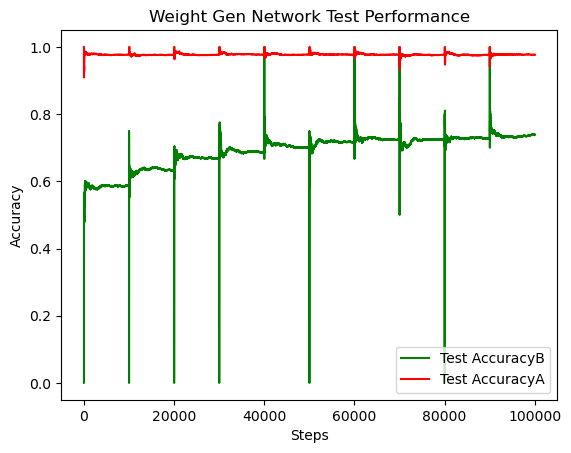

In [31]:
plt.plot(test_accs1, 'g', label='Test AccuracyB')
plt.plot(test_accs, 'r', label='Test AccuracyA')
plt.title('Weight Gen Network Test Performance')
plt.xlabel('Steps')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [32]:
#savemodel
plosses = np.cumsum(np.asarray(plosses))/range(1,len(plosses)+1)
elosses = np.cumsum(np.asarray(elosses))/range(1,len(elosses)+1)
tlosses = np.cumsum(np.asarray(tlosses))/range(1,len(tlosses)+1)

WGN_ewcB.save("EWGNcc_FMnistB.h5")
with open('EWGNcc_FMnistB_plosses.npy', 'wb') as f:
    np.save(f, plosses)
with open('EWGNcc_FMnistB_elosses.npy', 'wb') as f:
    np.save(f, elosses)
with open('EWGNcc_FMnistB_tlosses.npy', 'wb') as f:
    np.save(f, tlosses)
    
with open('EWGNcc_FMnistB_tracc.npy', 'wb') as f:
    np.save(f, np.array(train_accs))
with open('EWGNcc_FMnistB_tstacc.npy', 'wb') as f:
    np.save(f, np.array(test_accs))
with open('EWGNcc_FMnistB_tstacc1.npy', 'wb') as f:
    np.save(f, np.array(test_accs1))

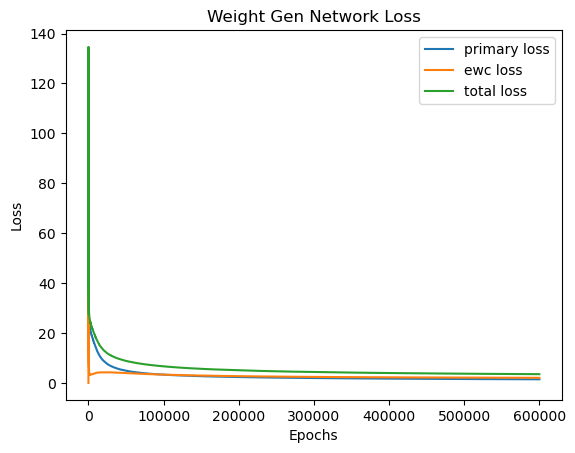

In [33]:
import matplotlib.pyplot as plt

plt.plot(plosses, label='primary loss')
plt.plot(elosses, label='ewc loss')
plt.plot(tlosses, label='total loss')
plt.title('Weight Gen Network Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [326]:
# Task B no penalty training
# WGN that generates the weights of the `main_network.
WGN_NoP_B = keras.Sequential(
    [
        keras.layers.Dense(128, activation=tf.nn.gelu),
        keras.layers.Dense(num_weights_to_generate, activation=gaussian_activation),
    ]
)

In [327]:
WGN_NoP_B(x_train1[0].reshape(1,784))
WGN_NoP_B.load_weights('EWGNcc_MnistA.h5')

losses = []  # Keep track of the losses over time.
train_accs = []
test_accs = []
test_accs1 = []

#main_network.compile(loss=loss_fn, optimizer=optimizer, metrics=acc_fn)
epochs = 10
for i in range(epochs):
    for step, (x, y) in enumerate(train_dataset1):
        loss, train_acc = train_step(x, y, WGN_NoP_B, step)
    
        # Logging.
        losses.append(float(loss))
        train_accs.append(train_acc)

        if step%10000 == 0:
            print("Epochs:", i, "Step in progress:", step)
    
    acc_fn.reset_states()

    #evaluate on testdata
    for tstep, (xt, yt) in enumerate(test_dataset1):
        test_loss, test_acc, preds, _, _ = test_step(xt, yt, WGN_NoP_B)
        test_accs1.append(test_acc)
    tstacc_fn.reset_states()
    
    print("Epochs:", i, "Step:", step, "Train Loss:", sum(losses) / len(losses), "Train Acc:", train_acc, "Test Acc:", test_acc)
    #evaluate on testdata
    for tstep, (xt, yt) in enumerate(test_dataset):
        test_loss, test_acc, preds, _, _ = test_step(xt, yt, WGN_NoP_B)
        test_accs.append(test_acc)
    tstacc_fn.reset_states()
    
    print("Epochs:", i, "Step:", step, "Train Loss:", sum(losses) / len(losses), "Train Acc:", train_acc, "Test Acc:", test_acc)
   

Epochs: 0 Step in progress: 0
Epochs: 0 Step in progress: 10000
Epochs: 0 Step in progress: 20000
Epochs: 0 Step in progress: 30000
Epochs: 0 Step in progress: 40000
Epochs: 0 Step in progress: 50000
Epochs: 0 Step: 59999 Train Loss: 1.0421758849363456 Train Acc: tf.Tensor(0.78462833, shape=(), dtype=float32) Test Acc: tf.Tensor(0.9399, shape=(), dtype=float32)
Epochs: 0 Step: 59999 Train Loss: 1.0421758849363456 Train Acc: tf.Tensor(0.78462833, shape=(), dtype=float32) Test Acc: tf.Tensor(0.002, shape=(), dtype=float32)
Epochs: 1 Step in progress: 0
Epochs: 1 Step in progress: 10000
Epochs: 1 Step in progress: 20000
Epochs: 1 Step in progress: 30000
Epochs: 1 Step in progress: 40000
Epochs: 1 Step in progress: 50000
Epochs: 1 Step: 59999 Train Loss: 0.6012232149961731 Train Acc: tf.Tensor(0.95213336, shape=(), dtype=float32) Test Acc: tf.Tensor(0.9581, shape=(), dtype=float32)
Epochs: 1 Step: 59999 Train Loss: 0.6012232149961731 Train Acc: tf.Tensor(0.95213336, shape=(), dtype=float32

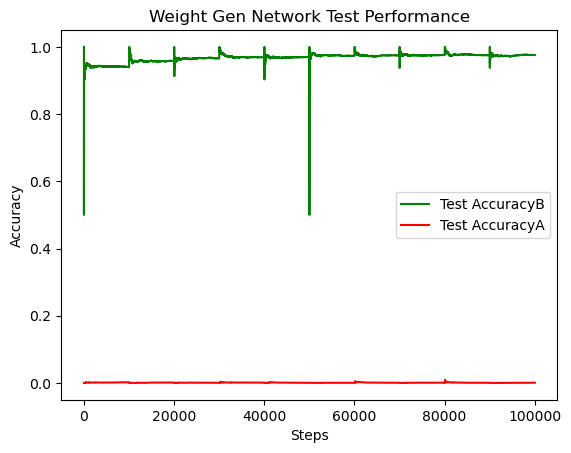

In [328]:
plt.plot(test_accs1, 'g', label='Test AccuracyB')
plt.plot(test_accs, 'r', label='Test AccuracyA')
plt.title('Weight Gen Network Test Performance')
plt.xlabel('Steps')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [329]:
#savemodel
losses = np.cumsum(np.asarray(losses))/range(1,len(losses)+1)
WGN_NoP_B.save("EWGNcc_FMnistNoB.h5")
with open('EWGNcc_FMnistNoB_losses.npy', 'wb') as f:
    np.save(f, losses)
    
with open('EWGNcc_FMnistNoB_tracc.npy', 'wb') as f:
    np.save(f, np.array(train_accs))
with open('EWGNcc_FMnistNoB_tstacc.npy', 'wb') as f:
    np.save(f, np.array(test_accs))
with open('EWGNcc_FMnistNoB_tstacc1.npy', 'wb') as f:
    np.save(f, np.array(test_accs1))

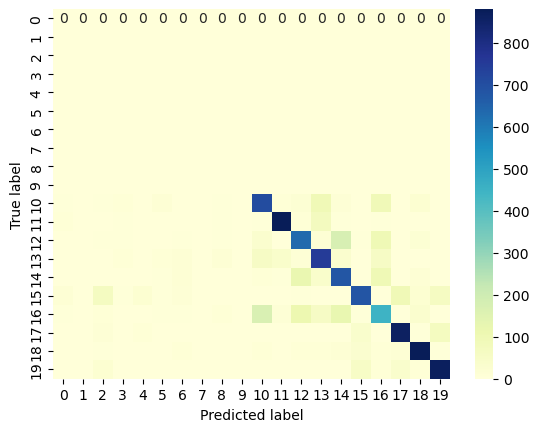

In [38]:
import pandas as pd
import seaborn as sns
from sklearn.metrics import accuracy_score, confusion_matrix

#Current Task B Perfomrance Evals
dataset = test_dataset1
preds = []
weight_preds = []
lyrpreds = []
y_test_true = []
x_test_true = []

for tstep, (xt, yt) in enumerate(dataset):
    x_test_true.append(xt)
    y_test_true.append(yt)
    _, _, pred, lyr, weight_pred = test_step(xt, yt, WGN_ewcB)
    preds.append(pred)
    weight_preds.append(weight_pred)
    lyrpreds.append(lyr)
tstacc_fn.reset_states()

y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
B_EWC = accuracy_score(y_test_arg, y_pred )

#confusionmat
cm = confusion_matrix(y_test_arg, y_pred)

plt.figure()
sns.heatmap(cm, fmt = 'd' , cmap="YlGnBu",  annot=True)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()



In [39]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

avg = None

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "micro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\n\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "macro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "weighted"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)


Averging =  None 
accuracy =  0.7393 
precision =  [0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.7148635  0.93220339
 0.69484083 0.72211538 0.6500956  0.84029484 0.55377009 0.85262117
 0.86857708 0.85700197] 
recall =  [0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.707 0.88
 0.633 0.751 0.68  0.684 0.448 0.862 0.879 0.869] 
f1 score =  [0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.71091001 0.90534979
 0.66248038 0.73627451 0.66471163 0.75413451 0.49530127 0.85728493
 0.87375746 0.86295929]

classwise metrics =  (array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.7148635 , 0.93220339, 0.69484083, 0.72211538, 0.6500956 ,
       0.84029484, 0.55377009, 0.85262117, 0.86857708, 0.85700197]), array([0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   ,
     

/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9

<Axes: >

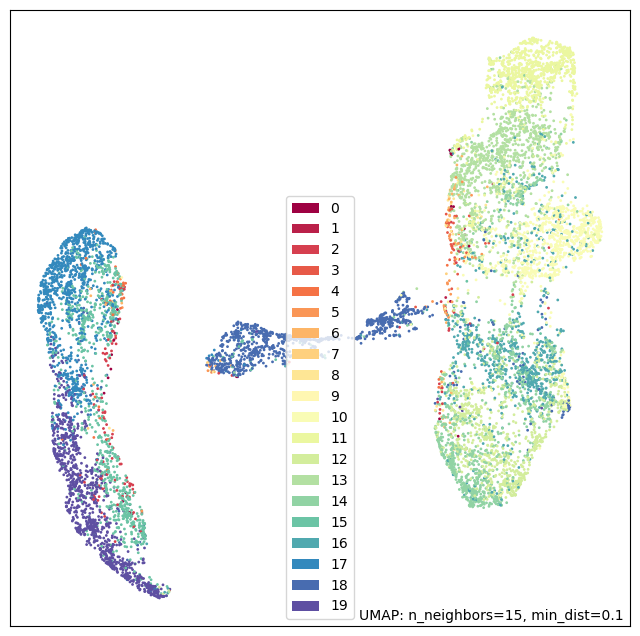

In [40]:
import umap
import umap.plot

sz=10000

imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

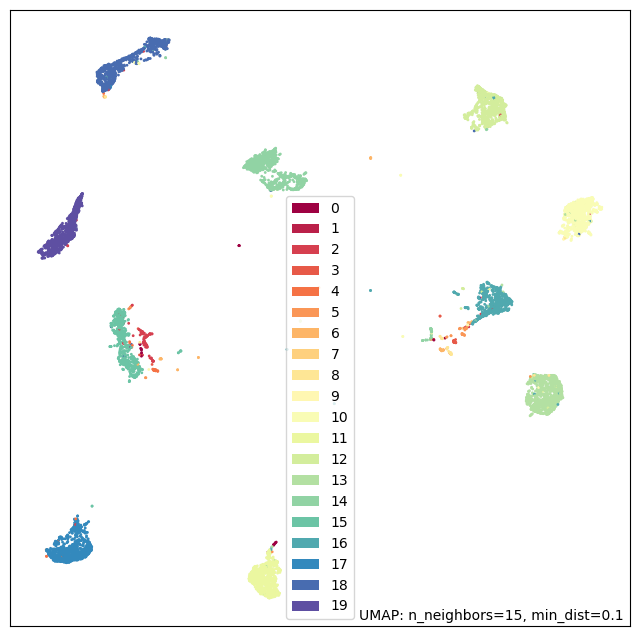

In [41]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

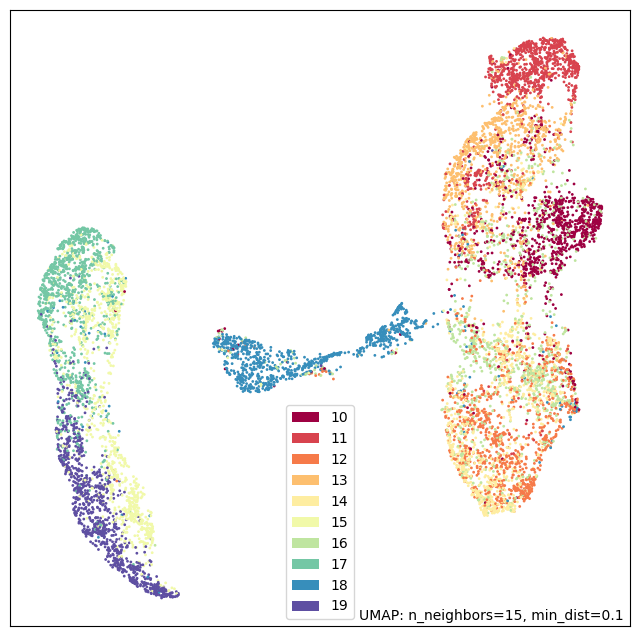

In [42]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

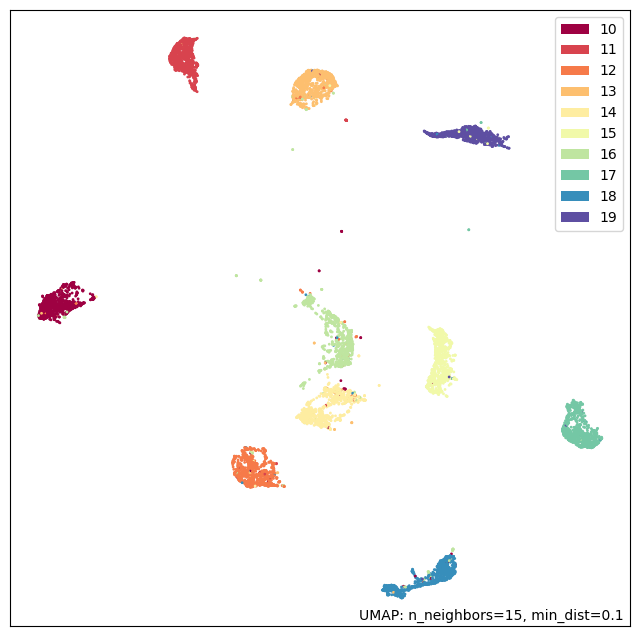

In [43]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

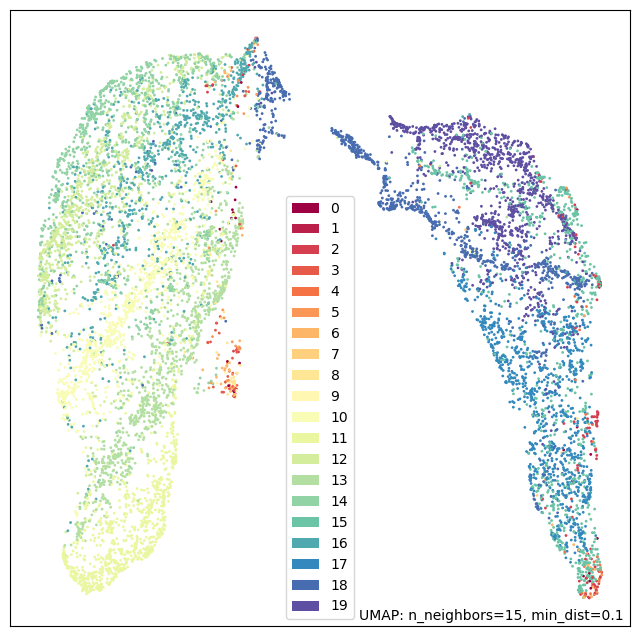

In [44]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

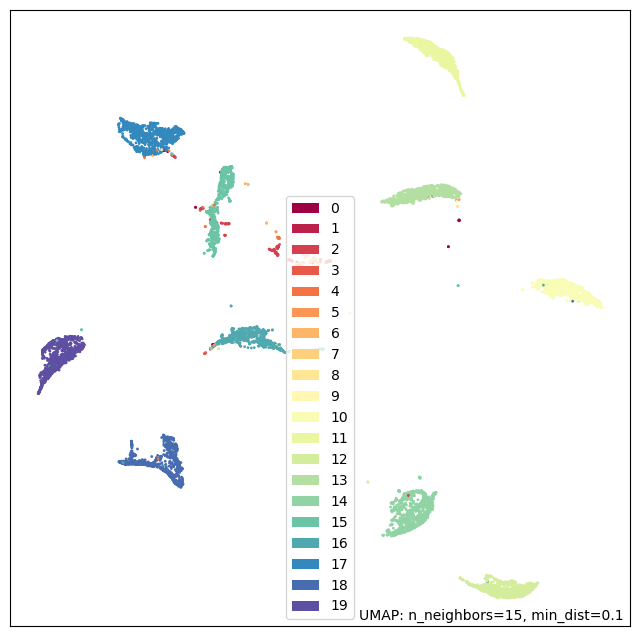

In [45]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

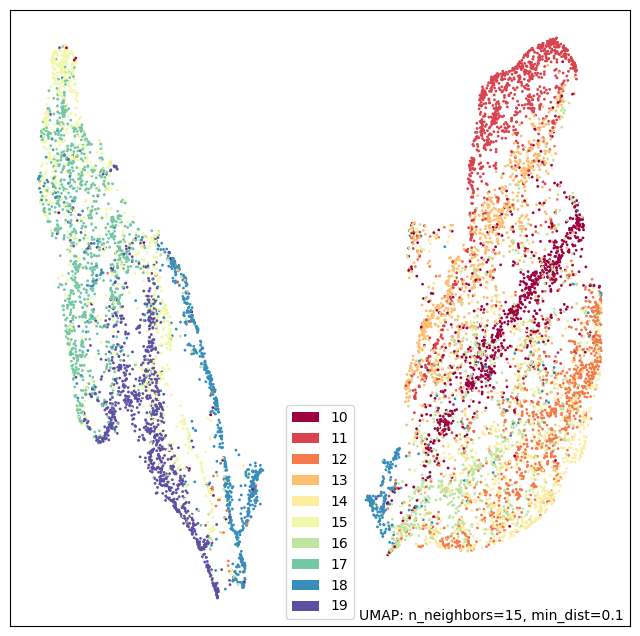

In [46]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

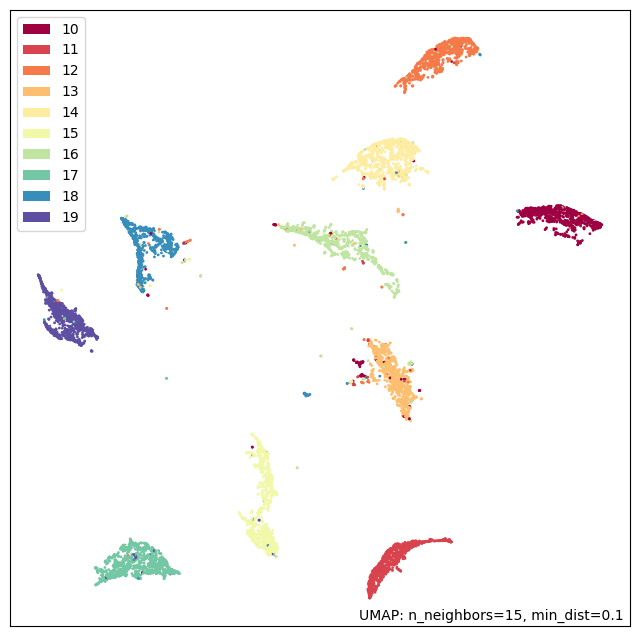

In [47]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

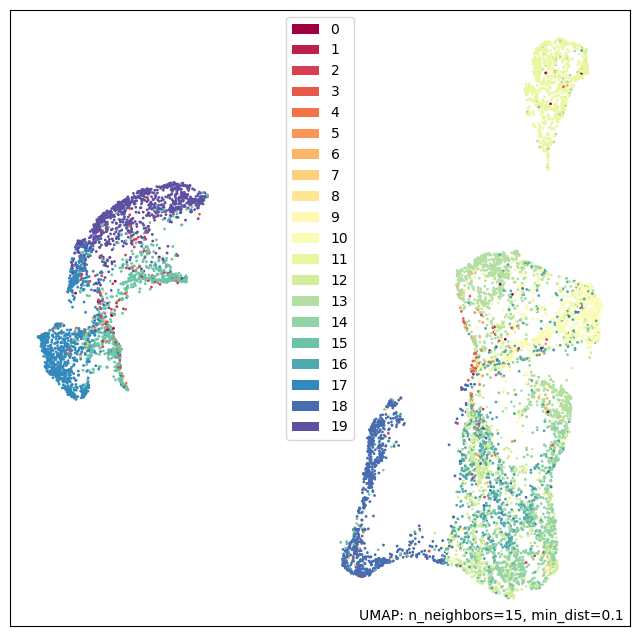

In [48]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

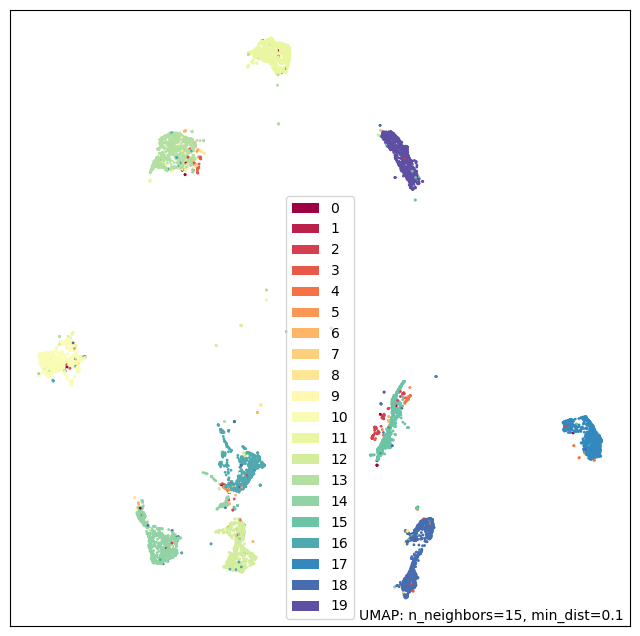

In [49]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

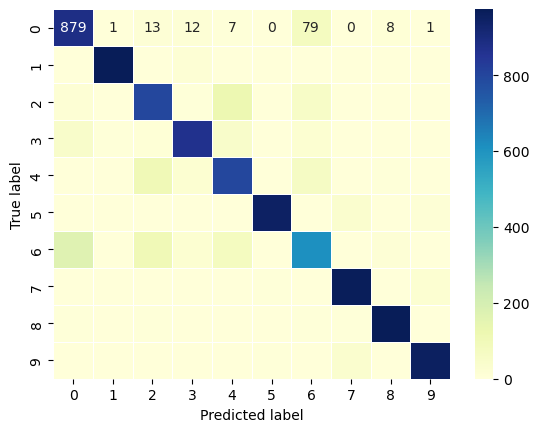

In [50]:
#Current Task B Perfomrance Evals
#Current Task B Perfomrance Evals
dataset = test_dataset1
preds = []
weight_preds = []
lyrpreds = []
y_test_true = []
x_test_true = []

for tstep, (xt, yt) in enumerate(dataset):
    x_test_true.append(xt)
    y_test_true.append(yt)
    _, _, pred, lyr, weight_pred = test_step(xt, yt, WGN_NoP_B)
    preds.append(pred)
    weight_preds.append(weight_pred)
    lyrpreds.append(lyr)
tstacc_fn.reset_states()

y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
B_No_P = accuracy_score(y_test_arg, y_pred )

#confusionmat
cm = confusion_matrix(y_test_arg, y_pred)

plt.figure()
sns.heatmap(cm, fmt = 'd' , cmap="YlGnBu",  annot=True, linewidths=.5)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

In [51]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

avg = None

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "micro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\n\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "macro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "weighted"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)


Averging =  None 
accuracy =  0.8765 
precision =  [0.78272484 0.99286442 0.77176015 0.9066107  0.75593542 0.98340249
 0.72071006 0.92891451 0.96626984 0.95791583] 
recall =  [0.879 0.974 0.798 0.864 0.796 0.948 0.609 0.967 0.974 0.956] 
f1 score =  [0.82807348 0.98334175 0.78466077 0.88479263 0.77545056 0.96537678
 0.6601626  0.94757472 0.97011952 0.95695696]

classwise metrics =  (array([0.78272484, 0.99286442, 0.77176015, 0.9066107 , 0.75593542,
       0.98340249, 0.72071006, 0.92891451, 0.96626984, 0.95791583]), array([0.879, 0.974, 0.798, 0.864, 0.796, 0.948, 0.609, 0.967, 0.974,
       0.956]), array([0.82807348, 0.98334175, 0.78466077, 0.88479263, 0.77545056,
       0.96537678, 0.6601626 , 0.94757472, 0.97011952, 0.95695696]), array([1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000]))

Averging =  micro 

accuracy =  0.8765 
precision =  0.8765 
recall =  0.8765 
f1 score =  0.8765

classwise metrics =  (0.8765, 0.8765, 0.8765, None)

Averging =  macro 
accuracy =  0.

<Axes: >

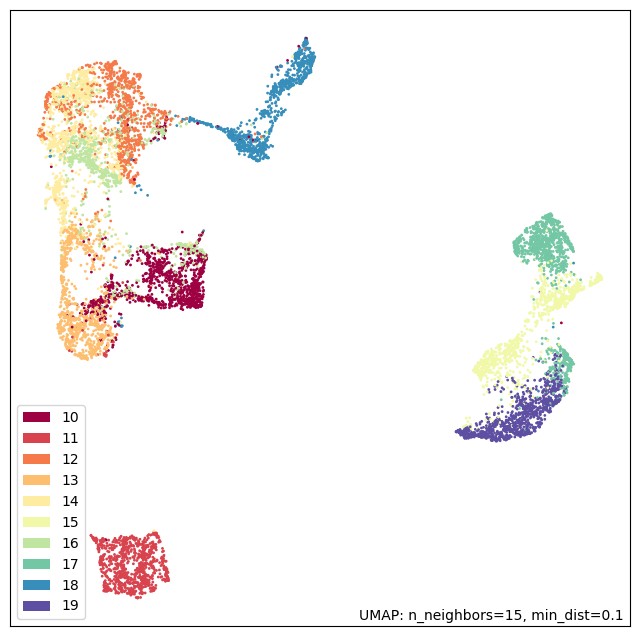

In [52]:
import umap
import umap.plot

sz=10000

imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

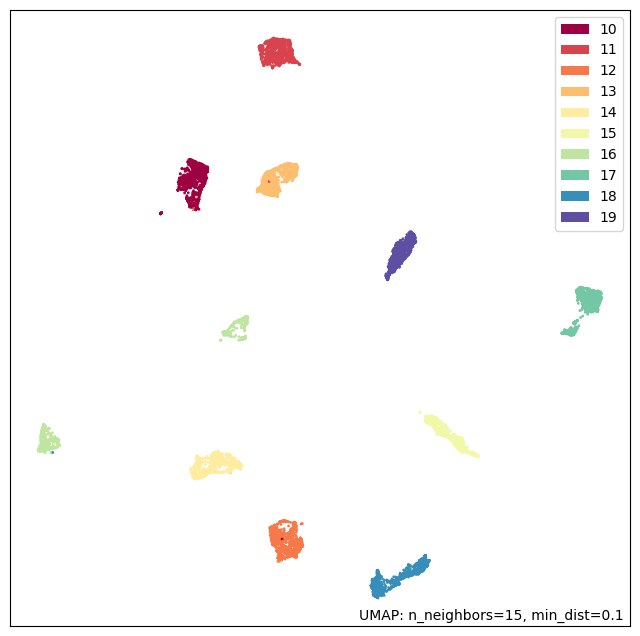

In [53]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

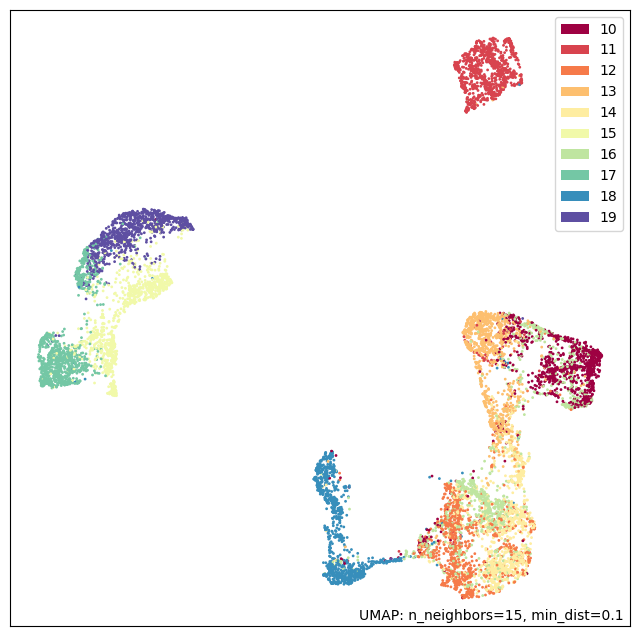

In [54]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

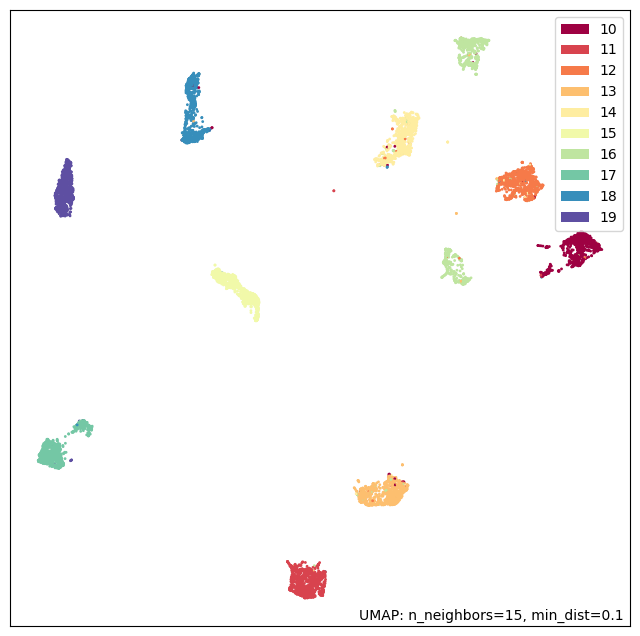

In [55]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

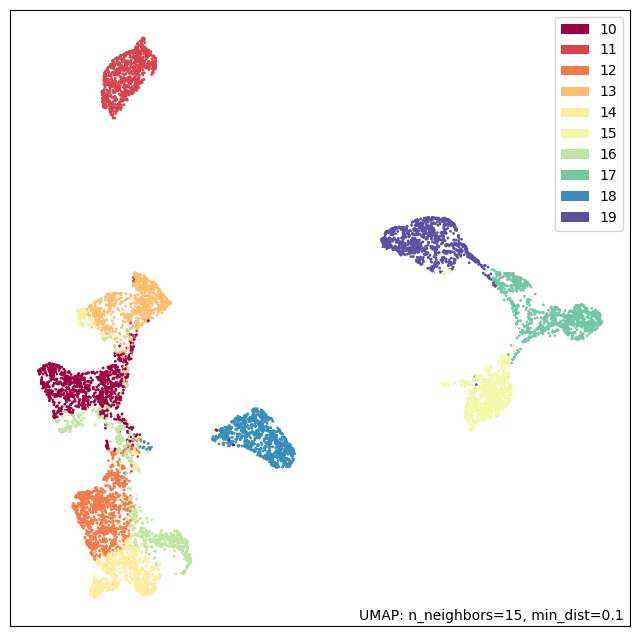

In [56]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

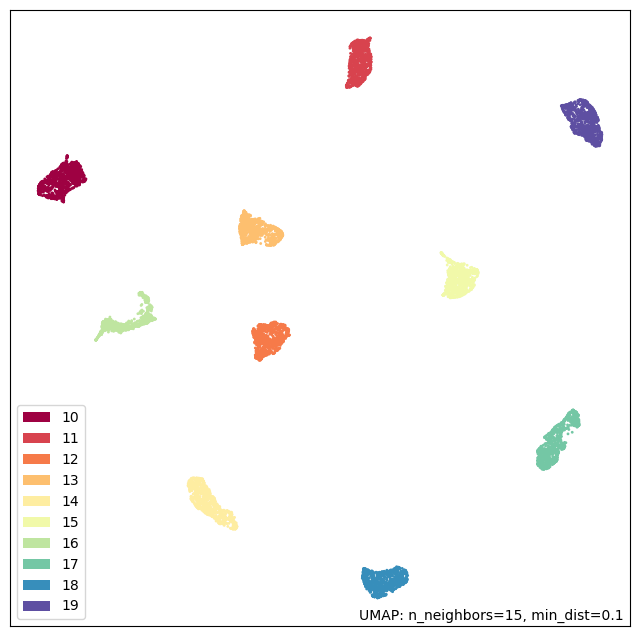

In [57]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

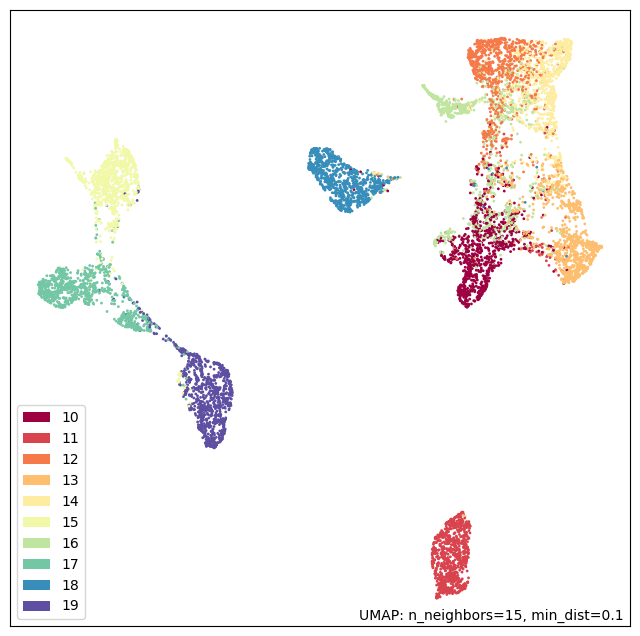

In [58]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

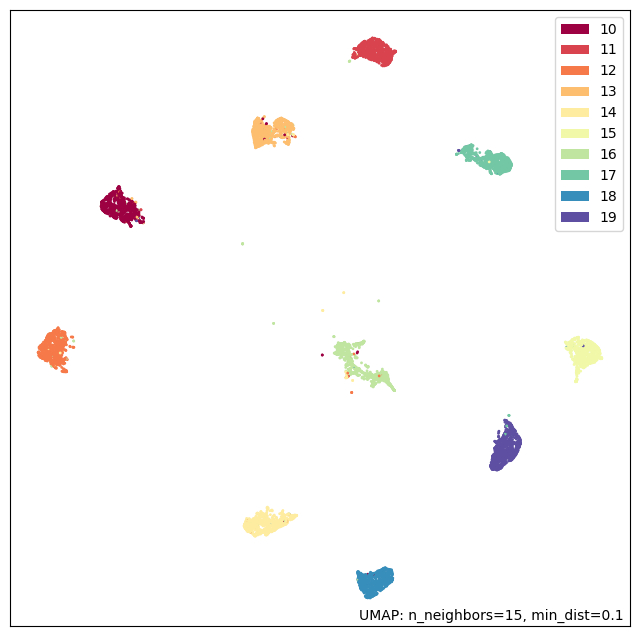

In [59]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

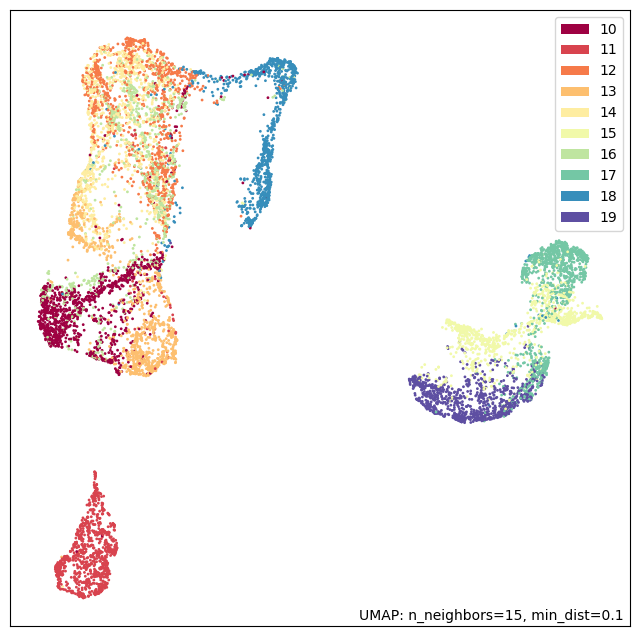

In [60]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

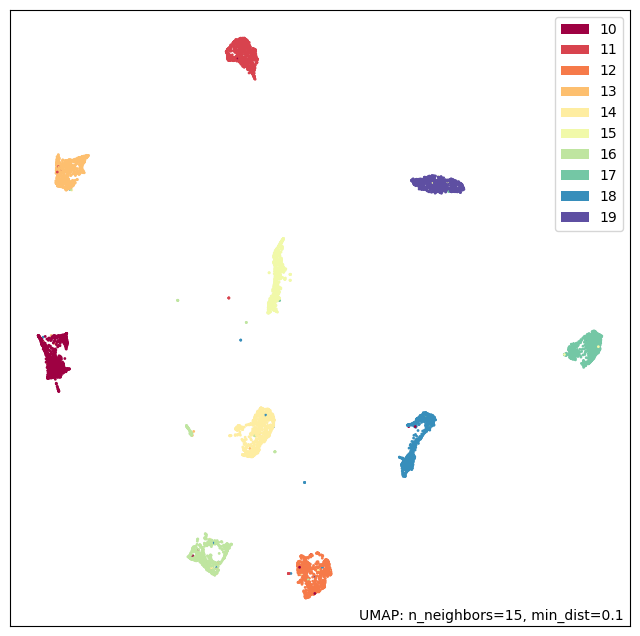

In [61]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

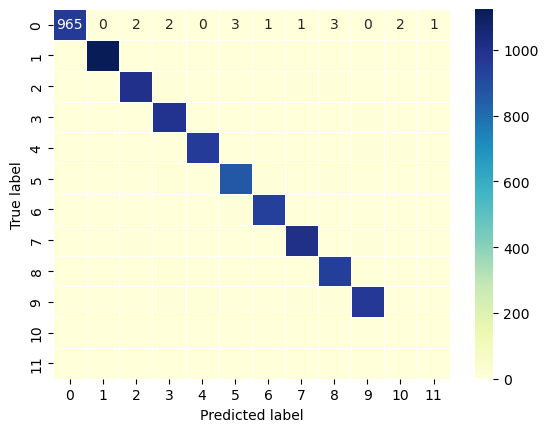

In [62]:
#Previous Task A Perfomrance Evals

dataset = test_dataset
preds = []
weight_preds = []
lyrpreds = []
y_test_true = []
x_test_true = []

for tstep, (xt, yt) in enumerate(dataset):
    x_test_true.append(xt)
    y_test_true.append(yt)
    _, _, pred, lyr, weight_pred = test_step(xt, yt, WGN_ewcB)
    preds.append(pred)
    weight_preds.append(weight_pred)
    lyrpreds.append(lyr)
tstacc_fn.reset_states()

y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
A_EWC = accuracy_score(y_test_arg, y_pred )

#confusionmat
y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
cm = confusion_matrix(y_test_arg, y_pred)

plt.figure()
sns.heatmap(cm, fmt = 'd' , cmap="YlGnBu",  annot=True, linewidths=.5)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

In [63]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

avg = None

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "micro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\n\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "macro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "weighted"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)


Averging =  None 
accuracy =  0.9767 
precision =  [0.98974359 0.99293286 0.97762646 0.95761079 0.97850563 0.9784336
 0.9822732  0.97483059 0.96724667 0.97479839 0.         0.        ] 
recall =  [0.98469388 0.99030837 0.97383721 0.98415842 0.97352342 0.96636771
 0.98329854 0.97957198 0.97022587 0.95837463 0.         0.        ] 
f1 score =  [0.98721228 0.99161888 0.97572816 0.97070312 0.97600817 0.97236323
 0.9827856  0.97719554 0.96873398 0.96651674 0.         0.        ]

classwise metrics =  (array([0.98974359, 0.99293286, 0.97762646, 0.95761079, 0.97850563,
       0.9784336 , 0.9822732 , 0.97483059, 0.96724667, 0.97479839,
       0.        , 0.        ]), array([0.98469388, 0.99030837, 0.97383721, 0.98415842, 0.97352342,
       0.96636771, 0.98329854, 0.97957198, 0.97022587, 0.95837463,
       0.        , 0.        ]), array([0.98721228, 0.99161888, 0.97572816, 0.97070312, 0.97600817,
       0.97236323, 0.9827856 , 0.97719554, 0.96873398, 0.96651674,
       0.        , 0.        

/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9

<Axes: >

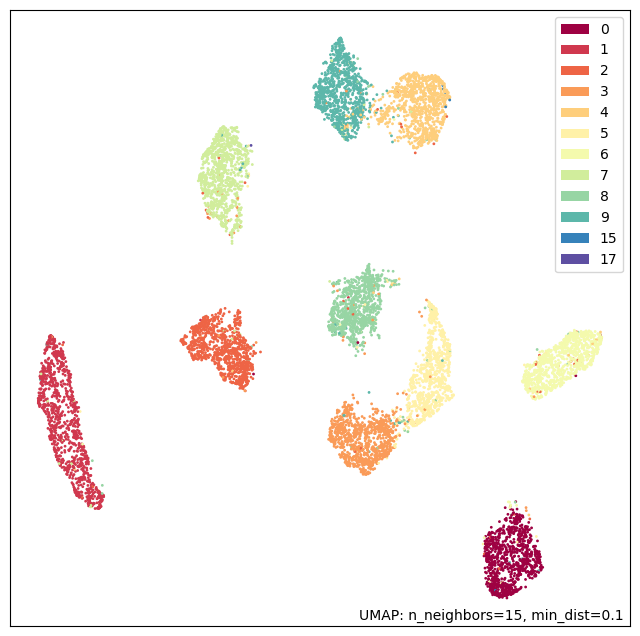

In [64]:
import umap
import umap.plot

sz=10000

imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

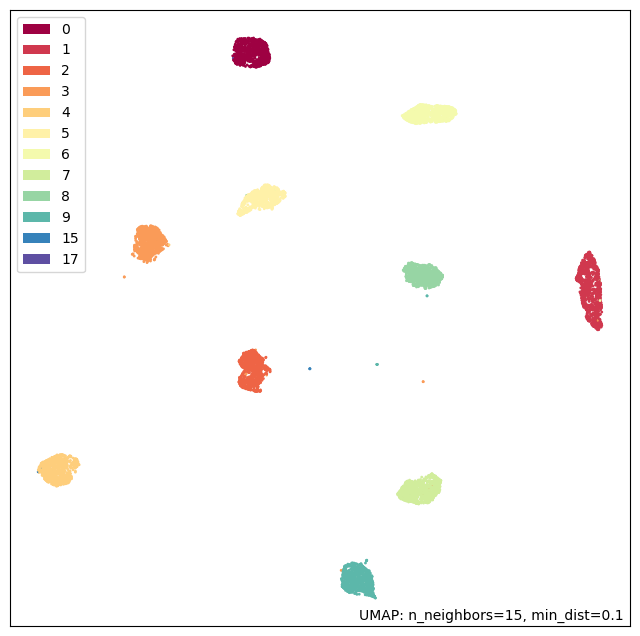

In [65]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

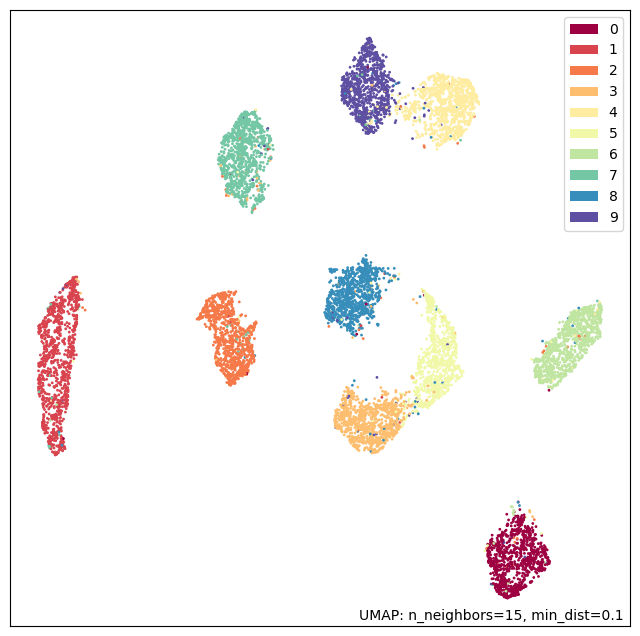

In [66]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

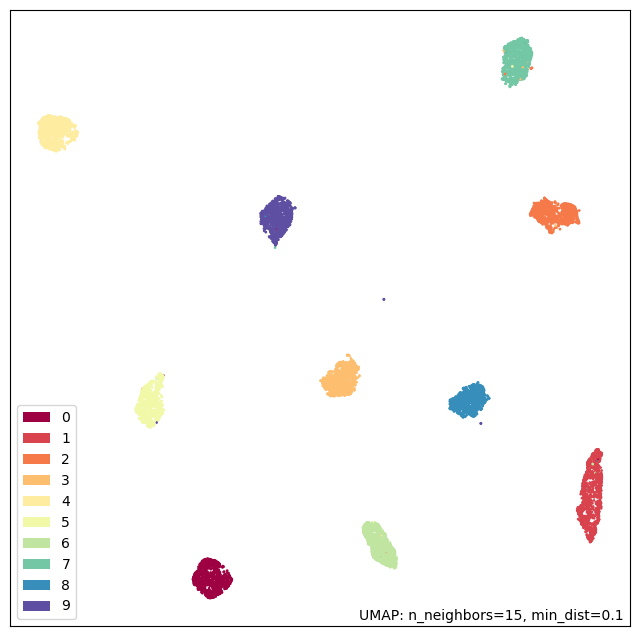

In [67]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

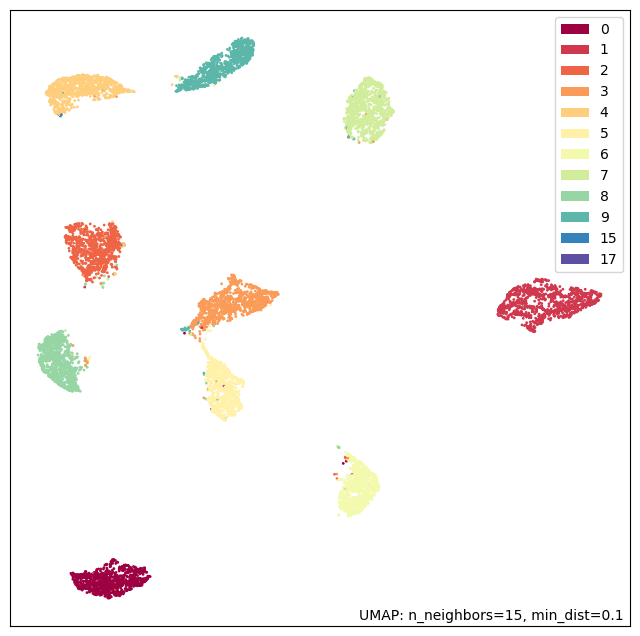

In [68]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

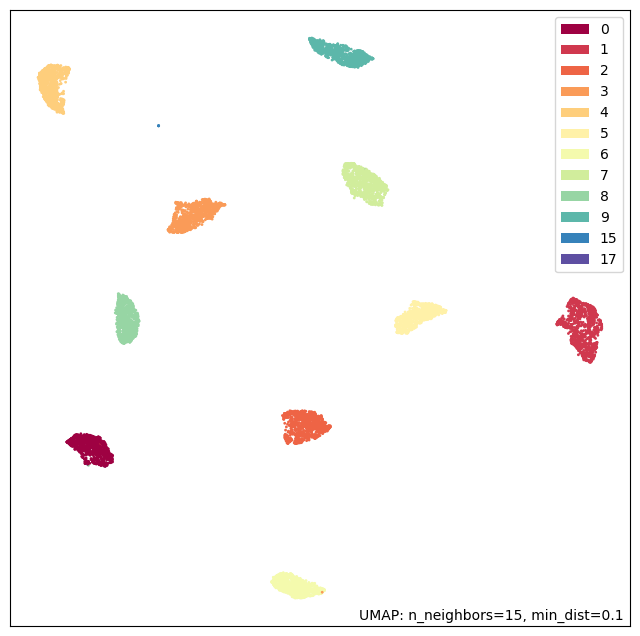

In [69]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

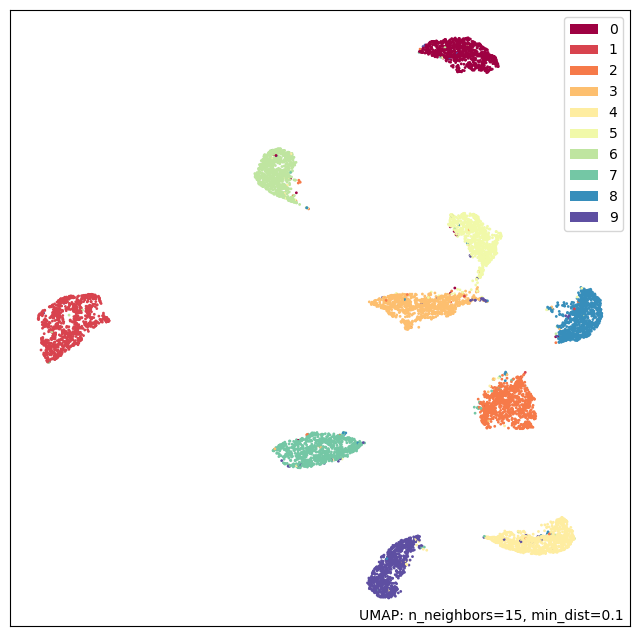

In [70]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

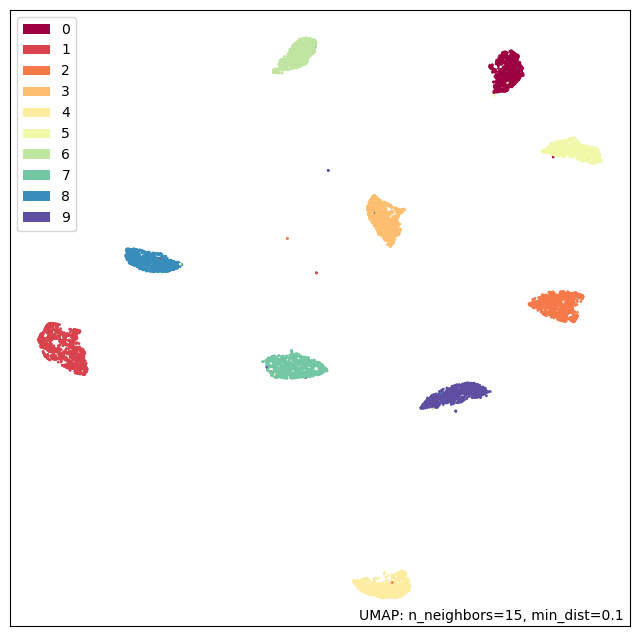

In [71]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

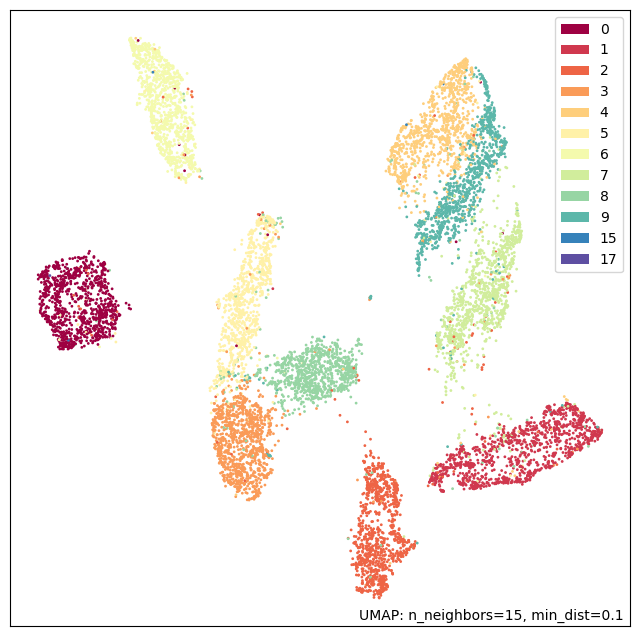

In [72]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

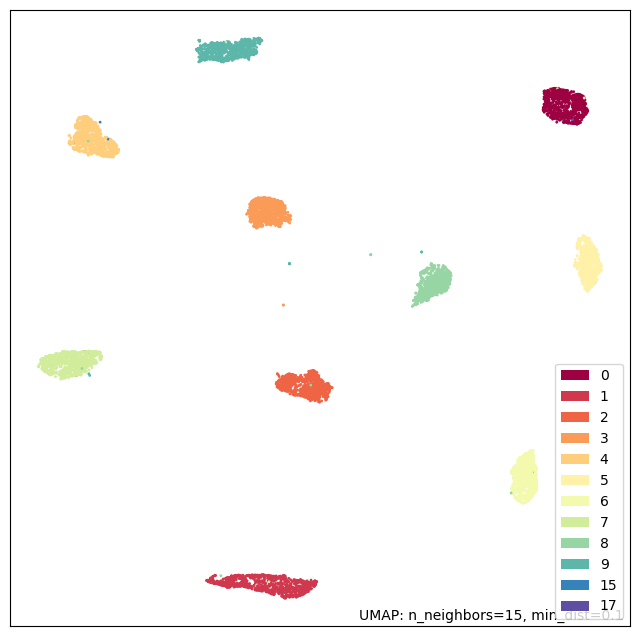

In [73]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

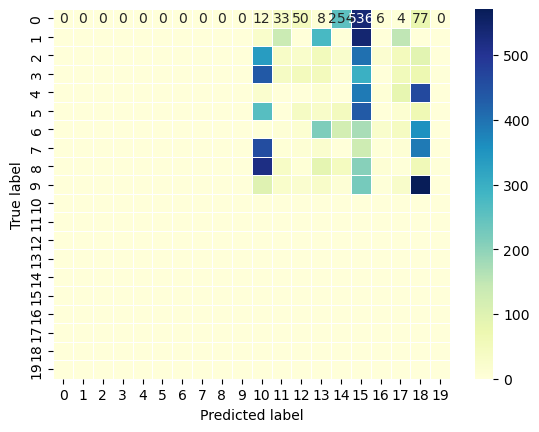

In [74]:
#Previous Task A  Perfomrance Evals

dataset = test_dataset
preds = []
weight_preds = []
lyrpreds = []
y_test_true = []
x_test_true = []

for tstep, (xt, yt) in enumerate(dataset):
    x_test_true.append(xt)
    y_test_true.append(yt)
    _, _, pred, lyr, weight_pred = test_step(xt, yt, WGN_NoP_B)
    preds.append(pred)
    weight_preds.append(weight_pred)
    lyrpreds.append(lyr)
tstacc_fn.reset_states()

y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
A_No_P = accuracy_score(y_test_arg, y_pred )

#confusionmat
y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
cm = confusion_matrix(y_test_arg, y_pred)

plt.figure()
sns.heatmap(cm, fmt = 'd' , cmap="YlGnBu",  annot=True, linewidths=.5)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

In [75]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

avg = None

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "micro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\n\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "macro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "weighted"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)


Averging =  None 
accuracy =  0.0 
precision =  [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.] 
recall =  [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.] 
f1 score =  [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

classwise metrics =  (array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0.]), array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0.]), array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0.]), array([ 980., 1135., 1032., 1010.,  982.,  892.,  958., 1028.,  974.,
       1009.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
          0.,    0.]))

Averging =  micro 

accuracy =  0.0 
precision =  0.0 
recall =  0.0 
f1 score =  0.0

classwise metrics =  (0.0, 0.0, 0.0, None)

Averging =  macro 
accuracy =  0.0 
precision =  0.0 
recall =  0.0 
f1 score =  0.0

classwise metrics =  (0.0, 0.0, 0.0, None)

Averg

/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anacond

<Axes: >

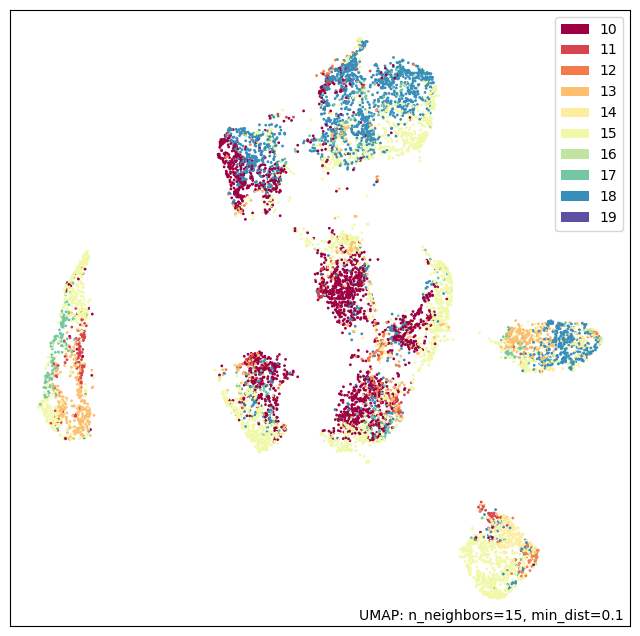

In [76]:
import umap
import umap.plot

sz=10000

imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

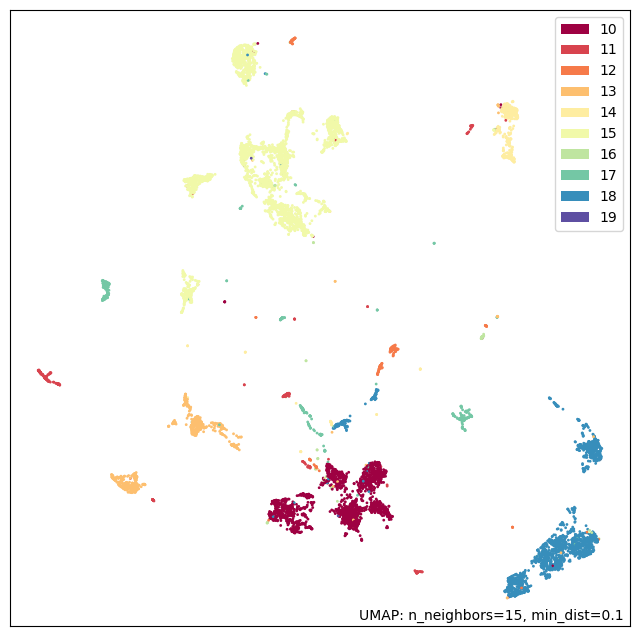

In [77]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

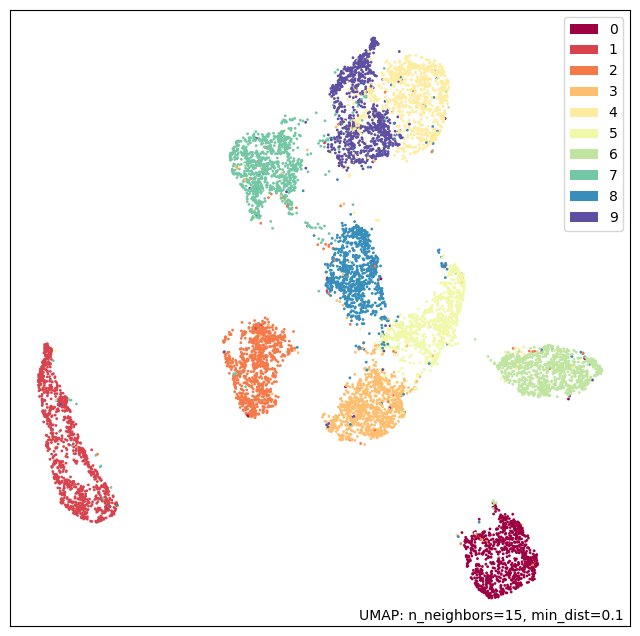

In [78]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

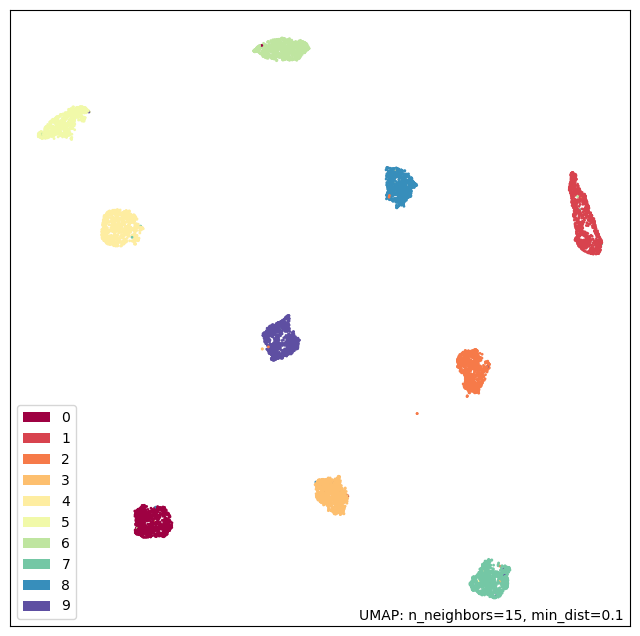

In [79]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

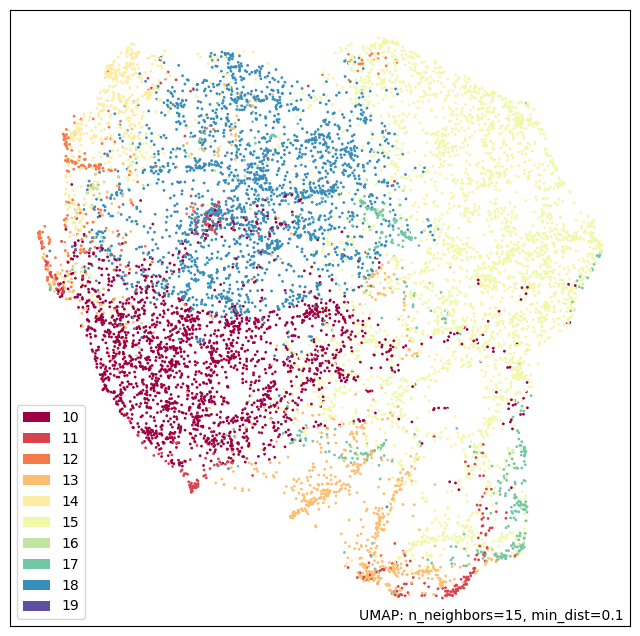

In [80]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

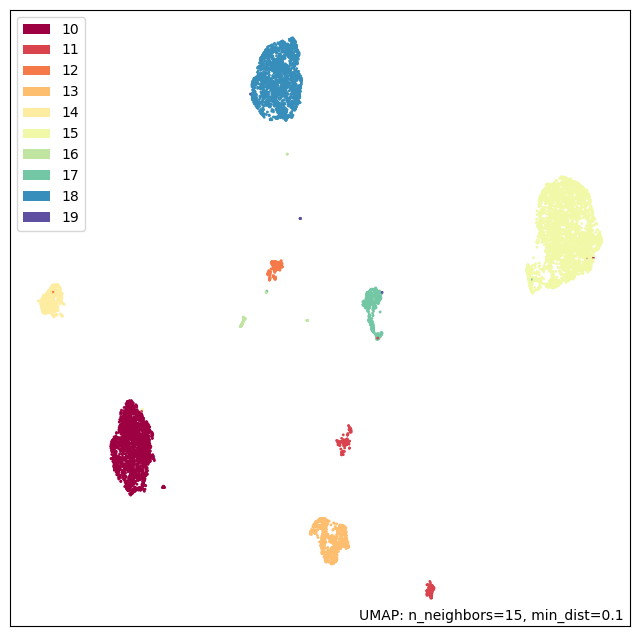

In [81]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

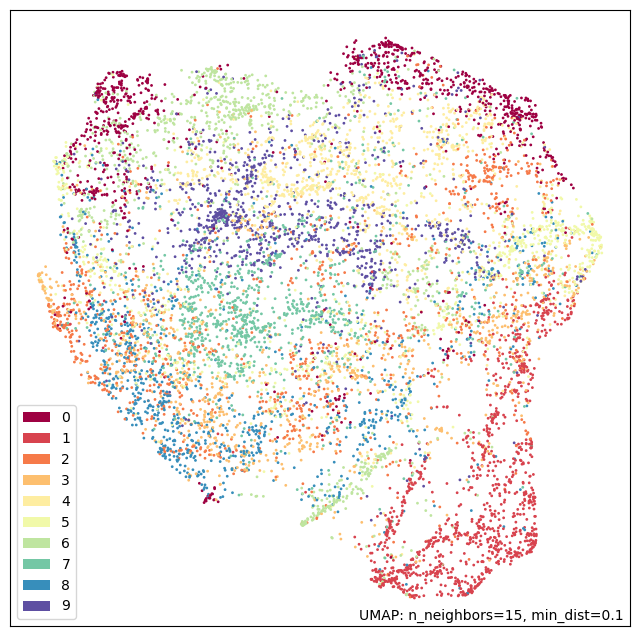

In [82]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

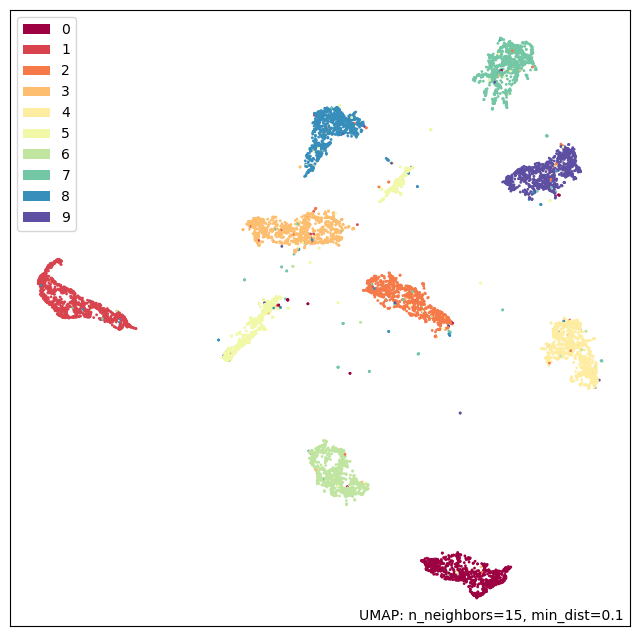

In [83]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

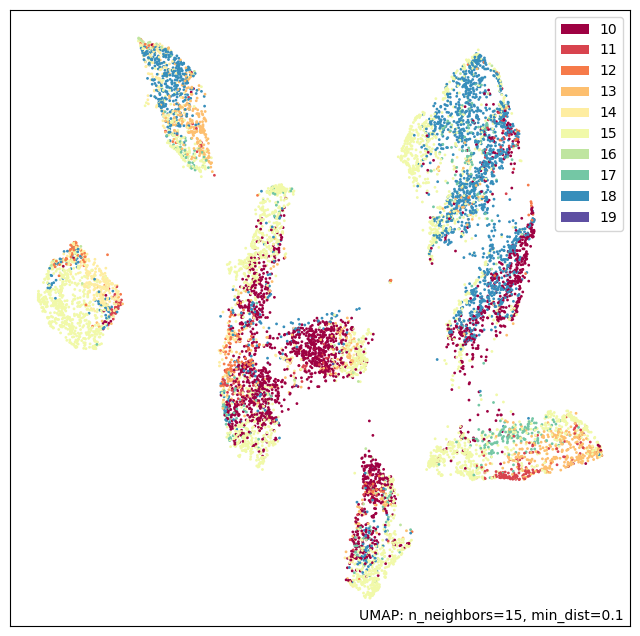

In [84]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

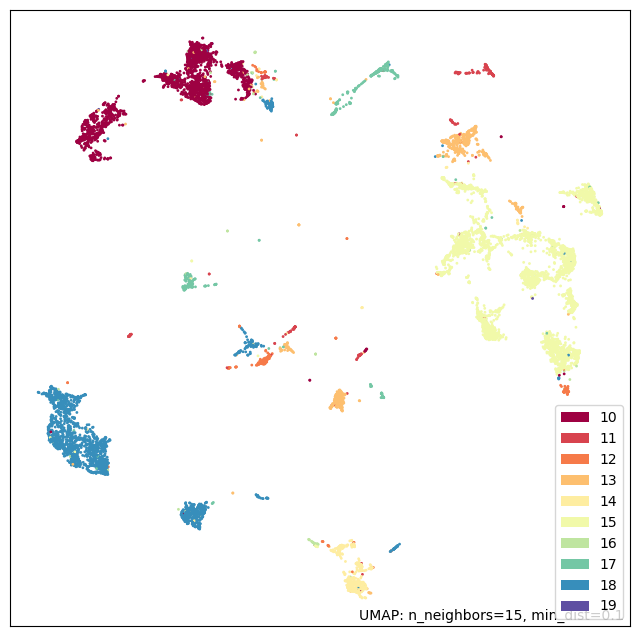

In [85]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

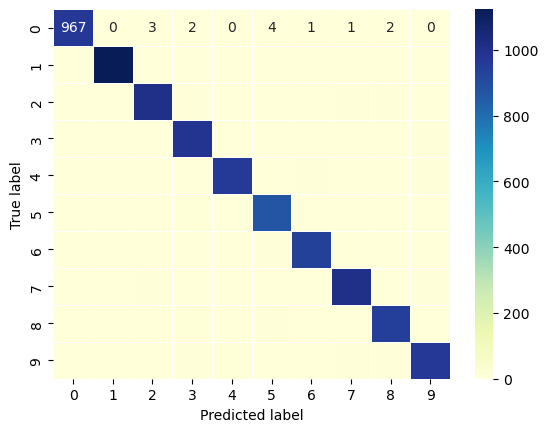

In [86]:
#Task A OG Perfomrance Evals
dataset = test_dataset
preds = []
weight_preds = []
lyrpreds = []
y_test_true = []
x_test_true = []

for tstep, (xt, yt) in enumerate(dataset):
    x_test_true.append(xt)
    y_test_true.append(yt)
    _, _, pred, lyr, weight_pred = test_step(xt, yt, WGN)
    preds.append(pred)
    weight_preds.append(weight_pred)
    lyrpreds.append(lyr)
tstacc_fn.reset_states()

y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
A_OG = accuracy_score(y_test_arg, y_pred )

#confusionmat
y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
cm = confusion_matrix(y_test_arg, y_pred)

plt.figure()
sns.heatmap(cm, fmt = 'd' , cmap="YlGnBu",  annot=True, linewidths=.5)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

In [87]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

avg = None

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "micro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\n\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "macro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "weighted"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)


Averging =  None 
accuracy =  0.978 
precision =  [0.99077869 0.99293286 0.97388781 0.95934172 0.97768763 0.97533632
 0.98221757 0.97579864 0.97319588 0.97773279] 
recall =  [0.98673469 0.99030837 0.97577519 0.98118812 0.98167006 0.97533632
 0.98016701 0.98054475 0.96919918 0.95738355] 
f1 score =  [0.98875256 0.99161888 0.97483059 0.97014195 0.9796748  0.97533632
 0.98119122 0.97816594 0.97119342 0.96745118]

classwise metrics =  (array([0.99077869, 0.99293286, 0.97388781, 0.95934172, 0.97768763,
       0.97533632, 0.98221757, 0.97579864, 0.97319588, 0.97773279]), array([0.98673469, 0.99030837, 0.97577519, 0.98118812, 0.98167006,
       0.97533632, 0.98016701, 0.98054475, 0.96919918, 0.95738355]), array([0.98875256, 0.99161888, 0.97483059, 0.97014195, 0.9796748 ,
       0.97533632, 0.98119122, 0.97816594, 0.97119342, 0.96745118]), array([ 980, 1135, 1032, 1010,  982,  892,  958, 1028,  974, 1009]))

Averging =  micro 

accuracy =  0.978 
precision =  0.978 
recall =  0.978 
f1 score 

<Axes: >

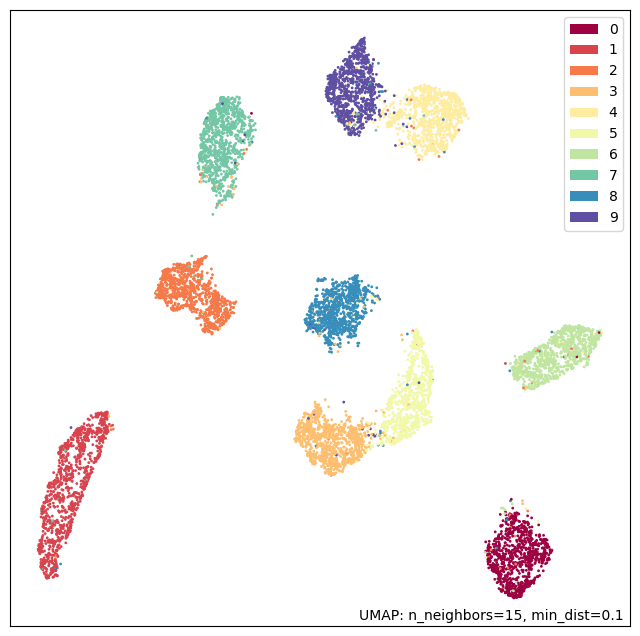

In [88]:
import umap
import umap.plot

sz=10000

imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

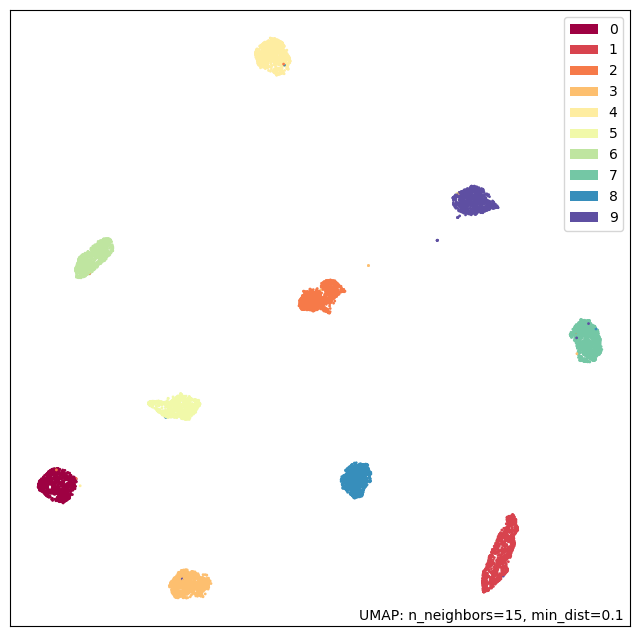

In [89]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

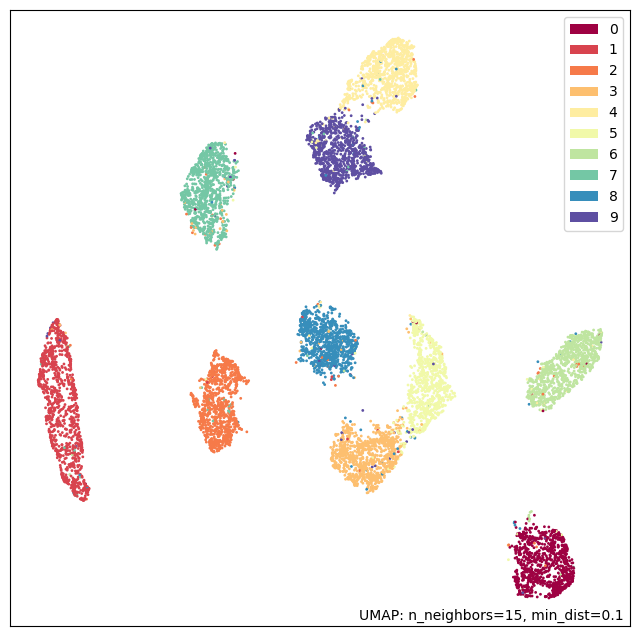

In [90]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

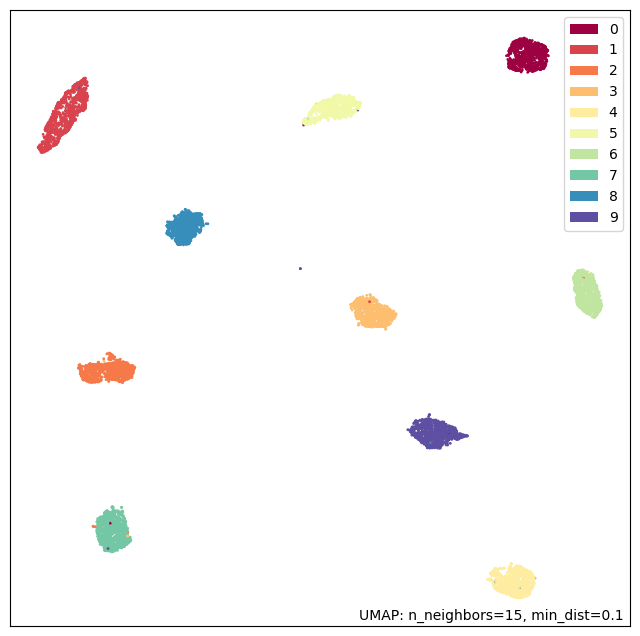

In [91]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

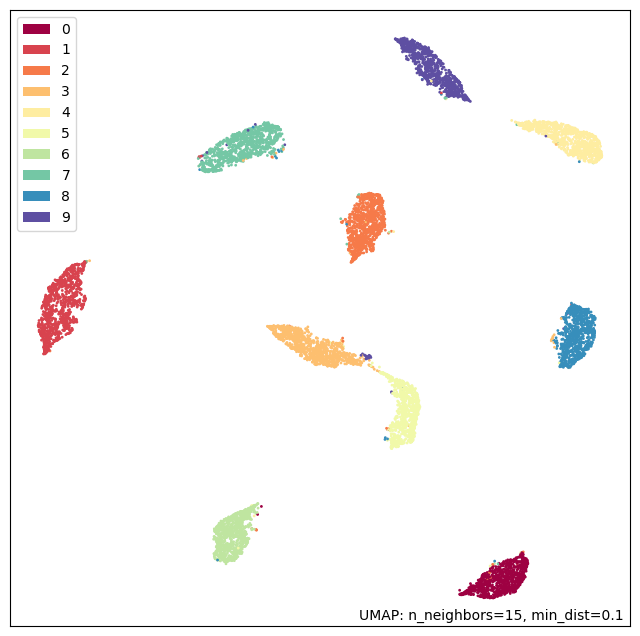

In [92]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

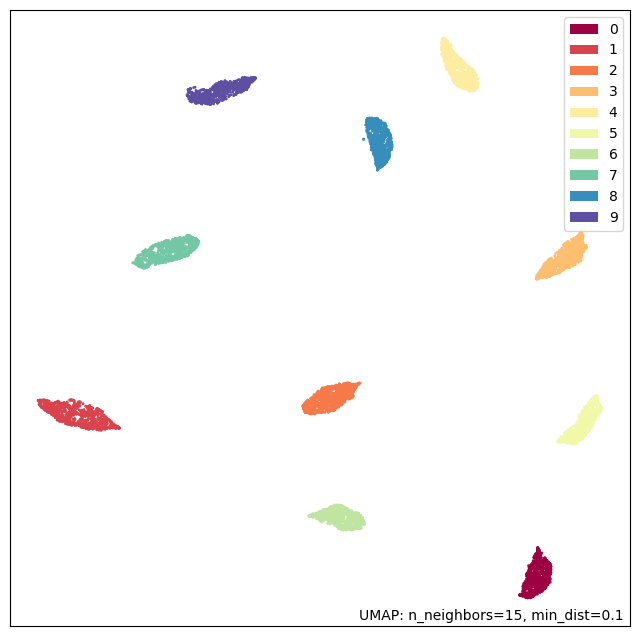

In [93]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

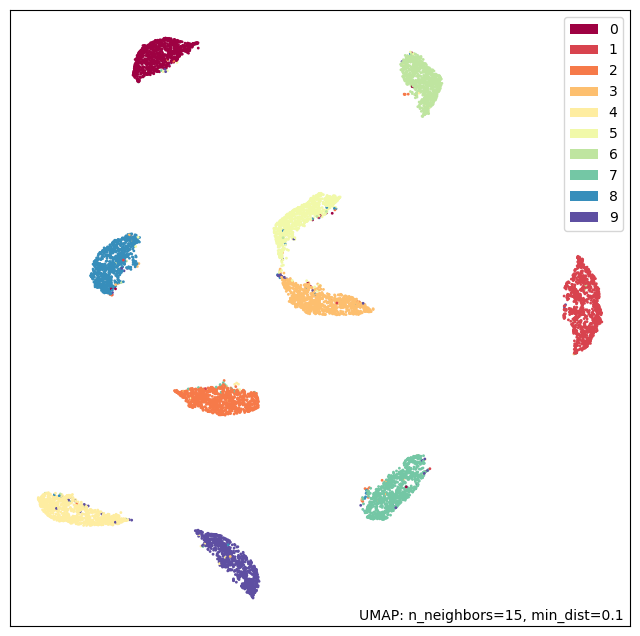

In [94]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

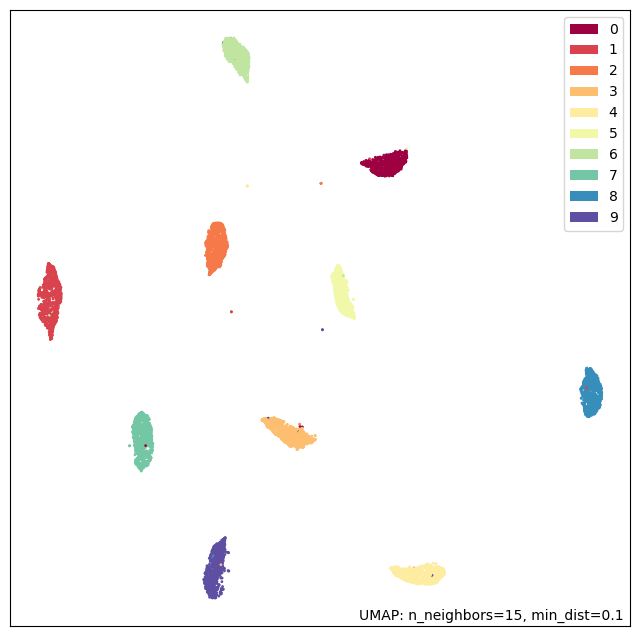

In [95]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

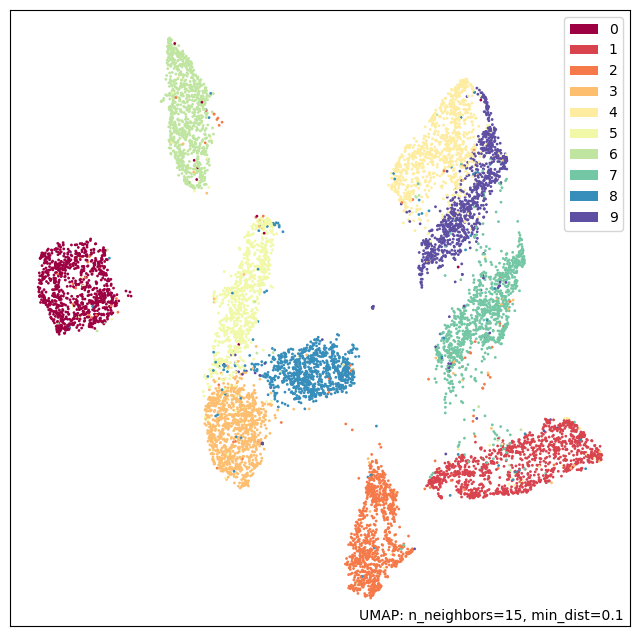

In [96]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

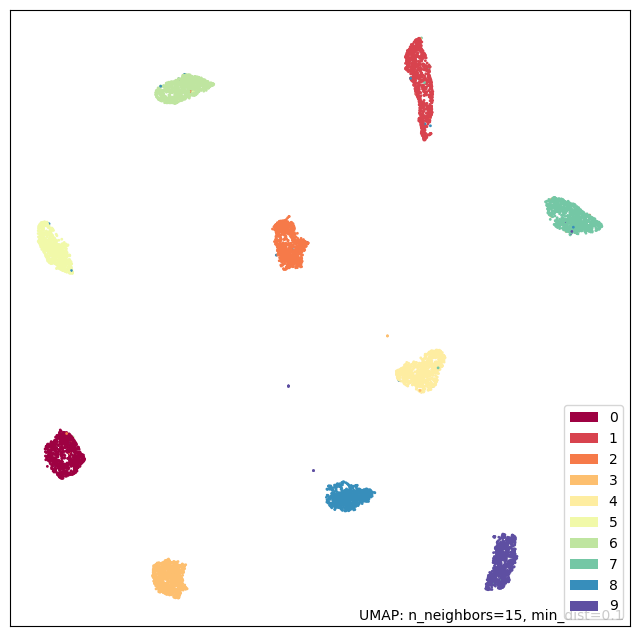

In [97]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

In [98]:
print("Task A Original Accuracy: %.2f%%" % (100*A_OG))
print("Task B EWC method penalty Accuracy: %.2f%%" % (100*B_EWC))
print("Task B SGD method Accuracy: %.2f%%" % (100*B_No_P))
print("Task A EWC method penalty Accuracy: %.2f%%" % (100*A_EWC))
print("Task A SGD method Accuracy: %.2f%%" % (100*A_No_P))



Task A Original Accuracy: 97.80%
Task B EWC method penalty Accuracy: 73.93%
Task B SGD method Accuracy: 87.65%
Task A EWC method penalty Accuracy: 97.67%
Task A SGD method Accuracy: 0.00%


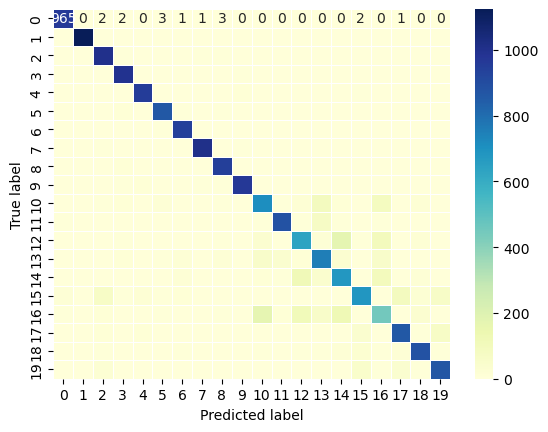

In [99]:
import pandas as pd
import seaborn as sns
from sklearn.metrics import accuracy_score, confusion_matrix

#Current Task B Perfomrance Evals
dataset = abtest_dataset
preds = []
weight_preds = []
lyrpreds = []
y_test_true = []
x_test_true = []

for tstep, (xt, yt) in enumerate(dataset):
    x_test_true.append(xt)
    y_test_true.append(yt)
    _, _, pred, lyr, weight_pred = test_step(xt, yt, WGN_ewcB)
    preds.append(pred)
    weight_preds.append(weight_pred)
    lyrpreds.append(lyr)
tstacc_fn.reset_states()

y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
B_EWC = accuracy_score(y_test_arg, y_pred )

#confusionmat
cm = confusion_matrix(y_test_arg, y_pred)

plt.figure()
sns.heatmap(cm, fmt = 'd' , cmap="YlGnBu",  annot=True, linewidths=.5)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()



In [100]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

avg = None

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "micro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\n\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "macro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "weighted"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)


Averging =  None 
accuracy =  0.858 
precision =  [0.95450049 0.99205649 0.86712683 0.92293408 0.94094488 0.93088553
 0.92262488 0.97013487 0.92465753 0.96796797 0.7148635  0.93220339
 0.69484083 0.72211538 0.6500956  0.83313033 0.55377009 0.85177866
 0.86857708 0.85700197] 
recall =  [0.98469388 0.99030837 0.97383721 0.98415842 0.97352342 0.96636771
 0.98329854 0.97957198 0.97022587 0.95837463 0.707      0.88
 0.633      0.751      0.68       0.684      0.448      0.862
 0.879      0.869     ] 
f1 score =  [0.96936213 0.99118166 0.91738932 0.95256349 0.95695696 0.94829483
 0.95199596 0.97483059 0.94689379 0.96314741 0.71091001 0.90534979
 0.66248038 0.73627451 0.66471163 0.75123558 0.49530127 0.85685885
 0.87375746 0.86295929]

classwise metrics =  (array([0.95450049, 0.99205649, 0.86712683, 0.92293408, 0.94094488,
       0.93088553, 0.92262488, 0.97013487, 0.92465753, 0.96796797,
       0.7148635 , 0.93220339, 0.69484083, 0.72211538, 0.6500956 ,
       0.83313033, 0.55377009, 0.8517

<Axes: >

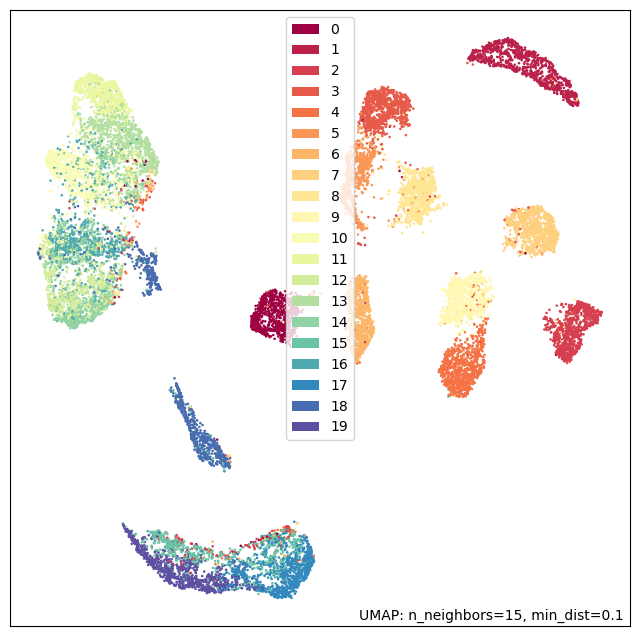

In [101]:
import umap
import umap.plot

sz=20000

imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

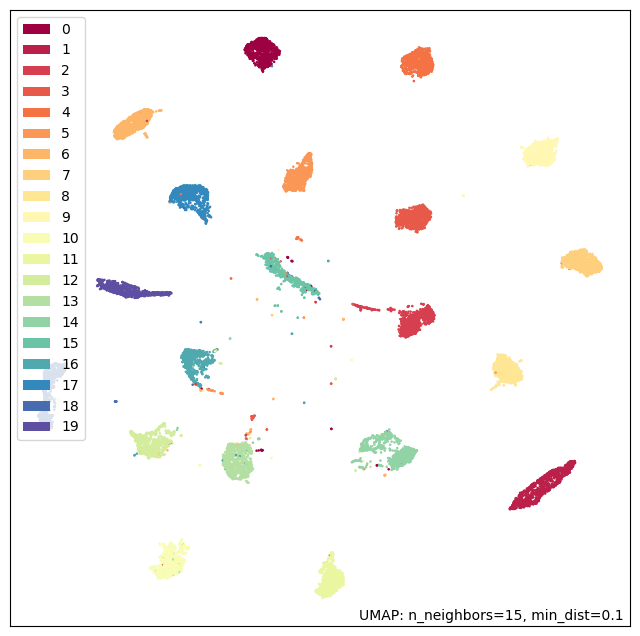

In [102]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

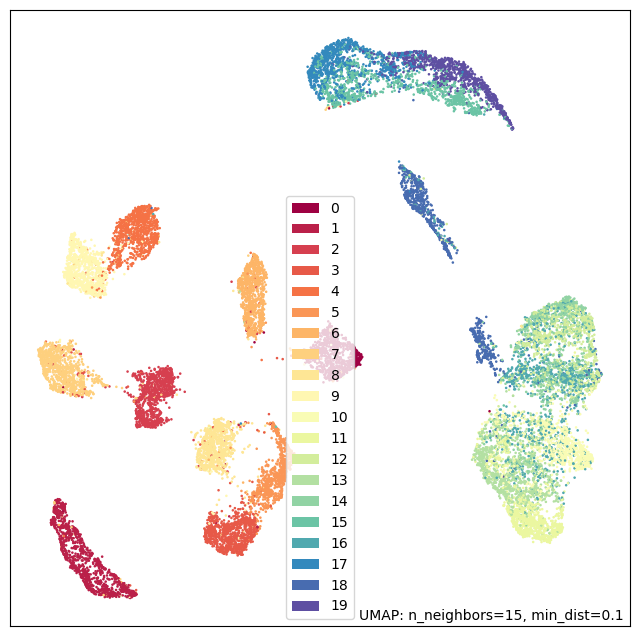

In [103]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

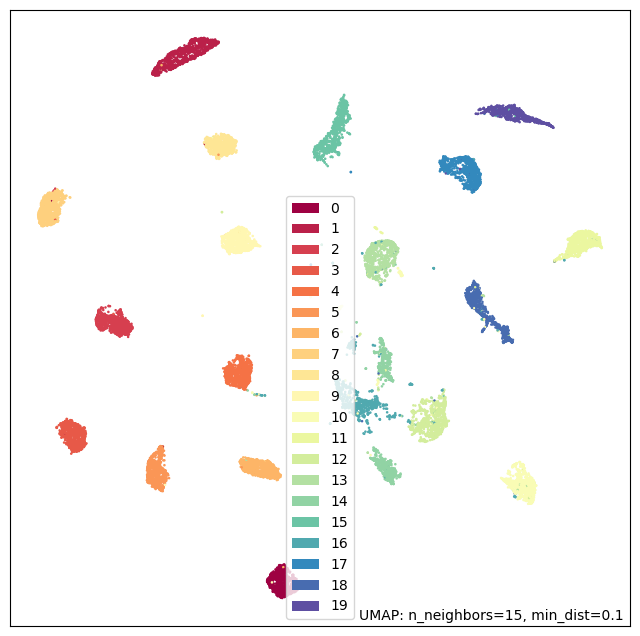

In [104]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

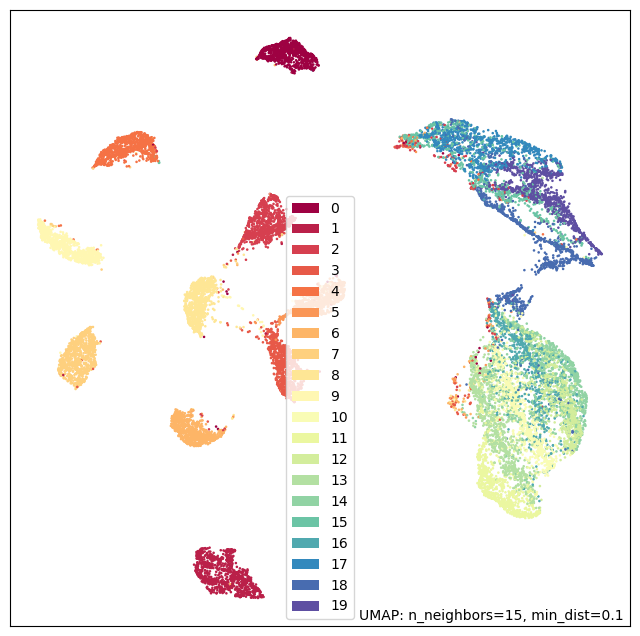

In [105]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

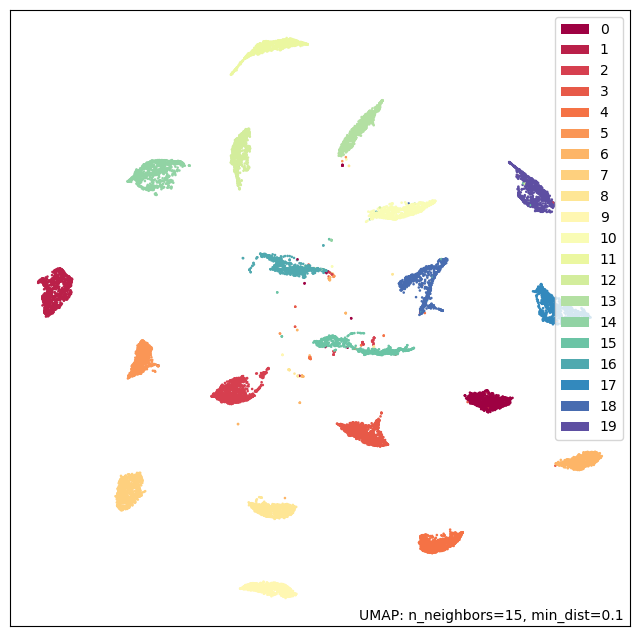

In [106]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

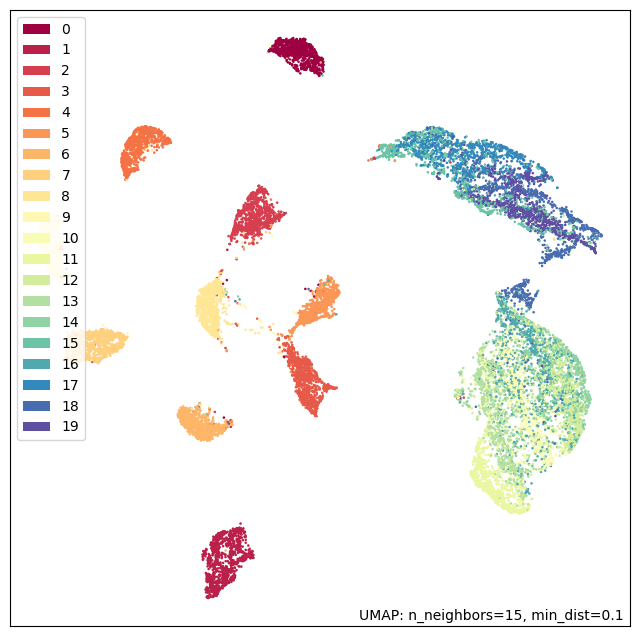

In [107]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

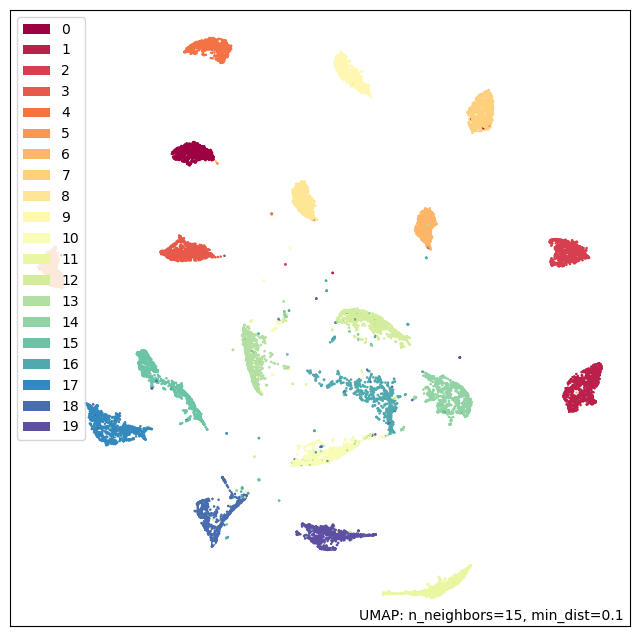

In [108]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

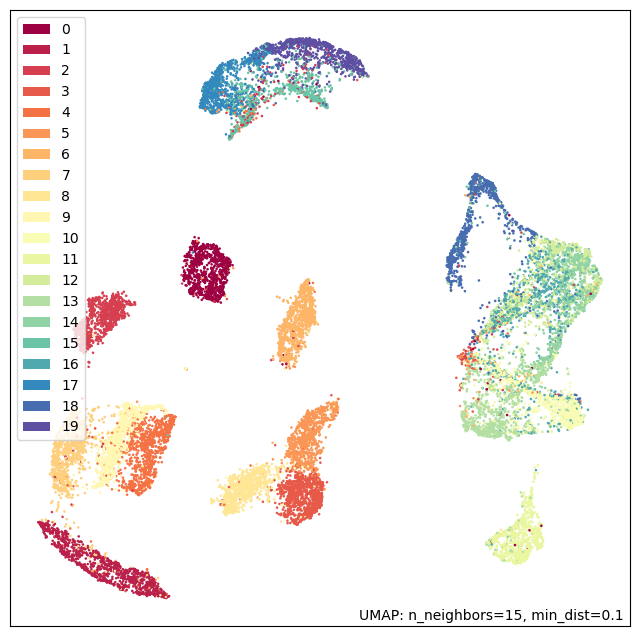

In [109]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

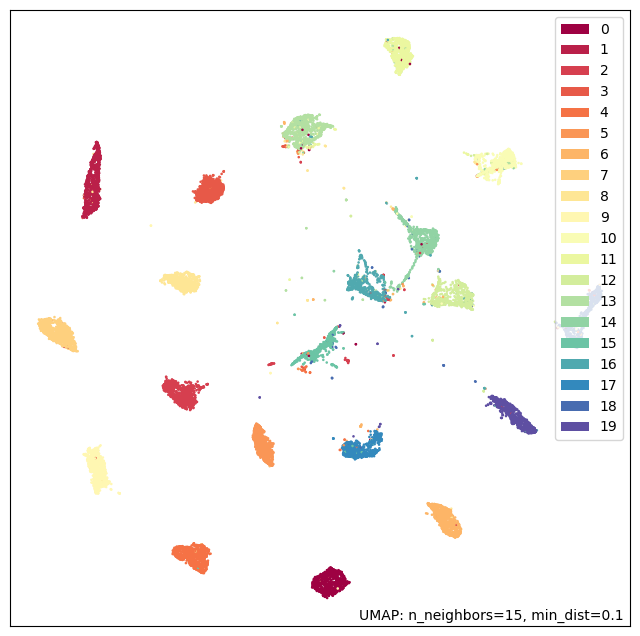

In [110]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

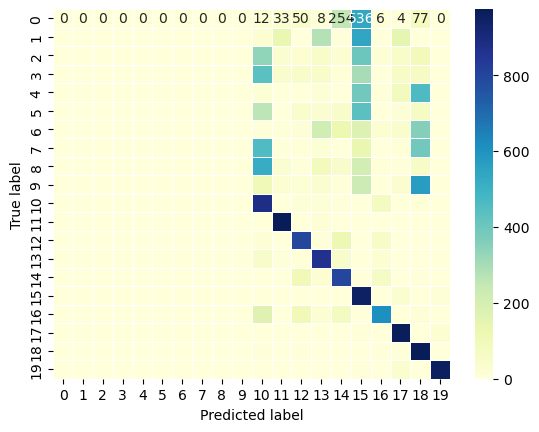

In [111]:
#Current Task B Perfomrance Evals

dataset = abtest_dataset
preds = []
weight_preds = []
lyrpreds = []
y_test_true = []
x_test_true = []

for tstep, (xt, yt) in enumerate(dataset):
    x_test_true.append(xt)
    y_test_true.append(yt)
    _, _, pred, lyr, weight_pred = test_step(xt, yt, WGN_NoP_B)
    preds.append(pred)
    weight_preds.append(weight_pred)
    lyrpreds.append(lyr)
tstacc_fn.reset_states()

y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
B_No_P = accuracy_score(y_test_arg, y_pred )

#confusionmat
cm = confusion_matrix(y_test_arg, y_pred)

plt.figure()
sns.heatmap(cm, fmt = 'd' , cmap="YlGnBu",  annot=True, linewidths=.5)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

In [112]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

avg = None

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "micro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\n\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "macro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "weighted"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)


Averging =  None 
accuracy =  0.43825 
precision =  [0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.26717325 0.75096376
 0.63788969 0.49569707 0.50732951 0.22046512 0.66630197 0.65337838
 0.30920635 0.95029821] 
recall =  [0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.879 0.974
 0.798 0.864 0.796 0.948 0.609 0.967 0.974 0.956] 
f1 score =  [0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.40979021 0.84806269
 0.70901821 0.62996719 0.61969638 0.35773585 0.63636364 0.77983871
 0.46939759 0.95314058]

classwise metrics =  (array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.26717325, 0.75096376, 0.63788969, 0.49569707, 0.50732951,
       0.22046512, 0.66630197, 0.65337838, 0.30920635, 0.95029821]), array([0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   ,
   

/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj

<Axes: >

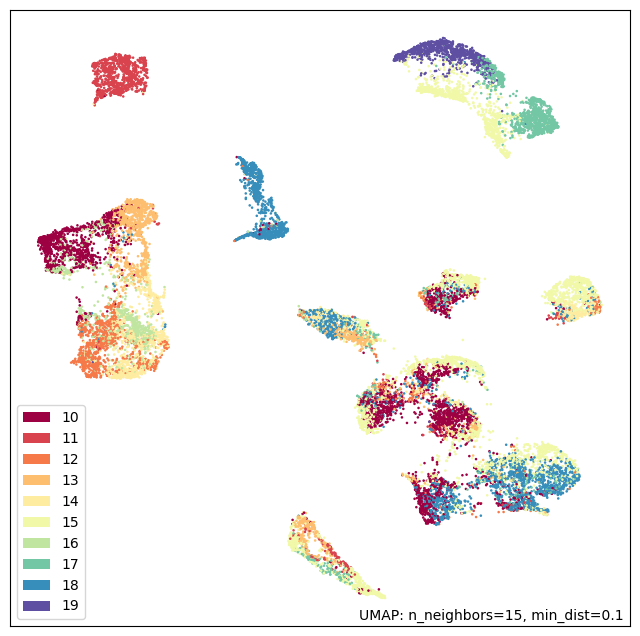

In [113]:
import umap
import umap.plot

sz=20000

imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

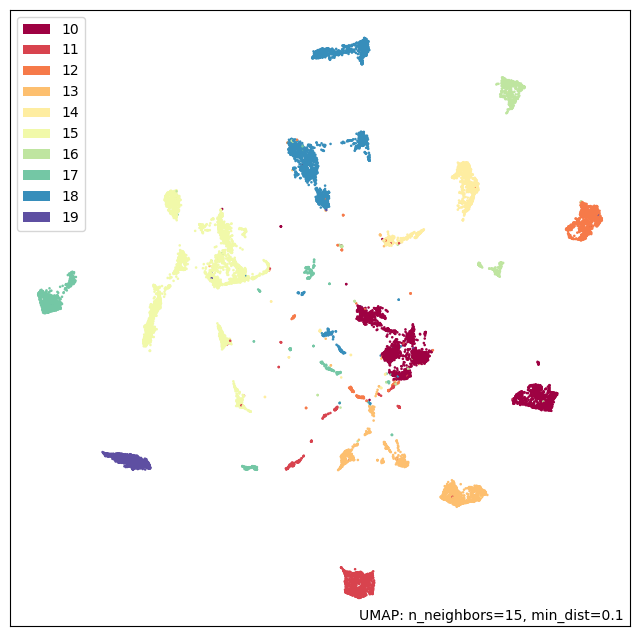

In [114]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

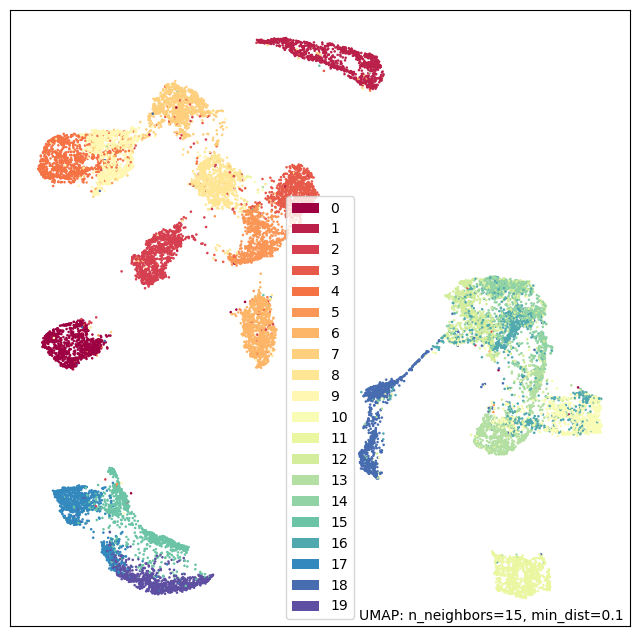

In [115]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

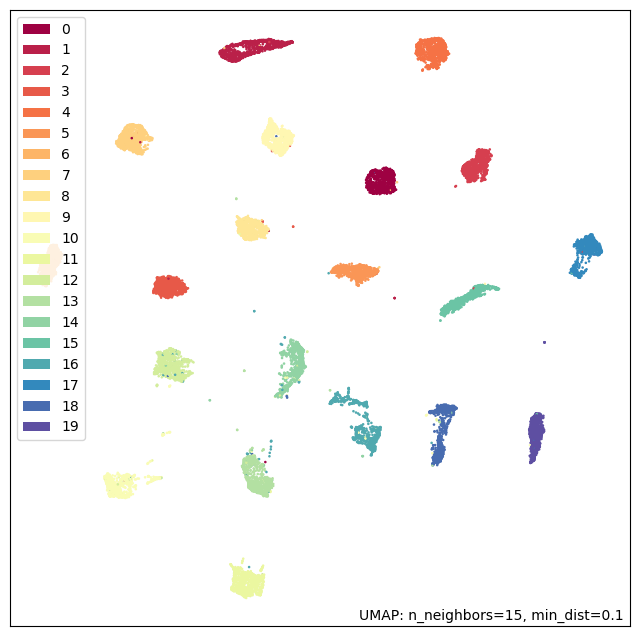

In [116]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

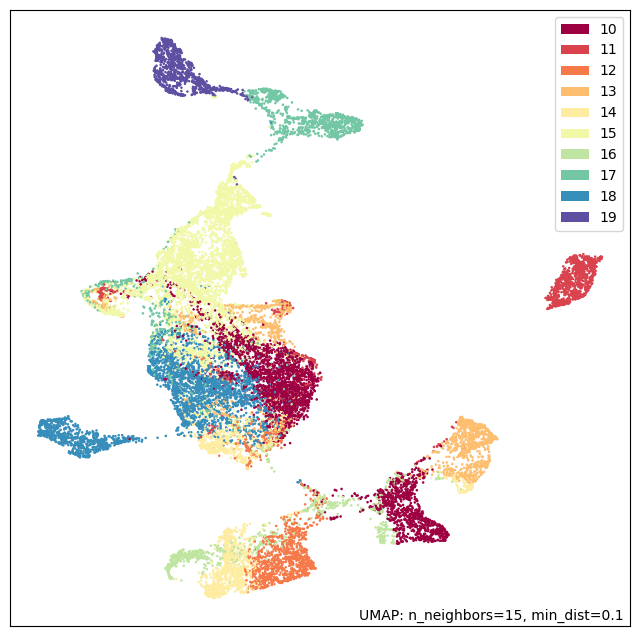

In [117]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

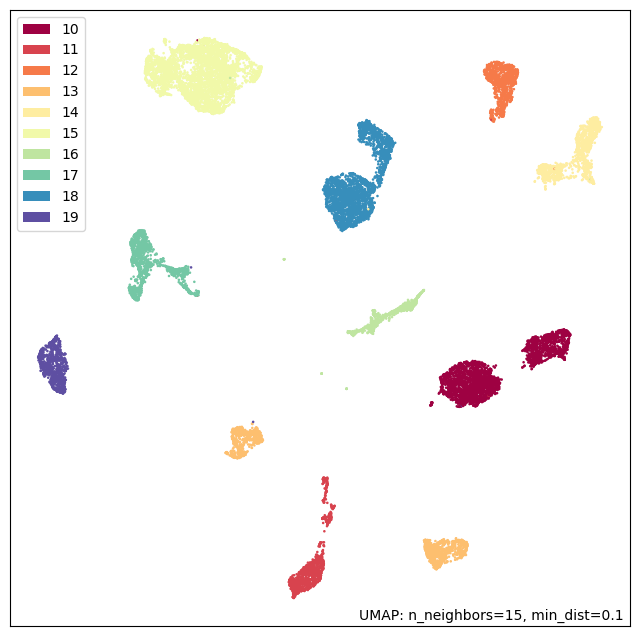

In [118]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

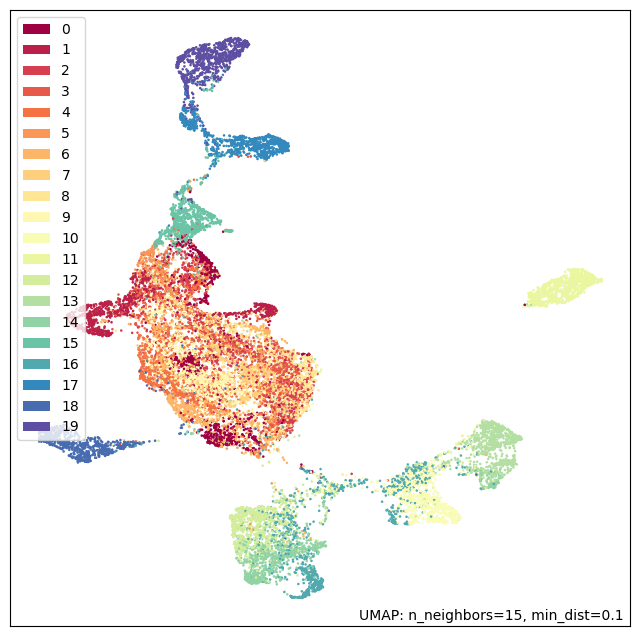

In [119]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

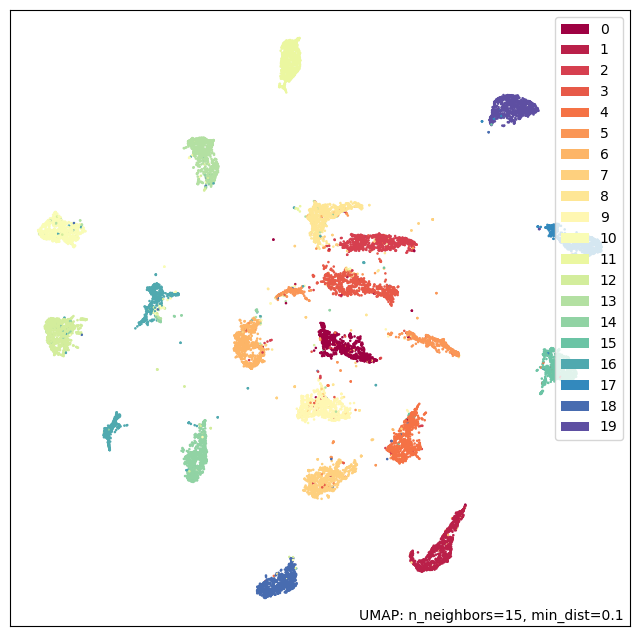

In [120]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

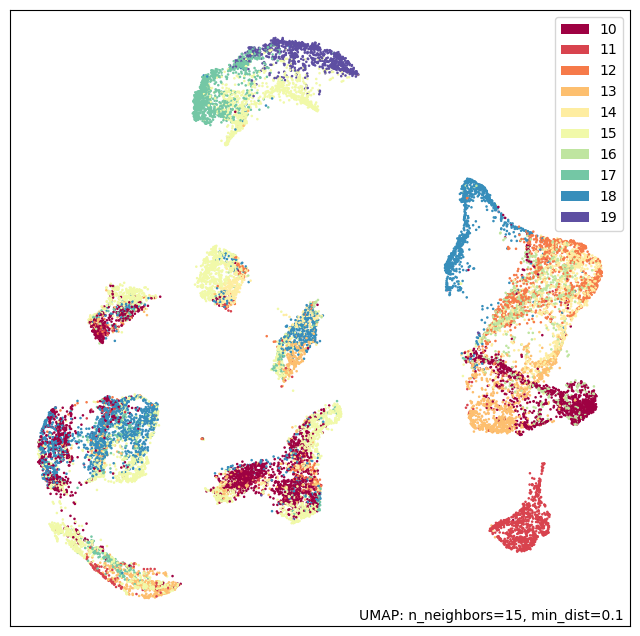

In [121]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

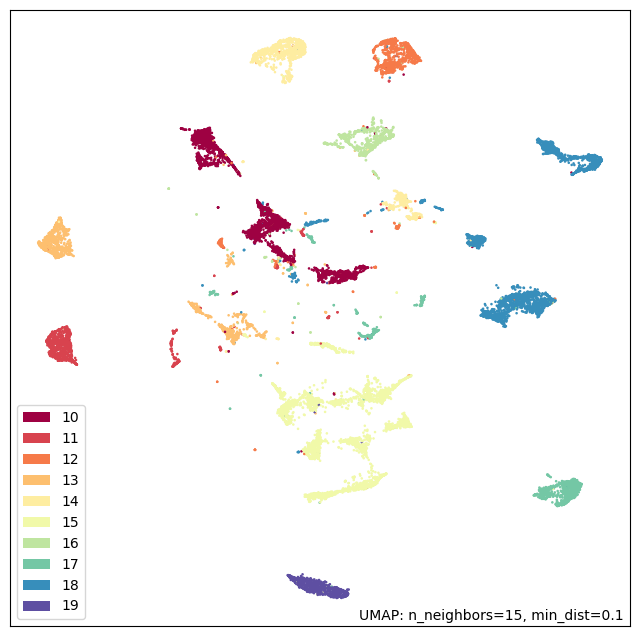

In [122]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

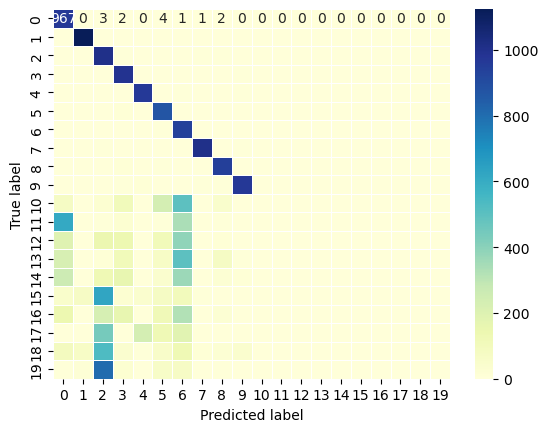

In [123]:
#Task A OG Perfomrance Evals
dataset = abtest_dataset
preds = []
weight_preds = []
lyrpreds = []
y_test_true = []
x_test_true = []
for tstep, (xt, yt) in enumerate(dataset):
    x_test_true.append(xt)
    y_test_true.append(yt)
    _, _, pred, lyr, weight_pred = test_step(xt, yt, WGN)
    preds.append(pred)
    weight_preds.append(weight_pred)
    lyrpreds.append(lyr)
tstacc_fn.reset_states()

y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
A_OG = accuracy_score(y_test_arg, y_pred )

#confusionmat
y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
cm = confusion_matrix(y_test_arg, y_pred)

plt.figure()
sns.heatmap(cm, fmt = 'd' , cmap="YlGnBu",  annot=True, linewidths=.5)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

In [124]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

avg = None

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "micro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\n\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "macro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "weighted"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)


Averging =  None 
accuracy =  0.489 
precision =  [0.36559546 0.86728395 0.25263422 0.53887983 0.75607843 0.483602
 0.24326425 0.95274102 0.79327731 0.91825095 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.        ] 
recall =  [0.98673469 0.99030837 0.97577519 0.98118812 0.98167006 0.97533632
 0.98016701 0.98054475 0.96919918 0.95738355 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.        ] 
f1 score =  [0.53351724 0.92472234 0.40135512 0.6956827  0.85423128 0.64659978
 0.38978829 0.96644295 0.87245841 0.93740902 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.        ]

classwise metrics =  (array([0.36559546, 0.86728395, 0.25263422, 0.53887983, 0.75607843,
       0.483602  , 0.24326425, 0.95274102, 0.79327731, 0.91825095,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ]), array([

/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj

<Axes: >

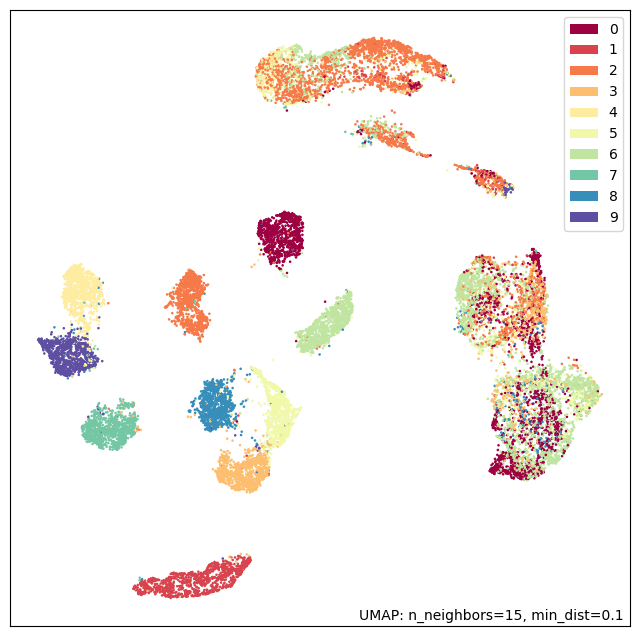

In [125]:
import umap
import umap.plot

sz=20000

imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

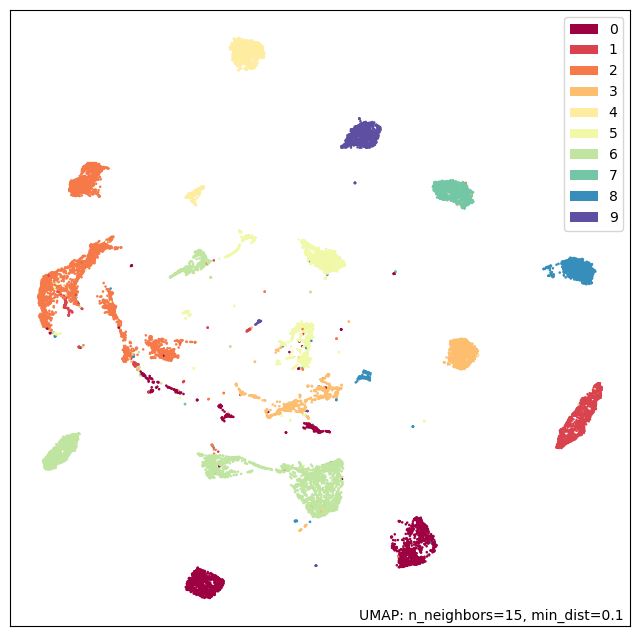

In [126]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

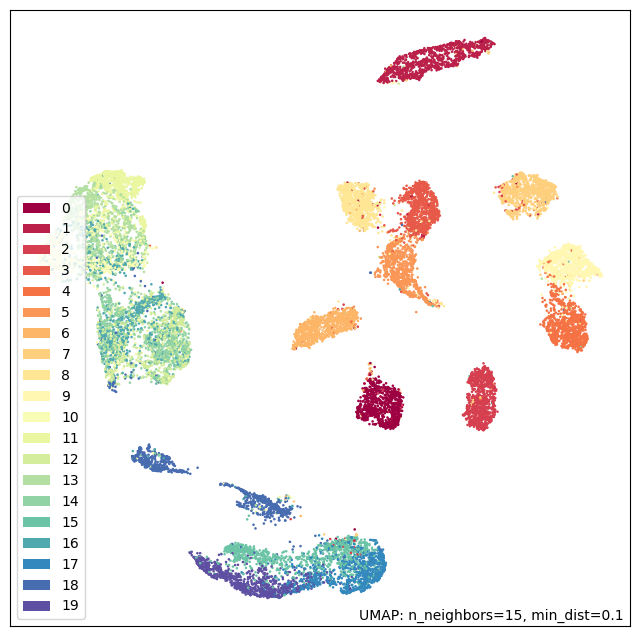

In [127]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

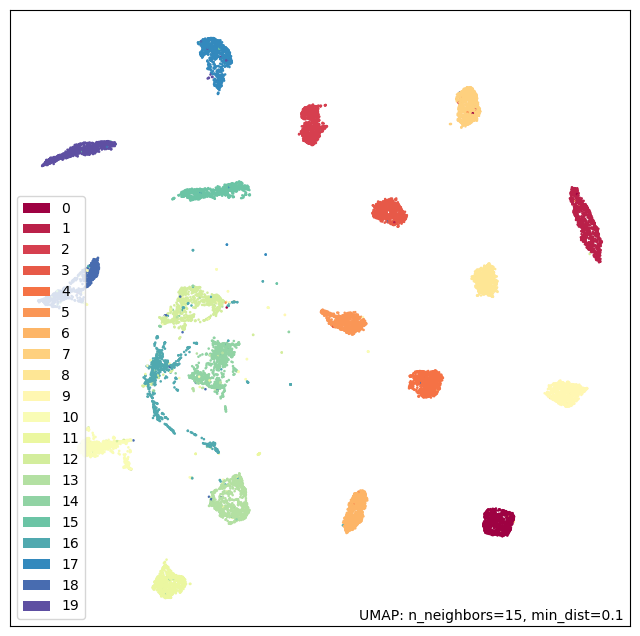

In [128]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

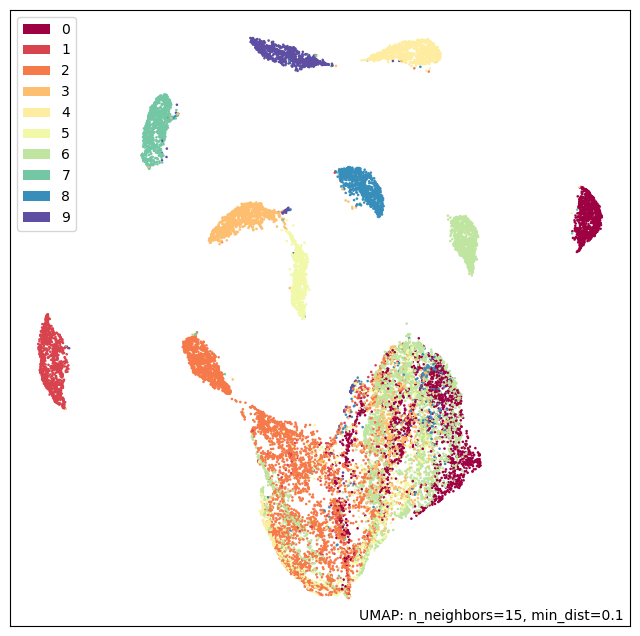

In [129]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

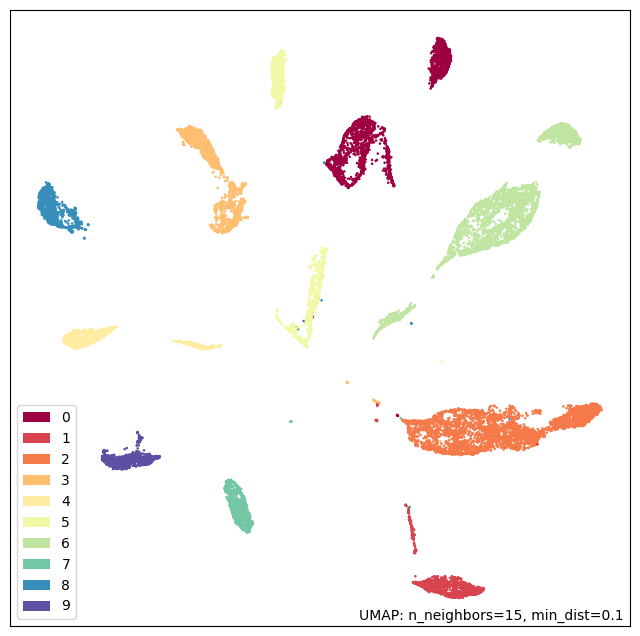

In [130]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

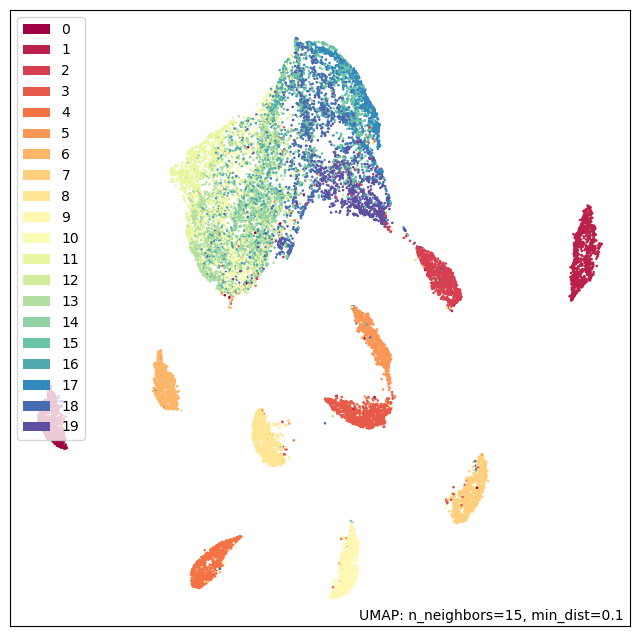

In [131]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

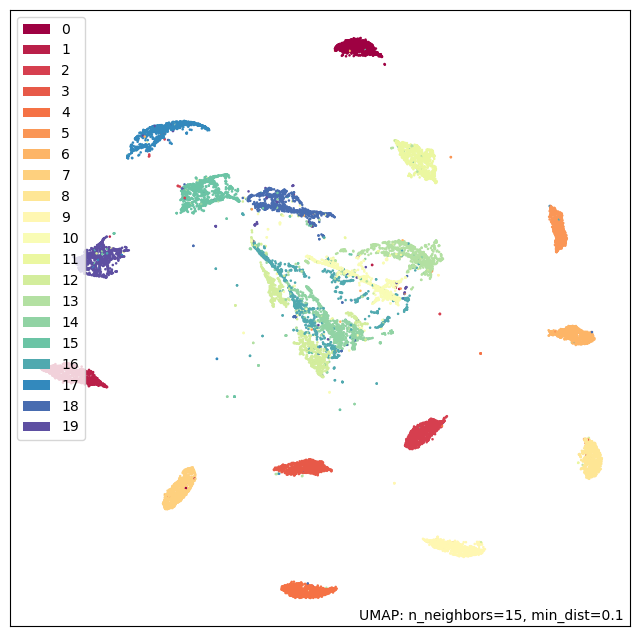

In [132]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

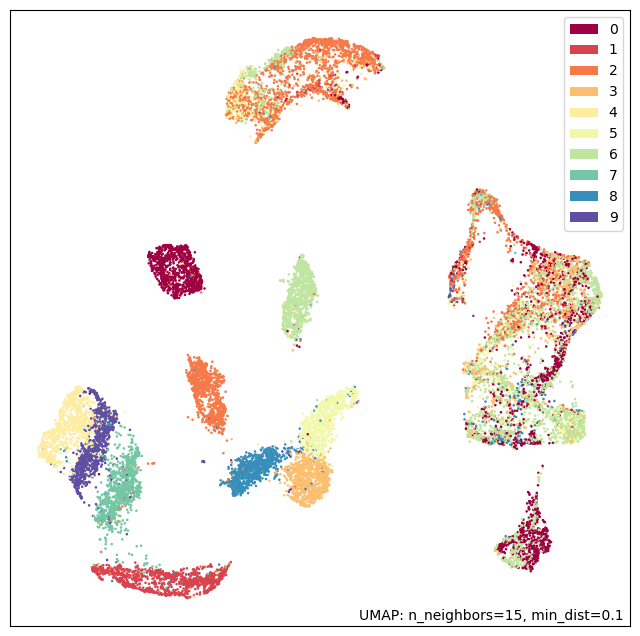

In [133]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

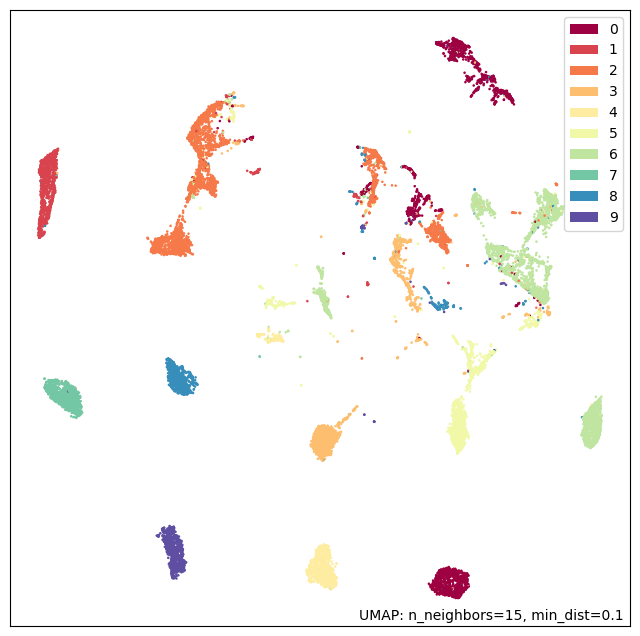

In [134]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

In [135]:
print("Task A Original Accuracy: %.2f%%" % (100*A_OG))
print("Task B EWC method penalty Accuracy: %.2f%%" % (100*B_EWC))
print("Task B SGD method Accuracy: %.2f%%" % (100*B_No_P))



Task A Original Accuracy: 48.90%
Task B EWC method penalty Accuracy: 85.80%
Task B SGD method Accuracy: 43.82%


# Fmnist first then Mnist

In [136]:
import tensorflow as tf

gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
  tf.config.experimental.set_memory_growth(gpu, True)

In [137]:
import numpy as np
import tensorflow as tf
import tensorflow.keras.backend as K
from tensorflow.keras.regularizers import Regularizer

#tf.compat.v1.disable_eager_execution()

def computer_fisher(model, imgset, num_sample=30):
    f_accum = []
    for i in range(len(model.weights)):
        f_accum.append(np.zeros(K.int_shape(model.weights[i])))
    f_accum = np.array(f_accum)
    for j in range(num_sample):
        img_index = np.random.randint(imgset.shape[0])
        for m in range(len(model.weights)):                           
            grads = K.gradients(K.log(model.output), model.weights)[m]
            result = K.function([model.input], [grads])
            f_accum[m] += np.square(result([np.expand_dims(imgset[img_index], 0)])[0])
    f_accum /= num_sample
    return f_accum

"""
def ecomputer_fisher(model, imgset, num_sample=30000):
    f_accum = []
    for i in range(len(model.weights)):
        f_accum.append(tf.zeros(model.weights[i].shape))
    f_accum = np.array(f_accum)
    for j in range(num_sample):
        img_index = np.random.randint(len(imgset))
        for m in range(len(model.weights)):
            with tf.GradientTape() as tape:                
                y_preds=tf.math.log(WGN(imgset[img_index]))
            grads = tape.gradient(y_preds, model.weights)[m]
            f_accum[m] += tf.square(grads[0])
    f_accum /= num_sample
    return f_accum
"""
"""
def ecomputer_fisher(model, imgset, num_sample=30000):
    f_accum = [tf.zeros_like(weight) for weight in model.weights]
    for j in range(num_sample):
        img_index = np.random.randint(len(imgset))
        with tf.GradientTape() as tape:
            y_preds = model(imgset[img_index])  # Assuming model directly predicts logit values
            loss = tf.reduce_sum(tf.math.log(y_preds))  # Compute log likelihood
        grads = tape.gradient(loss, model.weights)
        for m in range(len(model.weights)):
            f_accum[m] += tf.square(grads[m])
    f_accum = np.asarray(f_accum)/num_sample
    return f_accum
"""
def ecomputer_fisher(model, imgset, num_sample=30, epsilon=1e-10):
    f_accum = [tf.zeros_like(weight) for weight in model.weights]
    for j in range(num_sample):
        img_index = np.random.randint(len(imgset))
        with tf.GradientTape() as tape:
            y_preds = model(imgset[img_index])
            # Clip probabilities to avoid taking the logarithm of zero or one
            y_preds = tf.clip_by_value(y_preds, epsilon, 1.0 - epsilon)
            # Compute log likelihood
            loss = tf.reduce_sum(tf.math.log(y_preds))
        grads = tape.gradient(loss, model.weights)
        for m in range(len(model.weights)):
            f_accum[m] += tf.square(grads[m])
    f_accum = np.asarray(f_accum)/num_sample
    return f_accum

def ecomputer_fisher_full(model, imgset, epsilon=1e-10):
    f_accum = [tf.zeros_like(weight) for weight in model.weights]
    for i in range(len(imgset)):
        with tf.GradientTape() as tape:
            y_preds = model(imgset[i])
            # Clip probabilities to avoid taking the logarithm of zero or one
            y_preds = tf.clip_by_value(y_preds, epsilon, 1.0 - epsilon)
            # Compute log likelihood
            loss = tf.reduce_sum(tf.math.log(y_preds))
        grads = tape.gradient(loss, model.weights)
        for m in range(len(model.weights)):
            f_accum[m] += tf.square(grads[m])
    f_accum = np.asarray(f_accum)/len(imgset)
    return f_accum

class ewc_reg(Regularizer):
    def __init__(self, fisher, prior_weights, Lambda=0.1):
        self.fisher = fisher
        self.prior_weights = prior_weights
        self.Lambda = Lambda

    def __call__(self, x):
        regularization = 0.
        regularization += self.Lambda * tf.reduce_sum(self.fisher * tf.square(x - self.prior_weights))
        return regularization

    def get_config(self):
        return {'Lambda': float(self.Lambda)}

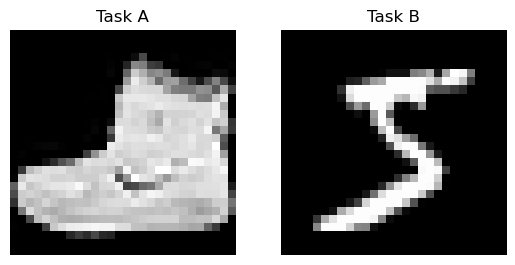

In [138]:
from tensorflow.keras.layers import Dense
from tensorflow.keras.datasets import mnist, fashion_mnist
from tensorflow.keras.models import Sequential
import numpy as np
import matplotlib.pyplot as plt

(x_train, y_train), (x_test, y_test) = fashion_mnist.load_data()
x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
x_train /= 255
x_test /= 255

# convert class vectors to binary class matrices
y_train = tf.keras.utils.to_categorical(y_train, 10)
y_test = tf.keras.utils.to_categorical(y_test, 10)

a = np.zeros((len(y_train),1))
b = np.zeros((len(y_test),1))

for i in range(10):
    y_train = np.hstack((y_train, a))
    y_test = np.hstack((y_test, b))

# Original MNIST for Task A
x_train = x_train.reshape((-1, 784))
x_test = x_test.reshape((-1, 784))

# fmnist for Task B
(x_train1, y_train1), (x_test1, y_test1) = mnist.load_data()
x_train1 = x_train1.astype('float32')
x_test1 = x_test1.astype('float32')
x_train1 /= 255
x_test1 /= 255

x_train1 = x_train1.reshape((-1, 784))
x_test1 = x_test1.reshape((-1, 784))

# convert class vectors to binary class matrices
y_train1 = tf.keras.utils.to_categorical(y_train1, 10)
y_test1 = tf.keras.utils.to_categorical(y_test1, 10)

for i in range(10):
    y_train1 = np.hstack((a, y_train1))
    y_test1 = np.hstack((b, y_test1))

train_dataset = tf.data.Dataset.from_tensor_slices(
    (x_train.reshape(60000, 784).astype("float32") / 255, y_train.reshape(60000, 20))
)
test_dataset = tf.data.Dataset.from_tensor_slices(
    (x_test.reshape(10000, 784).astype("float32") / 255, y_test.reshape(10000, 20))
)

train_dataset1 = tf.data.Dataset.from_tensor_slices(
    (x_train1.reshape(60000, 784).astype("float32") / 255, y_train1.reshape(60000, 20))
)
test_dataset1 = tf.data.Dataset.from_tensor_slices(
    (x_test1.reshape(10000, 784).astype("float32") / 255, y_test1.reshape(10000, 20))
)

train_dataset = train_dataset.shuffle(buffer_size=60000).batch(1)
test_dataset = test_dataset.shuffle(buffer_size=10000).batch(1)
train_dataset1 = train_dataset1.shuffle(buffer_size=60000).batch(1)
test_dataset1 = test_dataset1.shuffle(buffer_size=10000).batch(1)

# Display three Tasks Dataset images
plt.figure()
plt.subplot(1, 2, 1)
plt.imshow(x_train[0].reshape((28, 28)), cmap='gray')
plt.title('Task A')
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(x_train1[0].reshape((28, 28)), cmap='gray')
plt.title('Task B')
plt.axis('off')
plt.show()



In [139]:
abx_train = np.concatenate((x_train, x_train1), axis=0)
aby_train = np.concatenate((y_train, y_train1), axis=0)
abx_test = np.concatenate((x_test, x_test1), axis=0)
aby_test = np.concatenate((y_test, y_test1), axis=0)

abtrain_dataset = tf.data.Dataset.from_tensor_slices(
    (abx_train.reshape(120000, 784).astype("float32") / 255, aby_train.reshape(120000, 20))
)
abtest_dataset = tf.data.Dataset.from_tensor_slices(
    (abx_test.reshape(20000, 784).astype("float32") / 255, aby_test.reshape(20000, 20))
)
abtrain_dataset = abtrain_dataset.shuffle(buffer_size=120000).batch(1)
abtest_dataset = abtest_dataset.shuffle(buffer_size=20000).batch(1)

In [140]:
import tensorflow as tf
from tensorflow import keras 
import tensorflow.keras.backend as K
import numpy as np

input_dim = 784
classes = 20

main_network = keras.Sequential(
    [
        keras.layers.Dense(128, activation=tf.nn.relu),
        keras.layers.Dense(classes),
    ]
)

for layer in main_network.layers:
    layer.built = True

# number of weight coefficients to generate
num_weights_to_generate = (classes * 128 + classes) + (128 * input_dim + 128)

#instead of tanh, this normalises weight distribution inherently 
#while being positive output function simultaneously solving NaN values of loglikelihood of Fisher Matrix
#Also non monotonicity of gaussian function gives better universal function apporiximation for positive output Neural Net
def gaussian_activation(x): 
    return K.exp(-K.pow(x,2))    

# hypernetwork that generates the weights of the `main_network.
WGN = keras.Sequential(
    [
        keras.layers.Dense(128, activation=tf.nn.gelu),
        #keras.layers.Dense(1024, activation=tf.nn.relu),
        keras.layers.Dense(num_weights_to_generate, activation=gaussian_activation),
    ]
)

In [141]:
# Loss and optimizer.
loss_fn = tf.keras.losses.CategoricalCrossentropy(from_logits=True)
acc_fn = tf.keras.metrics.CategoricalAccuracy()
optimizer = tf.keras.optimizers.Adam()

#@tf.function
def train_step(x, y, WGN, step, ada = 1):
    with tf.GradientTape() as tape:
        if step == 0:
            weights_init = tf.random.uniform((1,num_weights_to_generate))
            # Reshape them to the expected shapes for w and b for the outer model.
            # Layer 0 kernel.
            start_index = 0
            w0_shape = (input_dim, 128)
            w0_coeffs = weights_init[:, start_index : start_index + np.prod(w0_shape)]
            w0 = tf.reshape(w0_coeffs, w0_shape)
            start_index += np.prod(w0_shape)
            # Layer 0 bias.
            b0_shape = (128,)
            b0_coeffs = weights_init[:, start_index : start_index + np.prod(b0_shape)]
            b0 = tf.reshape(b0_coeffs, b0_shape)
            start_index += np.prod(b0_shape)
            # Layer 1 kernel.
            w1_shape = (128, classes)
            w1_coeffs = weights_init[:, start_index : start_index + np.prod(w1_shape)]
            w1 = tf.reshape(w1_coeffs, w1_shape)
            start_index += np.prod(w1_shape)
            # Layer 1 bias.
            b1_shape = (classes,)
            b1_coeffs = weights_init[:, start_index : start_index + np.prod(b1_shape)]
            b1 = tf.reshape(b1_coeffs, b1_shape)
            start_index += np.prod(b1_shape)

            main_network.layers[0].kernel = w0
            main_network.layers[0].bias = b0
            main_network.layers[1].kernel = w1
            main_network.layers[1].bias = b1
        
        # Predict weights for the outer model.
        weights_pred = WGN(x)

        # Reshape them to the expected shapes for w and b for the outer model.
        # Layer 0 kernel.
        start_index = 0
        w0_shape = (input_dim, 128)
        w0_coeffs = weights_pred[:, start_index : start_index + np.prod(w0_shape)]
        w0 = tf.reshape(w0_coeffs, w0_shape)
        start_index += np.prod(w0_shape)
        # Layer 0 bias.
        b0_shape = (128,)
        b0_coeffs = weights_pred[:, start_index : start_index + np.prod(b0_shape)]
        b0 = tf.reshape(b0_coeffs, b0_shape)
        start_index += np.prod(b0_shape)
        # Layer 1 kernel.
        w1_shape = (128, classes)
        w1_coeffs = weights_pred[:, start_index : start_index + np.prod(w1_shape)]
        w1 = tf.reshape(w1_coeffs, w1_shape)
        start_index += np.prod(w1_shape)
        # Layer 1 bias.
        b1_shape = (classes,)
        b1_coeffs = weights_pred[:, start_index : start_index + np.prod(b1_shape)]
        b1 = tf.reshape(b1_coeffs, b1_shape)
        start_index += np.prod(b1_shape)

        
        # Set the weight predictions as the weight variables on the outer model.
        main_network.layers[0].kernel = (1-ada)*main_network.layers[0].kernel + ada*w0
        main_network.layers[0].bias = (1-ada)*main_network.layers[0].bias + ada*b0
        main_network.layers[1].kernel = (1-ada)*main_network.layers[1].kernel + ada*w1
        main_network.layers[1].bias = (1-ada)*main_network.layers[1].bias + ada*b1
        
        # Inference on the outer model.
        preds = main_network(x)
        loss = loss_fn(y, preds)

    # update accuracy.
    acc_fn.update_state(y, preds)
    train_acc = acc_fn.result()
    # Train only inner model.    
    grads = tape.gradient(loss, WGN.trainable_weights)
    optimizer.apply_gradients(zip(grads, WGN.trainable_weights))
    return loss, train_acc


In [142]:
tstloss_fn = tf.keras.losses.CategoricalCrossentropy(from_logits=True)
tstacc_fn = tf.keras.metrics.CategoricalAccuracy()

from tensorflow.keras import backend as K

#@tf.function
def test_step(x, y, WGN, ada = 1):
    # Predict weights for the outer model.
    weights_pred = WGN(x)

    # Reshape them to the expected shapes for w and b for the outer model.
    # Layer 0 kernel.
    start_index = 0
    w0_shape = (input_dim, 128)
    w0_coeffs = weights_pred[:, start_index : start_index + np.prod(w0_shape)]
    w0 = tf.reshape(w0_coeffs, w0_shape)
    start_index += np.prod(w0_shape)
    # Layer 0 bias.
    b0_shape = (128,)
    b0_coeffs = weights_pred[:, start_index : start_index + np.prod(b0_shape)]
    b0 = tf.reshape(b0_coeffs, b0_shape)
    start_index += np.prod(b0_shape)
    # Layer 1 kernel.
    w1_shape = (128, classes)
    w1_coeffs = weights_pred[:, start_index : start_index + np.prod(w1_shape)]
    w1 = tf.reshape(w1_coeffs, w1_shape)
    start_index += np.prod(w1_shape)
    # Layer 1 bias.
    b1_shape = (classes,)
    b1_coeffs = weights_pred[:, start_index : start_index + np.prod(b1_shape)]
    b1 = tf.reshape(b1_coeffs, b1_shape)
    start_index += np.prod(b1_shape)

    # Set the weight predictions as the weight variables on the outer model.
    main_network.layers[0].kernel = (1-ada)*main_network.layers[0].kernel + ada*w0
    main_network.layers[0].bias = (1-ada)*main_network.layers[0].bias + ada*b0
    main_network.layers[1].kernel = (1-ada)*main_network.layers[1].kernel + ada*w1
    main_network.layers[1].bias = (1-ada)*main_network.layers[1].bias + ada*b1

    # Inference on the outer model.
    preds = main_network(x)
    loss = tstloss_fn(y, preds)

    # here X is param 1 (input) and the function returns output from layers
    # Inference on the outer model.
    get_layer_output = K.function(
      [main_network.layers[0].input], # param 1 will be treated as layer[0].output
      [main_network.layers[1].output]) 

    lyr = get_layer_output(x)

    # update accuracy.
    tstacc_fn.update_state(y, preds)
    test_acc = tstacc_fn.result()
 
    return loss, test_acc, preds, lyr, weights_pred

In [143]:
losses = []  # Keep track of the losses over time.
train_accs = []
test_accs = []

#main_network.compile(loss=loss_fn, optimizer=optimizer, metrics=acc_fn)
epochs = 10
for i in range(epochs):
    for step, (x, y) in enumerate(train_dataset):
        loss, train_acc = train_step(x, y, WGN, step)
    
        # Logging.
        losses.append(float(loss))
        train_accs.append(train_acc)
        if step%10000 == 0:
            print("Epochs:", i, "Step in progress:", step)            
    
    acc_fn.reset_states()
    #evaluate on testdata
    for tstep, (xt, yt) in enumerate(test_dataset):
        test_loss, test_acc, preds, _, _ = test_step(xt, yt, WGN)
        test_accs.append(test_acc)
    tstacc_fn.reset_states()
    
    print("Epochs:", i, "Step:", step, "Train Loss:", sum(losses) / len(losses), "Train Acc:", train_acc, "Test Acc:", test_acc)

Epochs: 0 Step in progress: 0
Epochs: 0 Step in progress: 10000
Epochs: 0 Step in progress: 20000
Epochs: 0 Step in progress: 30000
Epochs: 0 Step in progress: 40000
Epochs: 0 Step in progress: 50000
Epochs: 0 Step: 59999 Train Loss: 0.605224541615419 Train Acc: tf.Tensor(0.77595, shape=(), dtype=float32) Test Acc: tf.Tensor(0.8305, shape=(), dtype=float32)
Epochs: 1 Step in progress: 0
Epochs: 1 Step in progress: 10000
Epochs: 1 Step in progress: 20000
Epochs: 1 Step in progress: 30000
Epochs: 1 Step in progress: 40000
Epochs: 1 Step in progress: 50000
Epochs: 1 Step: 59999 Train Loss: 0.5115518637294528 Train Acc: tf.Tensor(0.84363335, shape=(), dtype=float32) Test Acc: tf.Tensor(0.8431, shape=(), dtype=float32)
Epochs: 2 Step in progress: 0
Epochs: 2 Step in progress: 10000
Epochs: 2 Step in progress: 20000
Epochs: 2 Step in progress: 30000
Epochs: 2 Step in progress: 40000
Epochs: 2 Step in progress: 50000
Epochs: 2 Step: 59999 Train Loss: 0.46570880339846893 Train Acc: tf.Tensor(0

In [144]:

#savemodel
losses = np.cumsum(np.asarray(losses))/range(1,len(losses)+1)
WGN.save("EWGNcc_FMnistA.h5")
with open('EWGNcc_FMnistA_losses.npy', 'wb') as f:
    np.save(f, losses)
    
with open('EWGNcc_FMnistA_tracc.npy', 'wb') as f:
    np.save(f, np.array(train_accs))
with open('EWGNcc_FMnistA_tstacc.npy', 'wb') as f:
    np.save(f, np.array(test_accs))

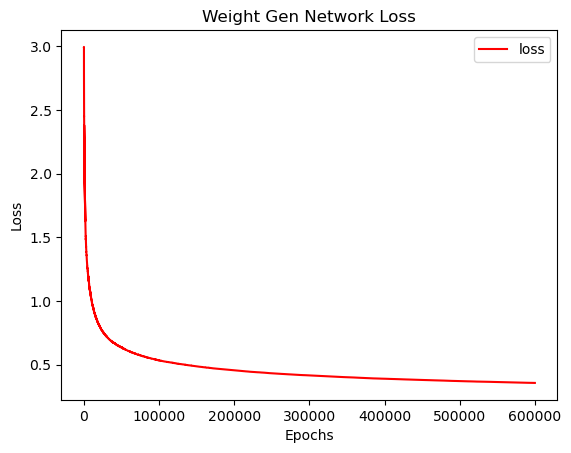

In [145]:
import matplotlib.pyplot as plt

plt.plot(losses, 'r', label='loss')
plt.title('Weight Gen Network Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

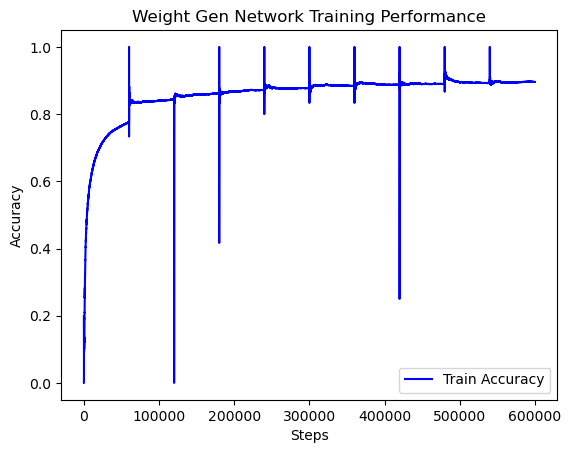

In [146]:
import matplotlib.pyplot as plt

plt.plot(train_accs, 'b', label='Train Accuracy')
plt.title('Weight Gen Network Training Performance')
plt.xlabel('Steps')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

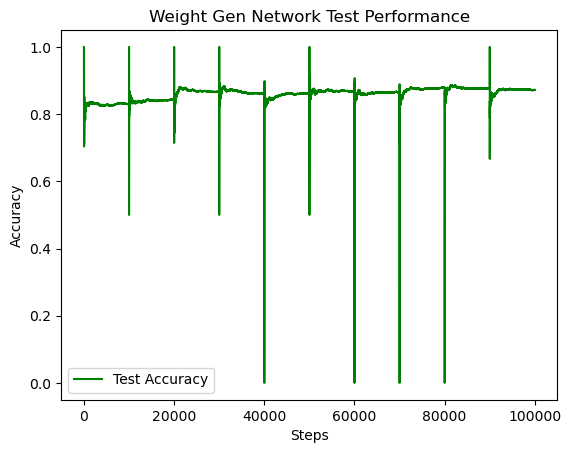

In [147]:
plt.plot(test_accs, 'g', label='Test Accuracy')
plt.title('Weight Gen Network Test Performance')
plt.xlabel('Steps')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [148]:
WGN(x_train[0].reshape(1,784))
WGN.load_weights("EWGNcc_FMnistA.h5")

In [149]:
"""
weights_init = tf.random.uniform((1,num_weights_to_generate))
# Reshape them to the expected shapes for w and b for the outer model.
# Layer 0 kernel.
start_index = 0
w0_shape = (input_dim, 128)
w0_coeffs = weights_init[:, start_index : start_index + np.prod(w0_shape)]
w0 = tf.reshape(w0_coeffs, w0_shape)
start_index += np.prod(w0_shape)
# Layer 0 bias.
b0_shape = (128,)
b0_coeffs = weights_init[:, start_index : start_index + np.prod(b0_shape)]
b0 = tf.reshape(b0_coeffs, b0_shape)
start_index += np.prod(b0_shape)
# Layer 1 kernel.
w1_shape = (128, classes)
w1_coeffs = weights_init[:, start_index : start_index + np.prod(w1_shape)]
w1 = tf.reshape(w1_coeffs, w1_shape)
start_index += np.prod(w1_shape)
# Layer 1 bias.
b1_shape = (classes,)
b1_coeffs = weights_init[:, start_index : start_index + np.prod(b1_shape)]
b1 = tf.reshape(b1_coeffs, b1_shape)
start_index += np.prod(b1_shape)

main_network.layers[0].kernel = w0
main_network.layers[0].bias = b0
main_network.layers[1].kernel = w1
main_network.layers[1].bias = b1
"""

'\nweights_init = tf.random.uniform((1,num_weights_to_generate))\n# Reshape them to the expected shapes for w and b for the outer model.\n# Layer 0 kernel.\nstart_index = 0\nw0_shape = (input_dim, 128)\nw0_coeffs = weights_init[:, start_index : start_index + np.prod(w0_shape)]\nw0 = tf.reshape(w0_coeffs, w0_shape)\nstart_index += np.prod(w0_shape)\n# Layer 0 bias.\nb0_shape = (128,)\nb0_coeffs = weights_init[:, start_index : start_index + np.prod(b0_shape)]\nb0 = tf.reshape(b0_coeffs, b0_shape)\nstart_index += np.prod(b0_shape)\n# Layer 1 kernel.\nw1_shape = (128, classes)\nw1_coeffs = weights_init[:, start_index : start_index + np.prod(w1_shape)]\nw1 = tf.reshape(w1_coeffs, w1_shape)\nstart_index += np.prod(w1_shape)\n# Layer 1 bias.\nb1_shape = (classes,)\nb1_coeffs = weights_init[:, start_index : start_index + np.prod(b1_shape)]\nb1 = tf.reshape(b1_coeffs, b1_shape)\nstart_index += np.prod(b1_shape)\n\nmain_network.layers[0].kernel = w0\nmain_network.layers[0].bias = b0\nmain_networ

In [150]:
#evaluate on testdata
step = 0
test_accs = []
test_losses = []
for tstep, (xt, yt) in enumerate(test_dataset):
    test_loss, test_acc, preds, _, _ = test_step(xt, yt, WGN)
    test_accs.append(test_acc)
tstacc_fn.reset_states()


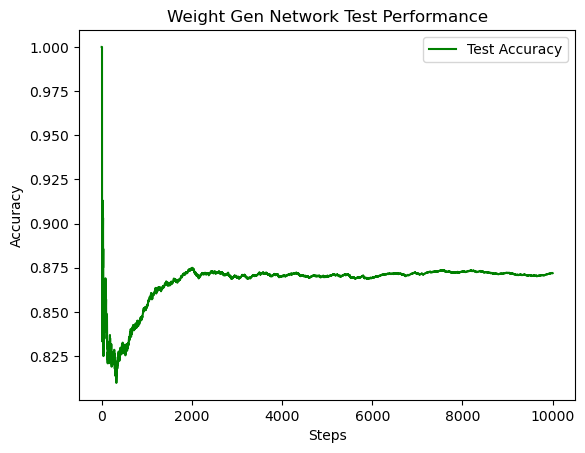

In [151]:
plt.plot(test_accs, 'g', label='Test Accuracy')
plt.title('Weight Gen Network Test Performance')
plt.xlabel('Steps')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [152]:
# Compute the Fisher Information for each parameter in Task A
print('Processing Fisher Information...')
I = ecomputer_fisher_full(WGN, x_train.reshape(60000, 1, 784))
print('Processing Finish!')

Processing Fisher Information...
Processing Finish!


/tmp/ipykernel_29897/3188200143.py:80: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  f_accum = np.asarray(f_accum)/len(imgset)


In [153]:
with open('EWGNcc_FMnistA_Fisher.npy', 'wb') as f:
    np.save(f, I)

In [154]:
print(I)

[<tf.Tensor: shape=(784, 128), dtype=float32, numpy=
 array([[2.3451647e-15, 9.6617133e-04, 2.2450759e-04, ..., 8.1299123e-04,
         2.0779255e-05, 5.8102317e-04],
        [9.9869831e-06, 1.0677119e-03, 1.4438065e-03, ..., 1.8250347e-03,
         4.5288457e-03, 7.1318401e-04],
        [6.2169397e-04, 2.0384132e-03, 1.6783275e-02, ..., 3.4082837e-02,
         1.7974783e-02, 9.9903652e-03],
        ...,
        [1.1912198e+00, 1.2801087e+00, 1.7017216e+01, ..., 1.3802701e+01,
         3.2814602e+01, 2.6341919e+01],
        [5.3453559e-01, 1.0698591e+00, 4.7912655e+00, ..., 3.8758209e+00,
         6.4758635e+00, 7.9152775e+00],
        [8.4021920e-04, 6.1613008e-02, 2.4191687e-01, ..., 3.2515976e-01,
         7.2870129e-01, 1.8557328e-01]], dtype=float32)>
 <tf.Tensor: shape=(128,), dtype=float32, numpy=
 array([ 3261.7546 ,  2108.0337 ,  6224.5493 , 11543.34   ,  6906.8936 ,
         5877.9893 , 15067.69   , 14357.414  ,  7046.3257 ,  4210.461  ,
         7848.938  , 17109.928  ,  833

In [155]:
"""
ewc_strength = 0.0001

kreg = ewc_reg(I[0], WGN.weights[0], Lambda = ewc_strength)
print(kreg(x=WGN_ewcB.weights[0]))
breg = ewc_reg(I[1], WGN.weights[1], Lambda = ewc_strength)
print(kreg(x=WGN_ewcB.weights[1]))

kreg = ewc_reg(I[2], WGN.weights[2], Lambda = ewc_strength)
print(kreg(x=WGN_ewcB.weights[2]))
breg = ewc_reg(I[3], WGN.weights[3], Lambda = ewc_strength)
print(kreg(x=WGN_ewcB.weights[3]))

"""
"""
tf.Tensor(235.743, shape=(), dtype=float32)
tf.Tensor(2993.8042, shape=(), dtype=float32)
tf.Tensor(19218.791, shape=(), dtype=float32)
tf.Tensor(67722.83, shape=(), dtype=float32)
"""

'\ntf.Tensor(235.743, shape=(), dtype=float32)\ntf.Tensor(2993.8042, shape=(), dtype=float32)\ntf.Tensor(19218.791, shape=(), dtype=float32)\ntf.Tensor(67722.83, shape=(), dtype=float32)\n'

In [439]:
# Task B penalty training
ewc_strength = 0.1
# WGN that generates the weights of the `main_network.
WGN_ewcB = keras.Sequential(
    [
        keras.layers.Dense(128, activation=tf.nn.gelu, kernel_regularizer=ewc_reg(I[0], WGN.weights[0], Lambda = ewc_strength),
                 bias_regularizer=ewc_reg(I[1], WGN.weights[1], Lambda = ewc_strength)),
        keras.layers.Dense(num_weights_to_generate, activation=gaussian_activation, kernel_regularizer=ewc_reg(I[2], WGN.weights[2], Lambda = ewc_strength),
                 bias_regularizer=ewc_reg(I[3], WGN.weights[3], Lambda = ewc_strength)),
    ]
)

In [445]:
WGN_ewcB(x_train1[0].reshape(1,784))
WGN_ewcB.load_weights('EWGNcc_FMnistA.h5')

In [446]:
WGN_ewcB.summary()

Model: "sequential_36"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_72 (Dense)             (1, 128)                  100480    
_________________________________________________________________
dense_73 (Dense)             (1, 103060)               13294740  
Total params: 13,395,220
Trainable params: 13,395,220
Non-trainable params: 0
_________________________________________________________________


In [447]:
def ewc_loss(model, fisher_information, old_weights, lambda_ewc):
    ewc_loss_value = 0.0
    for i, weight in enumerate(model.trainable_weights):
        fisher_info = fisher_information[i]
        old_weight = old_weights[i]
        ewc_loss_value += tf.reduce_sum(fisher_info * tf.square(weight - old_weight))
    return lambda_ewc * ewc_loss_value

In [448]:
#@tf.function
def train_step_ewc(x, y, WGNc, step, ada = 1):
    with tf.GradientTape() as tape:
        if step == 0:
            weights_init = tf.random.uniform((1,num_weights_to_generate))
            # Reshape them to the expected shapes for w and b for the outer model.
            # Layer 0 kernel.
            start_index = 0
            w0_shape = (input_dim, 128)
            w0_coeffs = weights_init[:, start_index : start_index + np.prod(w0_shape)]
            w0 = tf.reshape(w0_coeffs, w0_shape)
            start_index += np.prod(w0_shape)
            # Layer 0 bias.
            b0_shape = (128,)
            b0_coeffs = weights_init[:, start_index : start_index + np.prod(b0_shape)]
            b0 = tf.reshape(b0_coeffs, b0_shape)
            start_index += np.prod(b0_shape)
            # Layer 1 kernel.
            w1_shape = (128, classes)
            w1_coeffs = weights_init[:, start_index : start_index + np.prod(w1_shape)]
            w1 = tf.reshape(w1_coeffs, w1_shape)
            start_index += np.prod(w1_shape)
            # Layer 1 bias.
            b1_shape = (classes,)
            b1_coeffs = weights_init[:, start_index : start_index + np.prod(b1_shape)]
            b1 = tf.reshape(b1_coeffs, b1_shape)
            start_index += np.prod(b1_shape)

            main_network.layers[0].kernel = w0
            main_network.layers[0].bias = b0
            main_network.layers[1].kernel = w1
            main_network.layers[1].bias = b1
        
        # Predict weights for the outer model.
        weights_pred = WGNc(x)

        # Reshape them to the expected shapes for w and b for the outer model.
        # Layer 0 kernel.
        start_index = 0
        w0_shape = (input_dim, 128)
        w0_coeffs = weights_pred[:, start_index : start_index + np.prod(w0_shape)]
        w0 = tf.reshape(w0_coeffs, w0_shape)
        start_index += np.prod(w0_shape)
        # Layer 0 bias.
        b0_shape = (128,)
        b0_coeffs = weights_pred[:, start_index : start_index + np.prod(b0_shape)]
        b0 = tf.reshape(b0_coeffs, b0_shape)
        start_index += np.prod(b0_shape)
        # Layer 1 kernel.
        w1_shape = (128, classes)
        w1_coeffs = weights_pred[:, start_index : start_index + np.prod(w1_shape)]
        w1 = tf.reshape(w1_coeffs, w1_shape)
        start_index += np.prod(w1_shape)
        # Layer 1 bias.
        b1_shape = (classes,)
        b1_coeffs = weights_pred[:, start_index : start_index + np.prod(b1_shape)]
        b1 = tf.reshape(b1_coeffs, b1_shape)
        start_index += np.prod(b1_shape)

        
        # Set the weight predictions as the weight variables on the outer model.
        main_network.layers[0].kernel = (1-ada)*main_network.layers[0].kernel + ada*w0
        main_network.layers[0].bias = (1-ada)*main_network.layers[0].bias + ada*b0
        main_network.layers[1].kernel = (1-ada)*main_network.layers[1].kernel + ada*w1
        main_network.layers[1].bias = (1-ada)*main_network.layers[1].bias + ada*b1
        
        # Inference on the outer model.
        preds = main_network(x)
        ploss = loss_fn(y, preds)
        eloss = ewc_loss(WGNc, I, WGN.trainable_weights, lambda_ewc=0.5)
        total_loss = ploss + eloss

    # update accuracy.
    acc_fn.update_state(y, preds)
    train_acc = acc_fn.result()
    # Train only inner model.    
    grads = tape.gradient(total_loss, WGNc.trainable_weights)
    optimizer.apply_gradients(zip(grads, WGNc.trainable_weights))
    return ploss, eloss, total_loss, train_acc

In [449]:
#optimizer = tf.keras.optimizers.Adam(learning_rate= 0.00025, decay = 0.95)
optimizer = tf.keras.optimizers.Adam(learning_rate= 0.005, decay = 0.015)
#optimizer = tf.keras.optimizers.RMSprop(learning_rate= 0.001, decay = 0.5)

plosses = []  # Keep track of the losses over time.
elosses = []
tlosses = []
train_accs = []
test_accs = []
test_accs1 = []

#main_network.compile(loss=loss_fn, optimizer=optimizer, metrics=acc_fn)
epochs = 10
for i in range(epochs):
    for step, (x, y) in enumerate(train_dataset1):
        ploss, eloss, tloss, train_acc = train_step_ewc(x, y, WGN_ewcB, step)
    
        # Logging.
        plosses.append(float(ploss))
        elosses.append(float(eloss))
        tlosses.append(float(tloss))
        train_accs.append(train_acc)

        if step%10000 == 0:
            print("Epochs:", i, "Step in progress:", step)
            
    
    acc_fn.reset_states()

    #evaluate on testdata
    for tstep, (xt, yt) in enumerate(test_dataset1):
        test_loss, test_acc, preds, _, _ = test_step(xt, yt, WGN_ewcB)
        test_accs1.append(test_acc)
    tstacc_fn.reset_states()
    
    print("Epochs:", i, "Step:", step, "Train Loss:", sum(tlosses) / len(tlosses), "Train Acc:", train_acc, "Test Acc:", test_acc)
    #evaluate on testdata
    for tstep, (xt, yt) in enumerate(test_dataset):
        test_loss, test_acc, preds, _, _ = test_step(xt, yt, WGN_ewcB)
        test_accs.append(test_acc)
    tstacc_fn.reset_states()
    
    print("Epochs:", i, "Step:", step, "Train Loss:", sum(tlosses) / len(tlosses), "Train Acc:", train_acc, "Test Acc:", test_acc)

   
   

Epochs: 0 Step in progress: 0
Epochs: 0 Step in progress: 10000
Epochs: 0 Step in progress: 20000
Epochs: 0 Step in progress: 30000
Epochs: 0 Step in progress: 40000
Epochs: 0 Step in progress: 50000
Epochs: 0 Step: 59999 Train Loss: 3.306612155208737 Train Acc: tf.Tensor(0.53643245, shape=(), dtype=float32) Test Acc: tf.Tensor(0.5475, shape=(), dtype=float32)
Epochs: 0 Step: 59999 Train Loss: 3.306612155208737 Train Acc: tf.Tensor(0.53643245, shape=(), dtype=float32) Test Acc: tf.Tensor(0.7621, shape=(), dtype=float32)
Epochs: 1 Step in progress: 0
Epochs: 1 Step in progress: 10000
Epochs: 1 Step in progress: 20000
Epochs: 1 Step in progress: 30000
Epochs: 1 Step in progress: 40000
Epochs: 1 Step in progress: 50000
Epochs: 1 Step: 59999 Train Loss: 2.560171020440757 Train Acc: tf.Tensor(0.5555, shape=(), dtype=float32) Test Acc: tf.Tensor(0.5775, shape=(), dtype=float32)
Epochs: 1 Step: 59999 Train Loss: 2.560171020440757 Train Acc: tf.Tensor(0.5555, shape=(), dtype=float32) Test Acc:

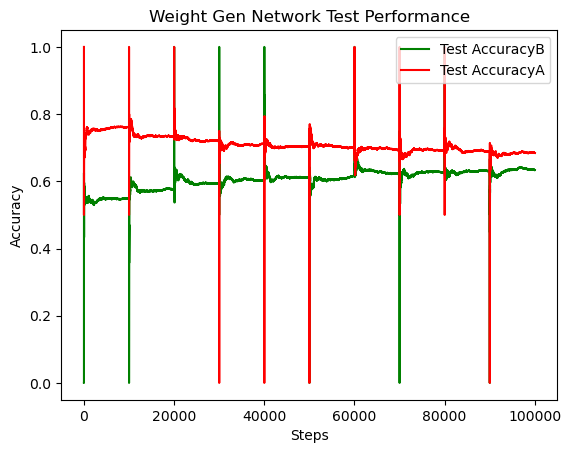

In [450]:
plt.plot(test_accs1, 'g', label='Test AccuracyB')
plt.plot(test_accs, 'r', label='Test AccuracyA')
plt.title('Weight Gen Network Test Performance')
plt.xlabel('Steps')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [451]:
#savemodel
plosses = np.cumsum(np.asarray(plosses))/range(1,len(plosses)+1)
elosses = np.cumsum(np.asarray(elosses))/range(1,len(elosses)+1)
tlosses = np.cumsum(np.asarray(tlosses))/range(1,len(tlosses)+1)

WGN_ewcB.save("EWGNcc_MnistB.h5")
with open('EWGNcc_MnistB_plosses.npy', 'wb') as f:
    np.save(f, plosses)
with open('EWGNcc_MnistB_elosses.npy', 'wb') as f:
    np.save(f, elosses)
with open('EWGNcc_MnistB_tlosses.npy', 'wb') as f:
    np.save(f, tlosses)
    
with open('EWGNcc_MnistB_tracc.npy', 'wb') as f:
    np.save(f, np.array(train_accs))
with open('EWGNcc_MnistB_tstacc.npy', 'wb') as f:
    np.save(f, np.array(test_accs))
with open('EWGNcc_MnistB_tstacc1.npy', 'wb') as f:
    np.save(f, np.array(test_accs1))

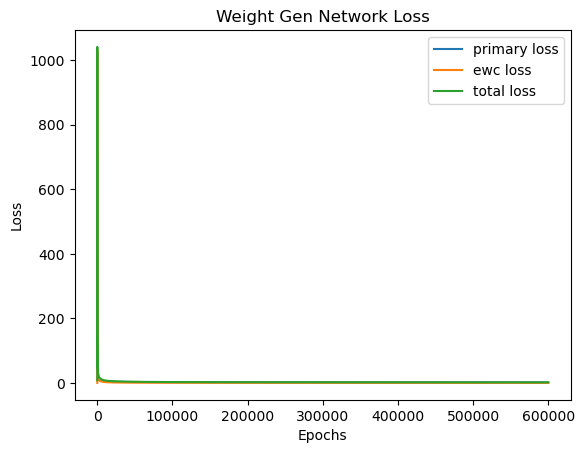

In [452]:
import matplotlib.pyplot as plt

plt.plot(plosses, label='primary loss')
plt.plot(elosses, label='ewc loss')
plt.plot(tlosses, label='total loss')
plt.title('Weight Gen Network Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [453]:
# Task B no penalty training
# WGN that generates the weights of the `main_network.
WGN_NoP_B = keras.Sequential(
    [
        keras.layers.Dense(128, activation=tf.nn.gelu),
        keras.layers.Dense(num_weights_to_generate, activation=gaussian_activation),
    ]
)

In [454]:
WGN_NoP_B(x_train1[0].reshape(1,784))
WGN_NoP_B.load_weights('EWGNcc_FMnistA.h5')

optimizer = tf.keras.optimizers.Adam()

losses = []  # Keep track of the losses over time.
train_accs = []
test_accs = []
test_accs1 = []

#main_network.compile(loss=loss_fn, optimizer=optimizer, metrics=acc_fn)
epochs = 10
for i in range(epochs):
    for step, (x, y) in enumerate(train_dataset1):
        loss, train_acc = train_step(x, y, WGN_NoP_B, step)
    
        # Logging.
        losses.append(float(loss))
        train_accs.append(train_acc)

        if step%10000 == 0:
            print("Epochs:", i, "Step in progress:", step)
    
    acc_fn.reset_states()

    #evaluate on testdata
    for tstep, (xt, yt) in enumerate(test_dataset1):
        test_loss, test_acc1, preds, _, _ = test_step(xt, yt, WGN_NoP_B)
        test_accs1.append(test_acc)
    tstacc_fn.reset_states()
    
    print("Epochs:", i, "Step:", step, "Train Loss:", sum(losses) / len(losses), "Train Acc:", train_acc, "Test Acc:", test_acc)
    #evaluate on testdata
    for tstep, (xt, yt) in enumerate(test_dataset):
        test_loss, test_acc, preds, _, _ = test_step(xt, yt, WGN_NoP_B)
        test_accs.append(test_acc)
    tstacc_fn.reset_states()
    
    print("Epochs:", i, "Step:", step, "Train Loss:", sum(losses) / len(losses), "Train Acc:", train_acc, "Test Acc:", test_acc)
   

Epochs: 0 Step in progress: 0
Epochs: 0 Step in progress: 10000
Epochs: 0 Step in progress: 20000
Epochs: 0 Step in progress: 30000
Epochs: 0 Step in progress: 40000
Epochs: 0 Step in progress: 50000
Epochs: 0 Step: 59999 Train Loss: 2.0606714608041012 Train Acc: tf.Tensor(0.36506668, shape=(), dtype=float32) Test Acc: tf.Tensor(0.6846, shape=(), dtype=float32)
Epochs: 0 Step: 59999 Train Loss: 2.0606714608041012 Train Acc: tf.Tensor(0.36506668, shape=(), dtype=float32) Test Acc: tf.Tensor(0.0, shape=(), dtype=float32)
Epochs: 1 Step in progress: 0
Epochs: 1 Step in progress: 10000
Epochs: 1 Step in progress: 20000
Epochs: 1 Step in progress: 30000
Epochs: 1 Step in progress: 40000
Epochs: 1 Step in progress: 50000
Epochs: 1 Step: 59999 Train Loss: 1.1515045209858692 Train Acc: tf.Tensor(0.9285667, shape=(), dtype=float32) Test Acc: tf.Tensor(0.0, shape=(), dtype=float32)
Epochs: 1 Step: 59999 Train Loss: 1.1515045209858692 Train Acc: tf.Tensor(0.9285667, shape=(), dtype=float32) Test 

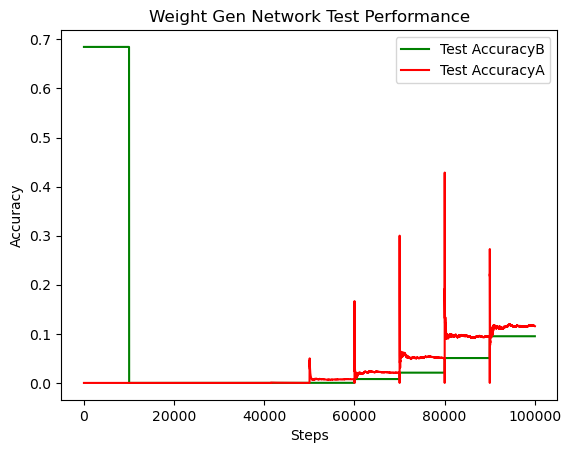

In [455]:
plt.plot(test_accs1, 'g', label='Test AccuracyB')
plt.plot(test_accs, 'r', label='Test AccuracyA')
plt.title('Weight Gen Network Test Performance')
plt.xlabel('Steps')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [456]:
#savemodel
losses = np.cumsum(np.asarray(losses))/range(1,len(losses)+1)
WGN_NoP_B.save("EWGNcc_MnistNoB.h5")
with open('EWGNcc_MnistNoB_losses.npy', 'wb') as f:
    np.save(f, losses)
    
with open('EWGNcc_MnistNoB_tracc.npy', 'wb') as f:
    np.save(f, np.array(train_accs))
with open('EWGNcc_MnistNoB_tstacc.npy', 'wb') as f:
    np.save(f, np.array(test_accs))
with open('EWGNcc_MnistNoB_tstacc1.npy', 'wb') as f:
    np.save(f, np.array(test_accs1))

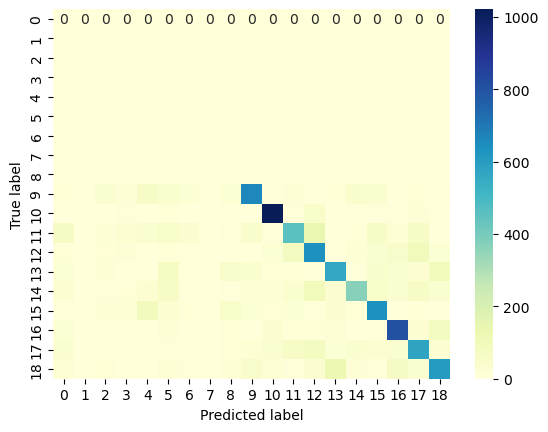

In [457]:
import pandas as pd
import seaborn as sns
from sklearn.metrics import accuracy_score, confusion_matrix

#Current Task B Perfomrance Evals
dataset = test_dataset1
preds = []
weight_preds = []
lyrpreds = []
y_test_true = []
x_test_true = []

for tstep, (xt, yt) in enumerate(dataset):
    x_test_true.append(xt)
    y_test_true.append(yt)
    _, _, pred, lyr, weight_pred = test_step(xt, yt, WGN_ewcB)
    preds.append(pred)
    weight_preds.append(weight_pred)
    lyrpreds.append(lyr)
tstacc_fn.reset_states()

y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
B_EWC = accuracy_score(y_test_arg, y_pred )

#confusionmat
cm = confusion_matrix(y_test_arg, y_pred)

plt.figure()
sns.heatmap(cm, fmt = 'd' , cmap="YlGnBu",  annot=True)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()



In [458]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

avg = None

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "micro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\n\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "macro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "weighted"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)


Averging =  None 
accuracy =  0.6335 
precision =  [0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.77012835 0.87650086 0.65665236
 0.59887006 0.70927318 0.72070312 0.70949721 0.76981853 0.62813522
 0.69415808] 
recall =  [0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.67346939 0.90044053 0.44476744
 0.62970297 0.57637475 0.41367713 0.66283925 0.78404669 0.59137577
 0.60059465] 
f1 score =  [0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.71856287 0.88830943 0.53032929
 0.61389961 0.63595506 0.52564103 0.68537507 0.77686747 0.60920148
 0.64399575]

classwise metrics =  (array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.77012835,
       0.87650086, 0.65665236, 0.59887006, 0.70927318, 0.72070312,
       0.70949721, 0.76981853, 0.62813522, 0.69415808]), array([0.        , 0.    

/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9

<Axes: >

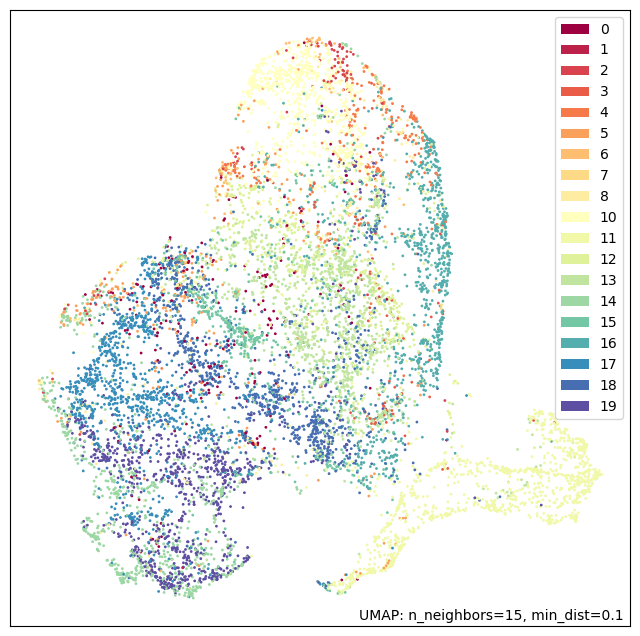

In [459]:
import umap
import umap.plot

sz=10000

imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

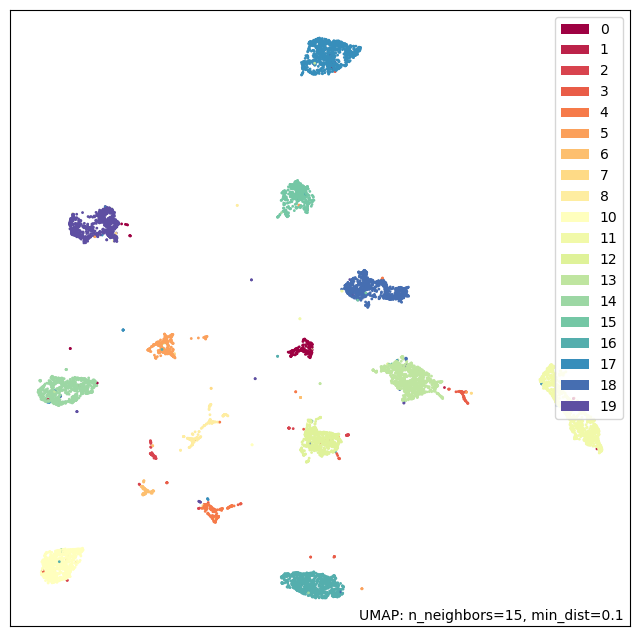

In [460]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

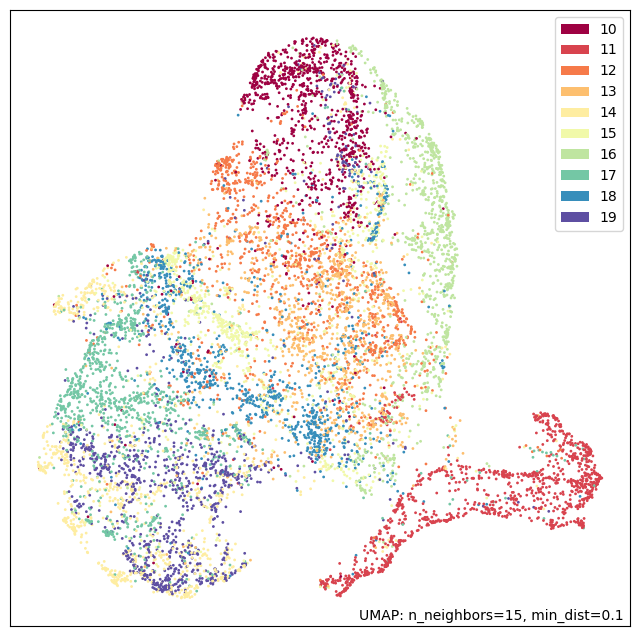

In [461]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

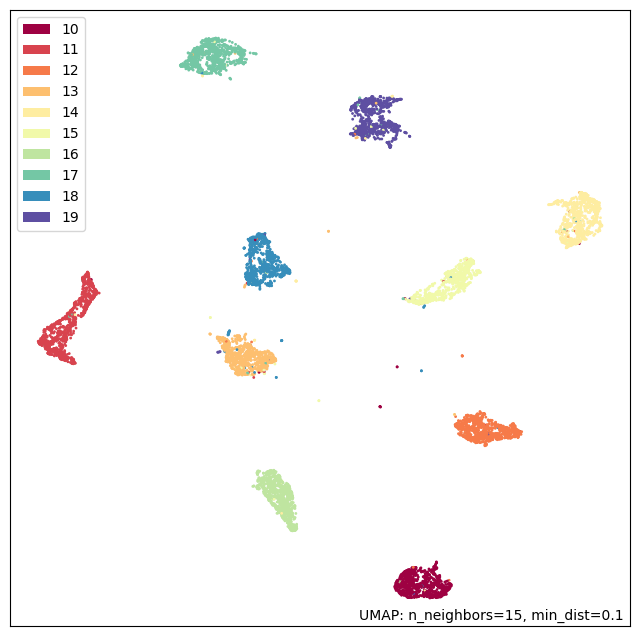

In [462]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

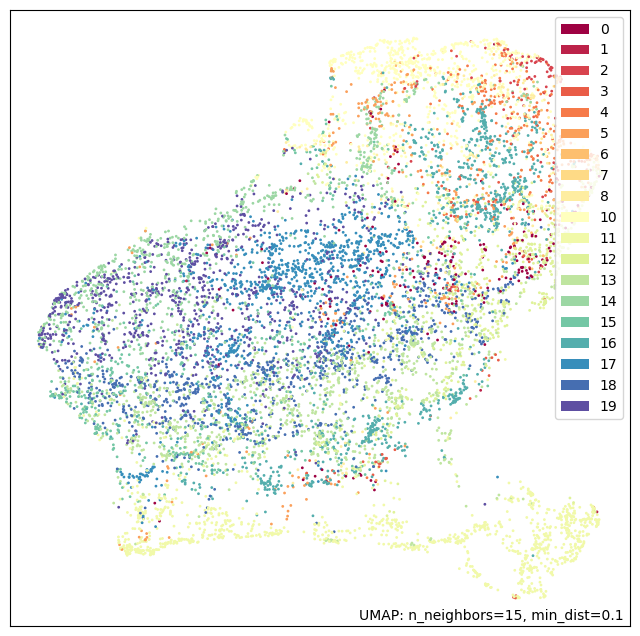

In [463]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

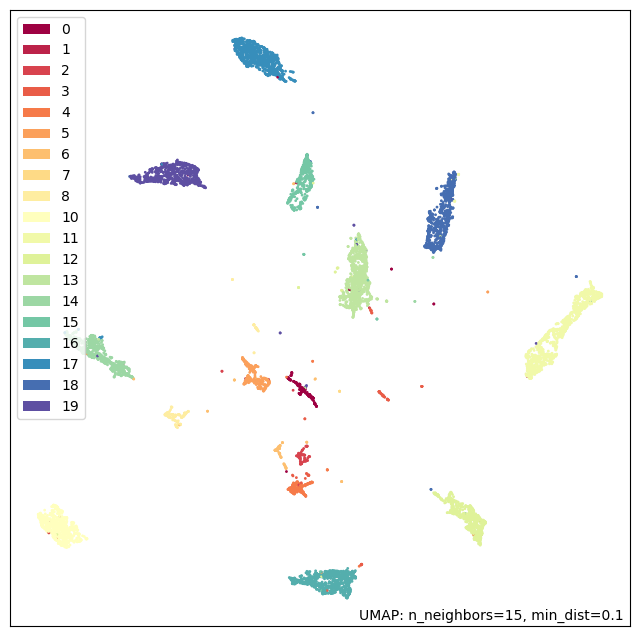

In [464]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

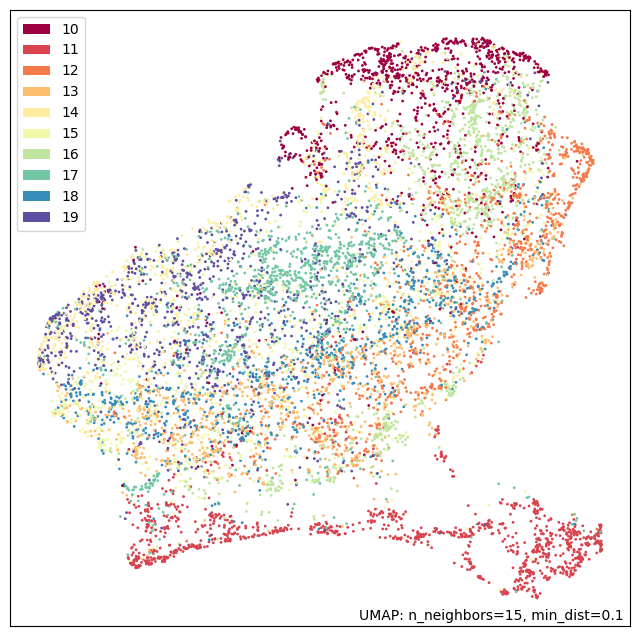

In [465]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

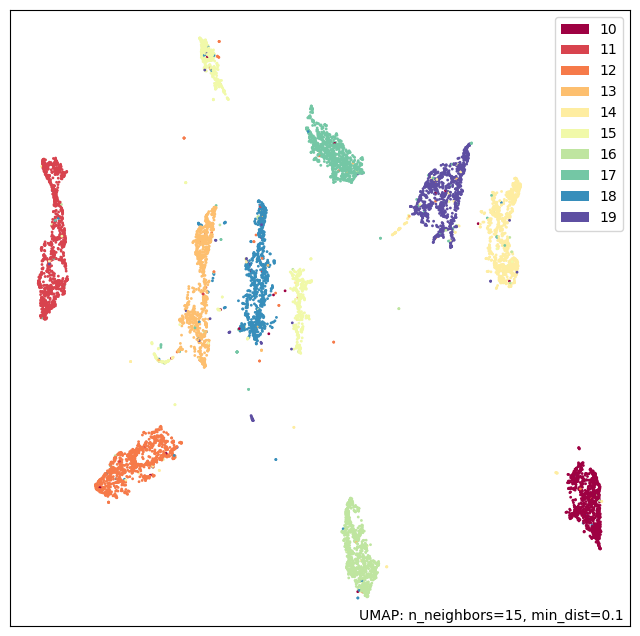

In [466]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

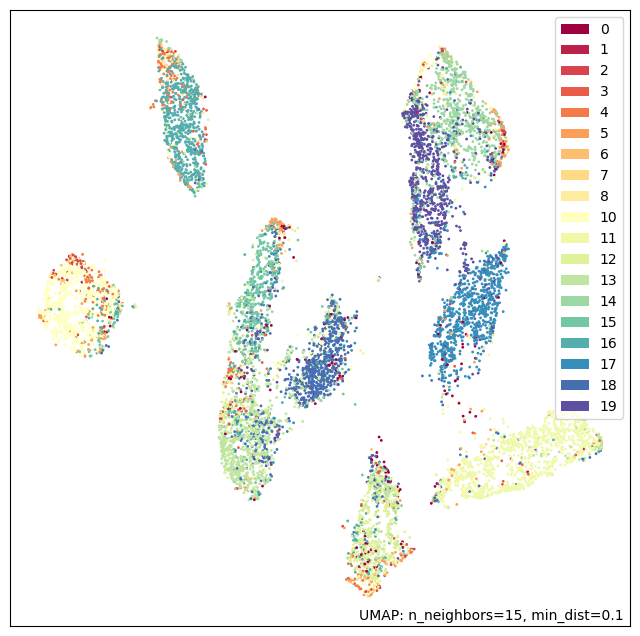

In [467]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

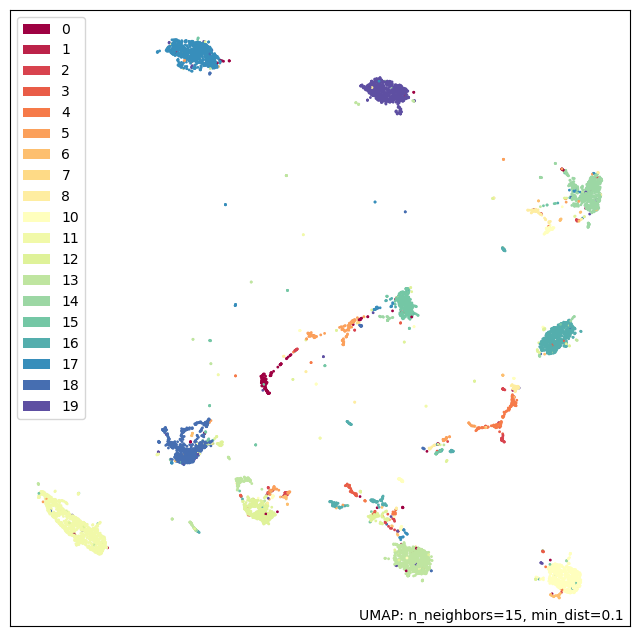

In [468]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

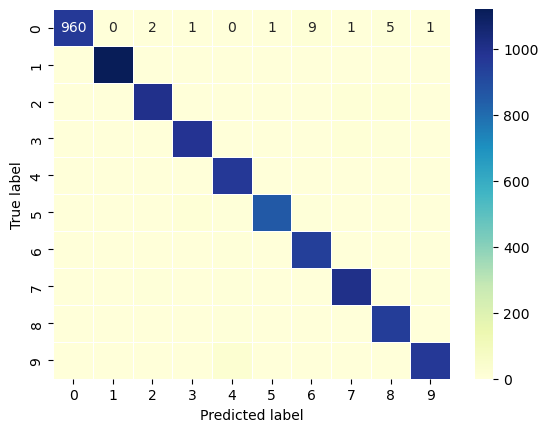

In [469]:
#Current Task B Perfomrance Evals
#Current Task B Perfomrance Evals
dataset = test_dataset1
preds = []
weight_preds = []
lyrpreds = []
y_test_true = []
x_test_true = []

for tstep, (xt, yt) in enumerate(dataset):
    x_test_true.append(xt)
    y_test_true.append(yt)
    _, _, pred, lyr, weight_pred = test_step(xt, yt, WGN_NoP_B)
    preds.append(pred)
    weight_preds.append(weight_pred)
    lyrpreds.append(lyr)
tstacc_fn.reset_states()

y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
B_No_P = accuracy_score(y_test_arg, y_pred )

#confusionmat
cm = confusion_matrix(y_test_arg, y_pred)

plt.figure()
sns.heatmap(cm, fmt = 'd' , cmap="YlGnBu",  annot=True, linewidths=.5)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

In [470]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

avg = None

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "micro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\n\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "macro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "weighted"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)


Averging =  None 
accuracy =  0.975 
precision =  [0.98969072 0.99379433 0.98037291 0.97810945 0.94433594 0.98281787
 0.96817248 0.96814672 0.96544715 0.9787234 ] 
recall =  [0.97959184 0.9876652  0.96802326 0.97326733 0.98472505 0.96188341
 0.98434238 0.97568093 0.97535934 0.95738355] 
f1 score =  [0.98461538 0.99072028 0.97415895 0.97568238 0.96410768 0.97223796
 0.97619048 0.97189922 0.97037794 0.96793587]

classwise metrics =  (array([0.98969072, 0.99379433, 0.98037291, 0.97810945, 0.94433594,
       0.98281787, 0.96817248, 0.96814672, 0.96544715, 0.9787234 ]), array([0.97959184, 0.9876652 , 0.96802326, 0.97326733, 0.98472505,
       0.96188341, 0.98434238, 0.97568093, 0.97535934, 0.95738355]), array([0.98461538, 0.99072028, 0.97415895, 0.97568238, 0.96410768,
       0.97223796, 0.97619048, 0.97189922, 0.97037794, 0.96793587]), array([ 980, 1135, 1032, 1010,  982,  892,  958, 1028,  974, 1009]))

Averging =  micro 

accuracy =  0.975 
precision =  0.975 
recall =  0.975 
f1 score 

<Axes: >

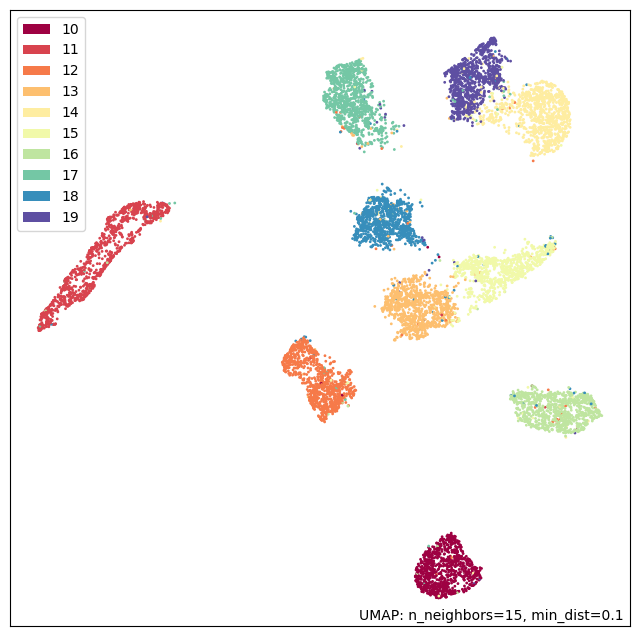

In [471]:
import umap
import umap.plot

sz=10000

imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

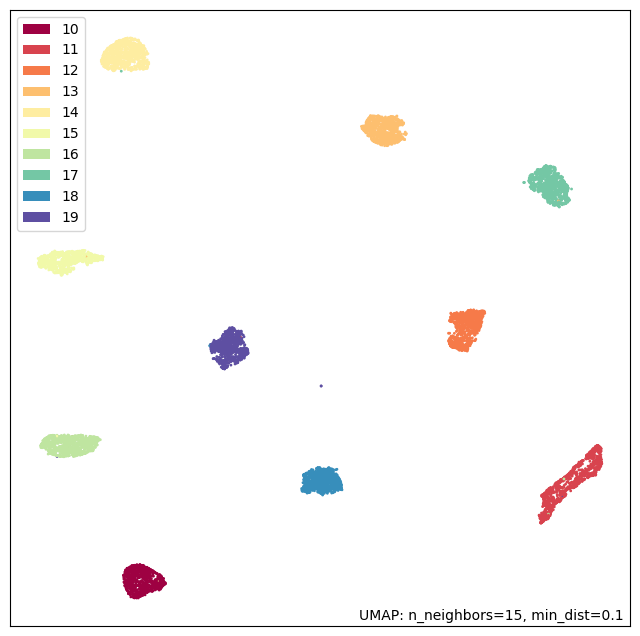

In [472]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

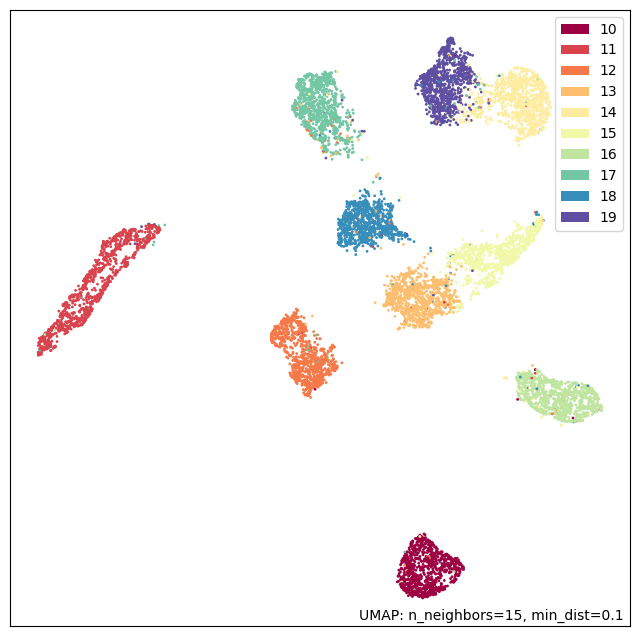

In [473]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

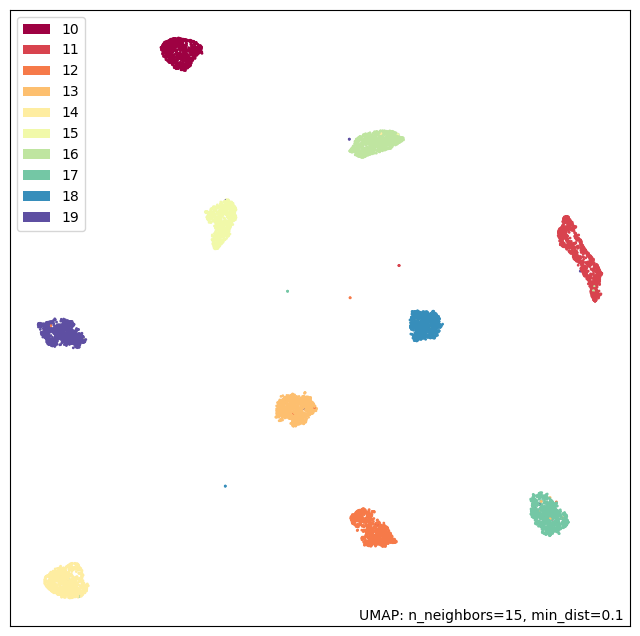

In [474]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

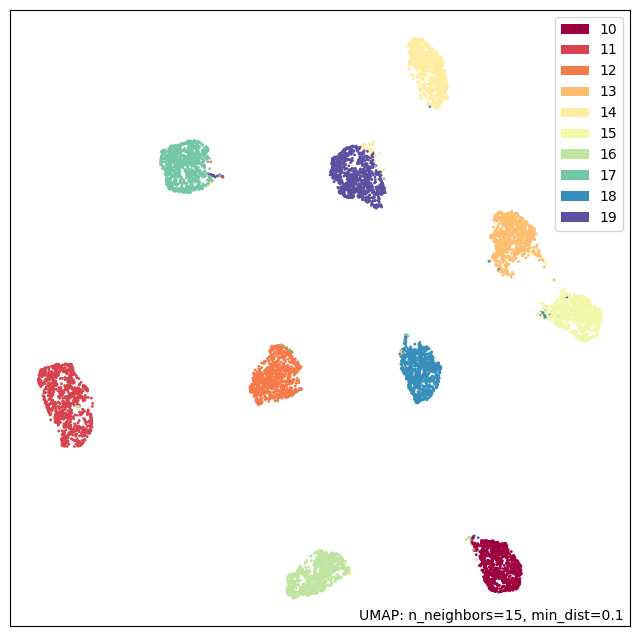

In [475]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

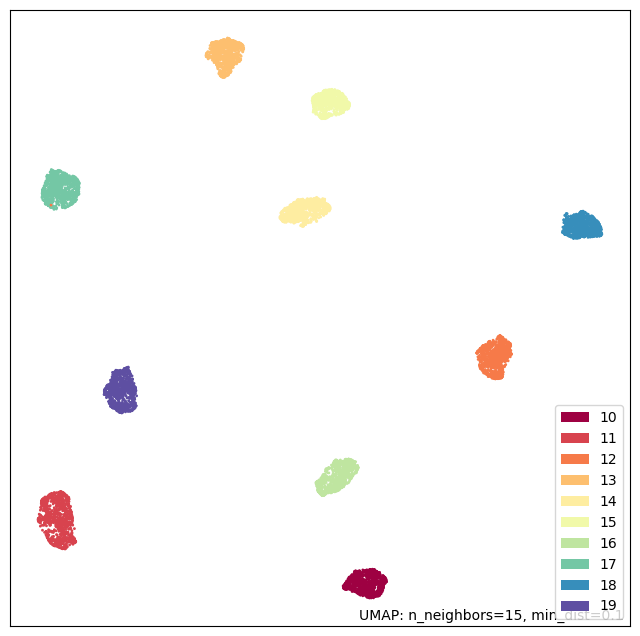

In [476]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

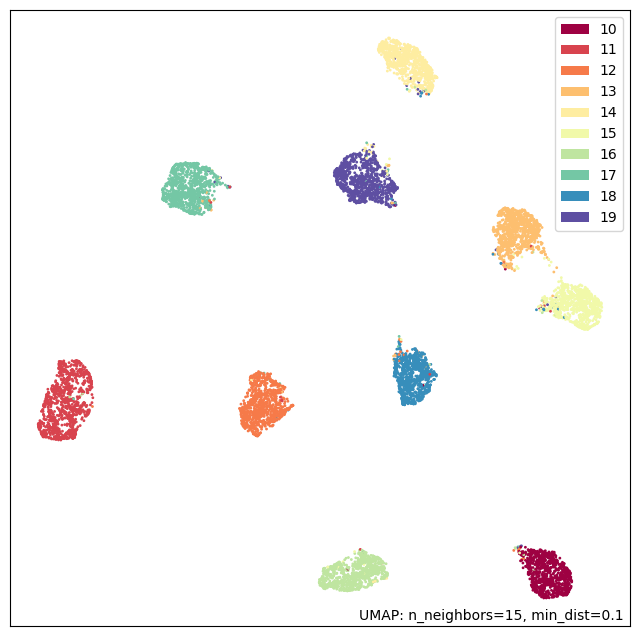

In [477]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

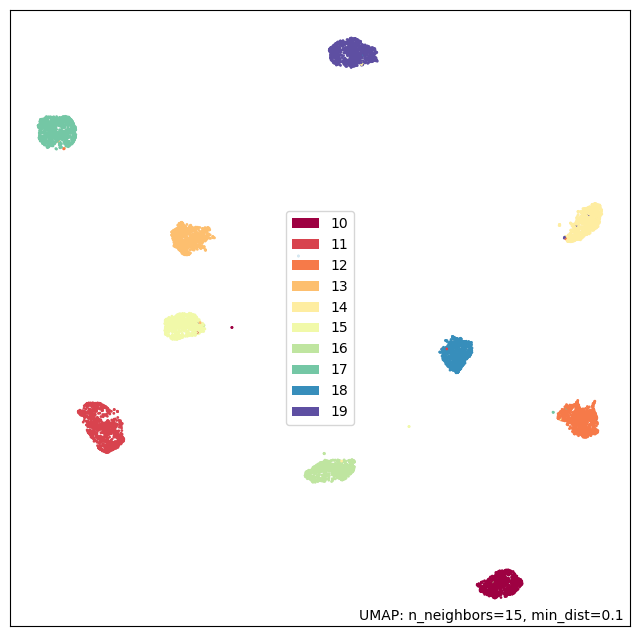

In [478]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

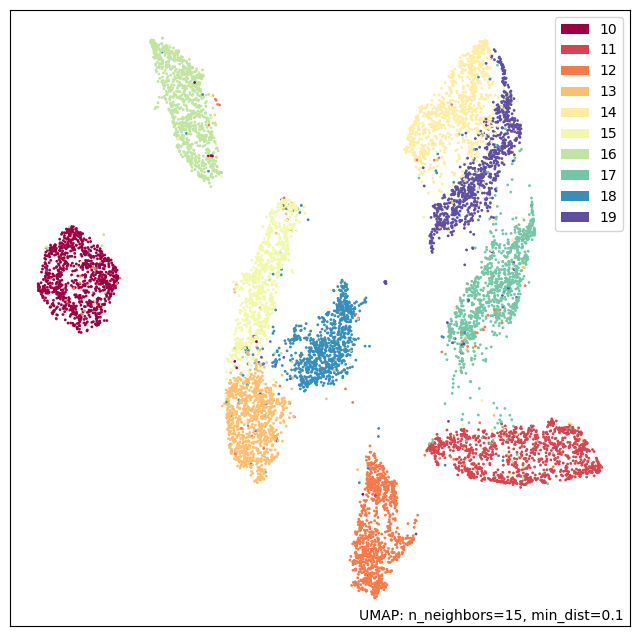

In [479]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

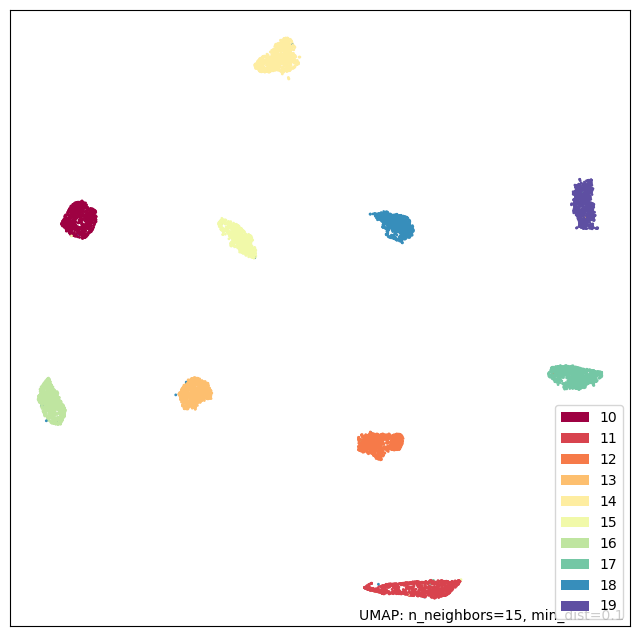

In [480]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

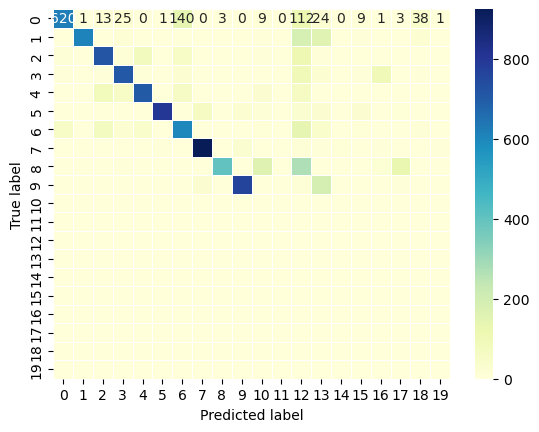

In [481]:
#Previous Task A Perfomrance Evals

dataset = test_dataset
preds = []
weight_preds = []
lyrpreds = []
y_test_true = []
x_test_true = []

for tstep, (xt, yt) in enumerate(dataset):
    x_test_true.append(xt)
    y_test_true.append(yt)
    _, _, pred, lyr, weight_pred = test_step(xt, yt, WGN_ewcB)
    preds.append(pred)
    weight_preds.append(weight_pred)
    lyrpreds.append(lyr)
tstacc_fn.reset_states()

y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
A_EWC = accuracy_score(y_test_arg, y_pred )

#confusionmat
y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
cm = confusion_matrix(y_test_arg, y_pred)

plt.figure()
sns.heatmap(cm, fmt = 'd' , cmap="YlGnBu",  annot=True, linewidths=.5)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

In [482]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

avg = None

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "micro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\n\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "macro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "weighted"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)


Averging =  None 
accuracy =  0.6846 
precision =  [0.8908046  0.99185668 0.80583614 0.83707202 0.84254808 0.99256506
 0.6803653  0.9049951  0.97815534 0.93406593 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.        ] 
recall =  [0.62  0.609 0.718 0.709 0.701 0.801 0.596 0.924 0.403 0.765 0.    0.
 0.    0.    0.    0.    0.    0.    0.    0.   ] 
f1 score =  [0.73113208 0.75464684 0.75938657 0.76773146 0.76528384 0.8865523
 0.63539446 0.91439881 0.57082153 0.8411215  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.        ]

classwise metrics =  (array([0.8908046 , 0.99185668, 0.80583614, 0.83707202, 0.84254808,
       0.99256506, 0.6803653 , 0.9049951 , 0.97815534, 0.93406593,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ]), array([0.62 , 0.609, 0.718, 0.709, 0.701, 0.801, 0.596, 0.924, 0.403,
       0.765, 0.   , 0. 

/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9

<Axes: >

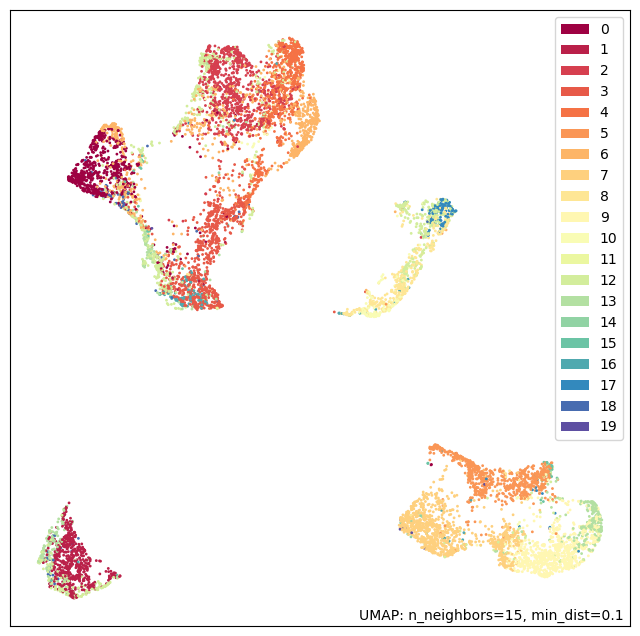

In [483]:
import umap
import umap.plot

sz=10000

imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

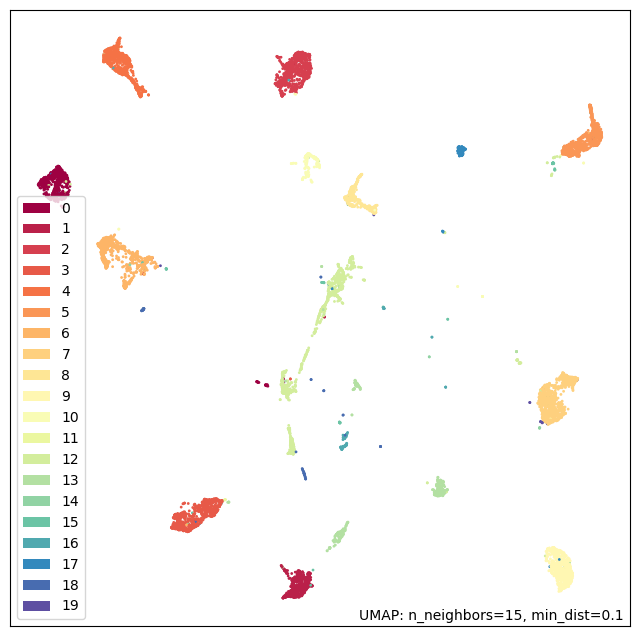

In [484]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

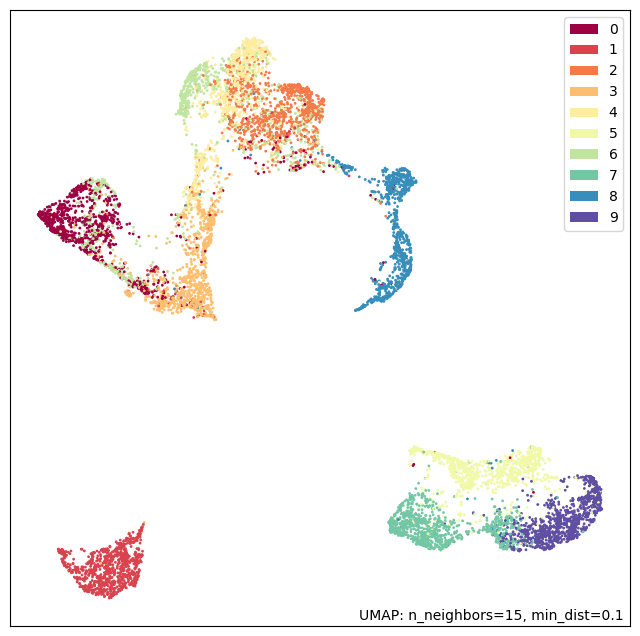

In [485]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

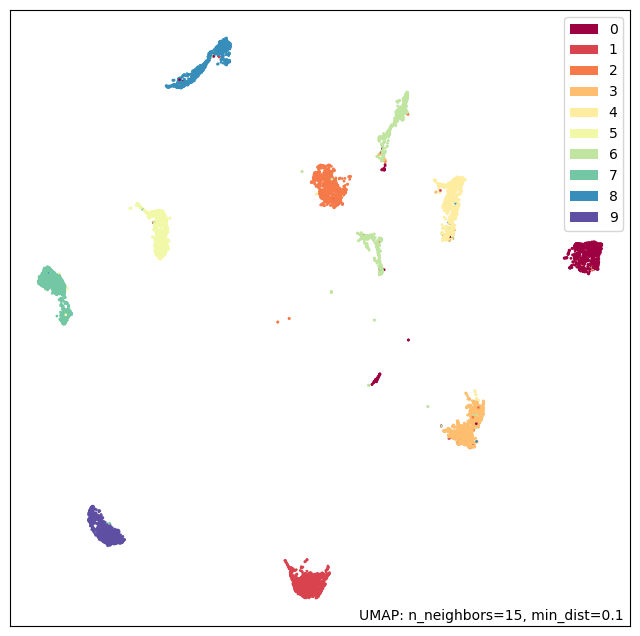

In [486]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

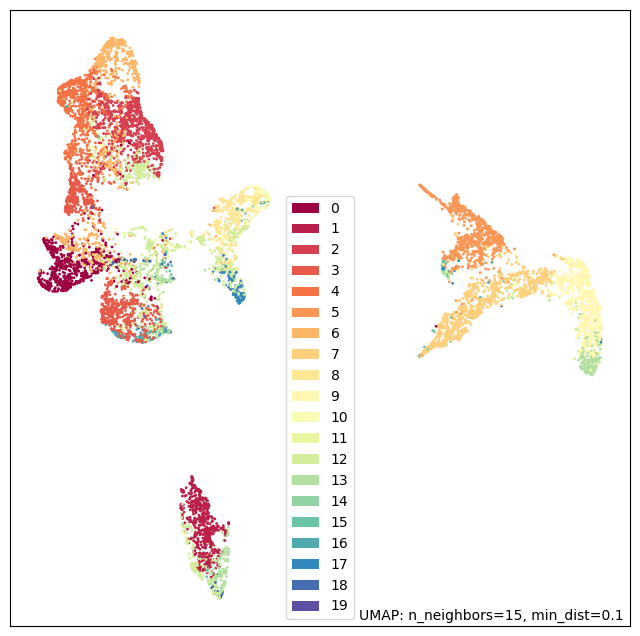

In [487]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

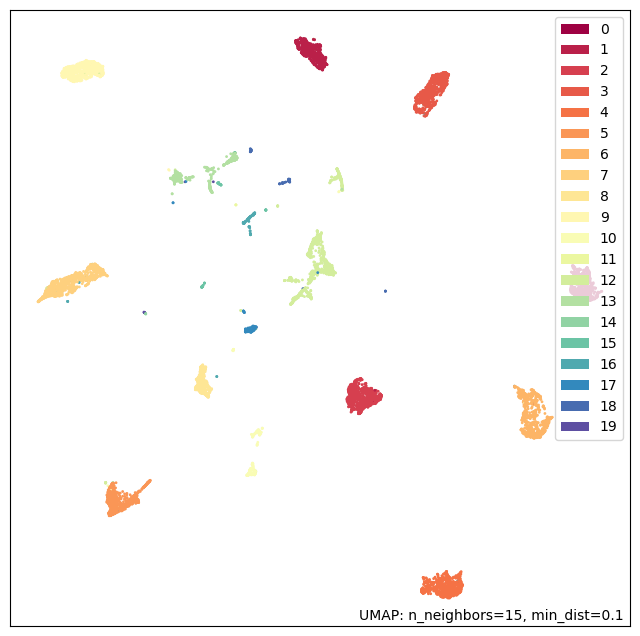

In [488]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

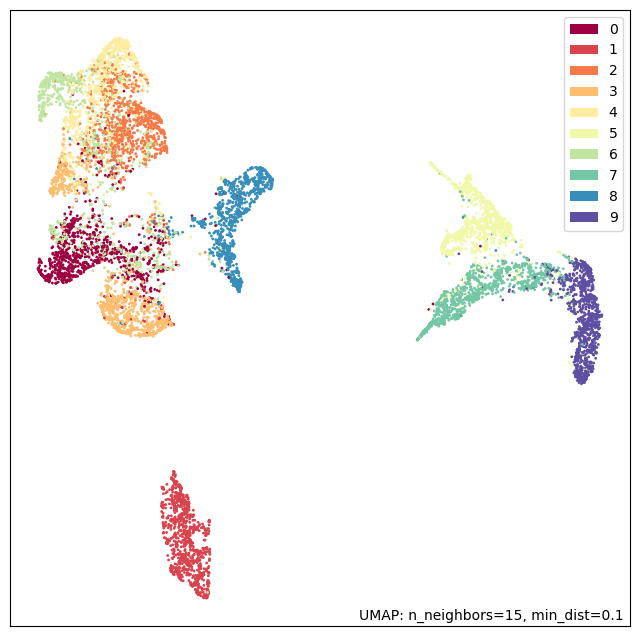

In [489]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

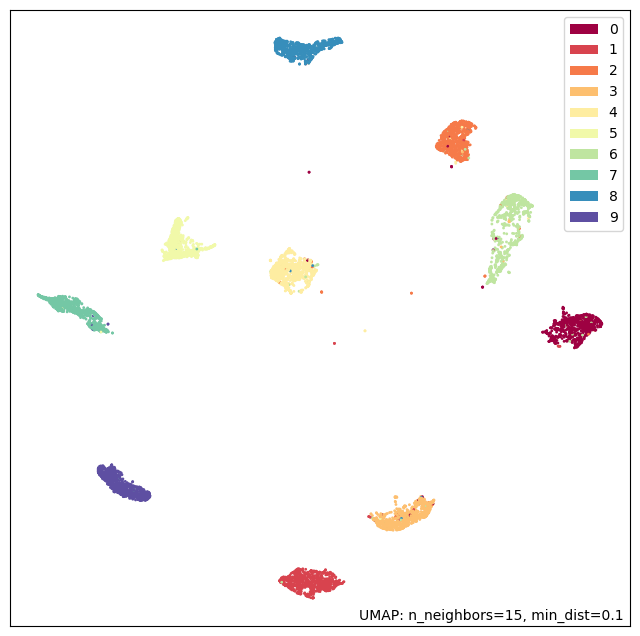

In [490]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

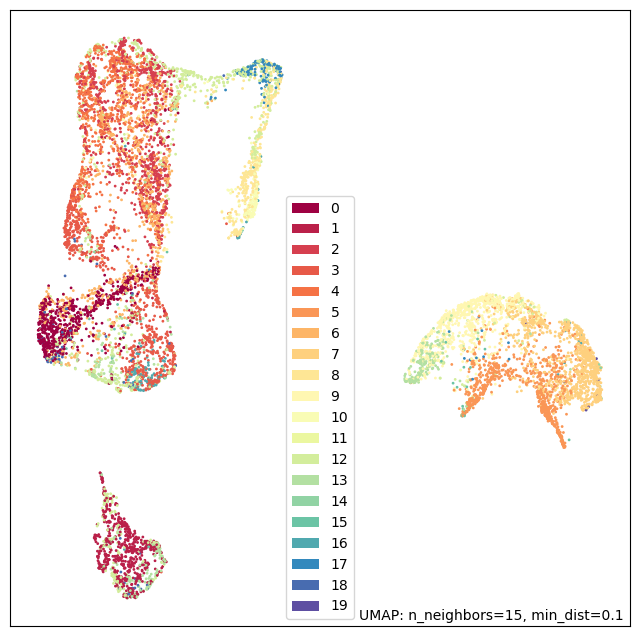

In [491]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

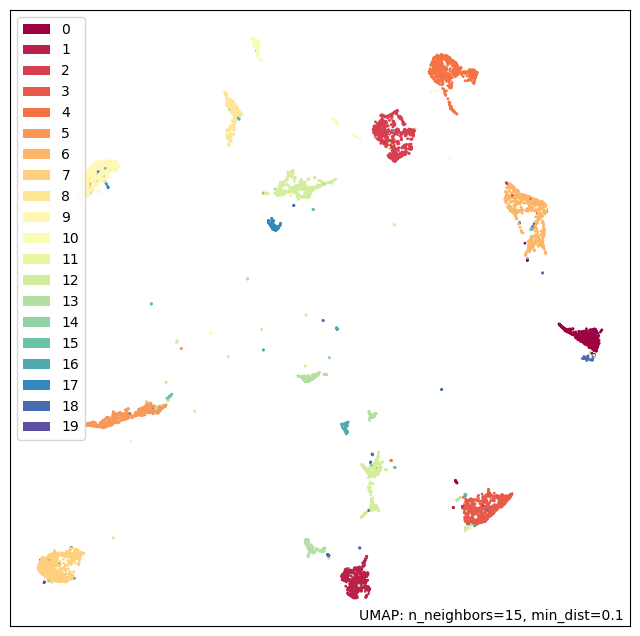

In [492]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

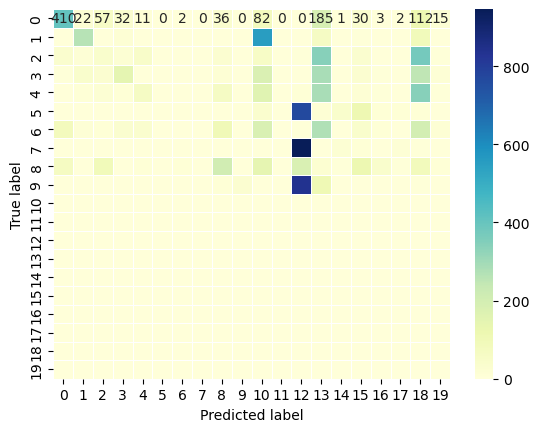

In [493]:
#Previous Task A  Perfomrance Evals

dataset = test_dataset
preds = []
weight_preds = []
lyrpreds = []
y_test_true = []
x_test_true = []

for tstep, (xt, yt) in enumerate(dataset):
    x_test_true.append(xt)
    y_test_true.append(yt)
    _, _, pred, lyr, weight_pred = test_step(xt, yt, WGN_NoP_B)
    preds.append(pred)
    weight_preds.append(weight_pred)
    lyrpreds.append(lyr)
tstacc_fn.reset_states()

y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
A_No_P = accuracy_score(y_test_arg, y_pred )

#confusionmat
y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
cm = confusion_matrix(y_test_arg, y_pred)

plt.figure()
sns.heatmap(cm, fmt = 'd' , cmap="YlGnBu",  annot=True, linewidths=.5)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

In [494]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

avg = None

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "micro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\n\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "macro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "weighted"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)


Averging =  None 
accuracy =  0.1157 
precision =  [0.67656766 0.7320442  0.16       0.56589147 0.38011696 0.
 0.         0.         0.44251627 0.96428571 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.        ] 
recall =  [0.41  0.265 0.04  0.146 0.065 0.    0.    0.    0.204 0.027 0.    0.
 0.    0.    0.    0.    0.    0.    0.    0.   ] 
f1 score =  [0.51058531 0.38913363 0.064      0.23211447 0.11101623 0.
 0.         0.         0.27926078 0.05252918 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.        ]

classwise metrics =  (array([0.67656766, 0.7320442 , 0.16      , 0.56589147, 0.38011696,
       0.        , 0.        , 0.        , 0.44251627, 0.96428571,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ]), array([0.41 , 0.265, 0.04 , 0.146, 0.065, 0.   , 0.   , 0.   , 0.204,
       0.027, 0.   , 0.   , 0.   , 0.  

/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anacond

<Axes: >

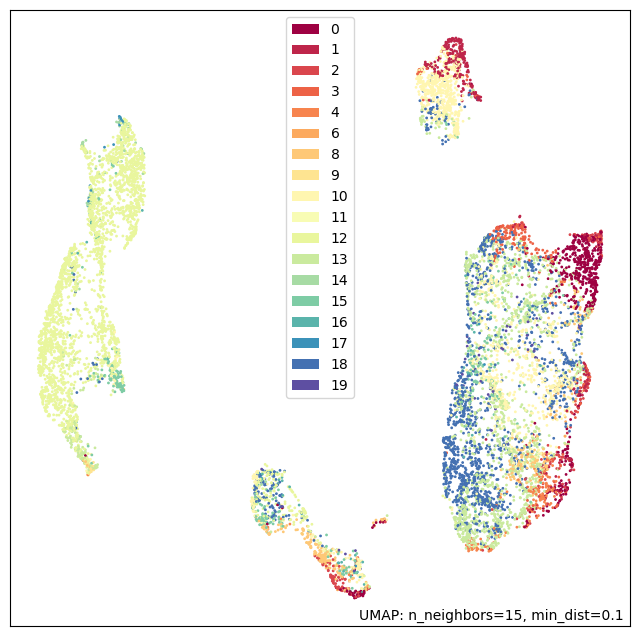

In [495]:
import umap
import umap.plot

sz=10000

imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

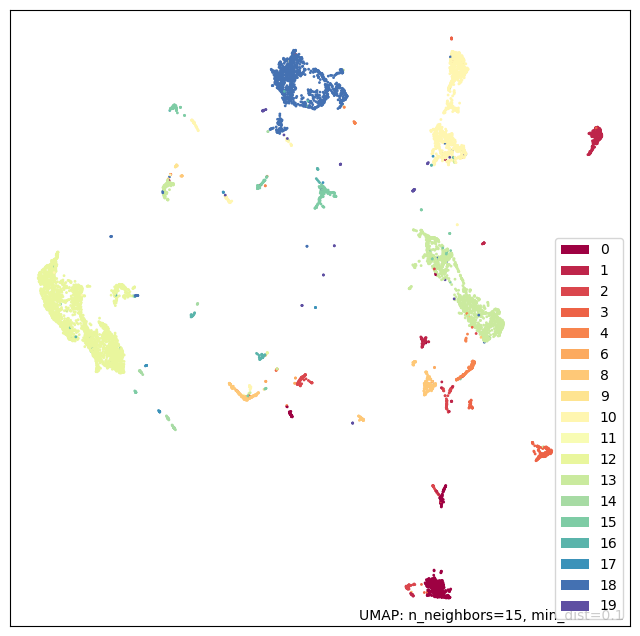

In [496]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

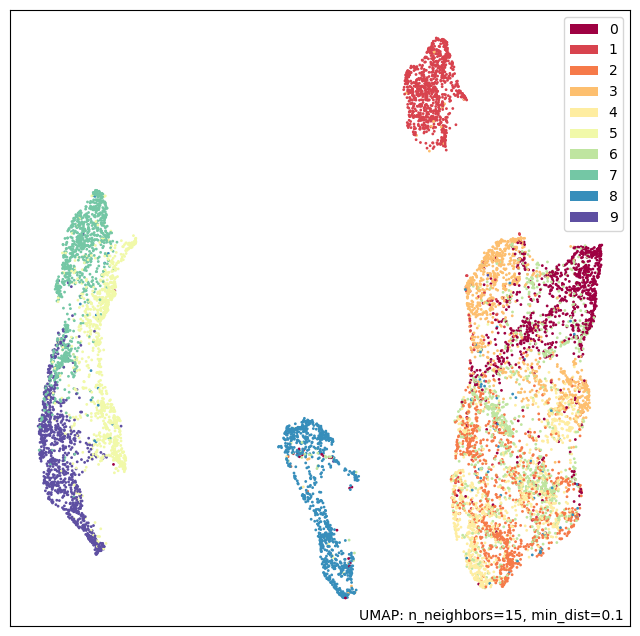

In [497]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

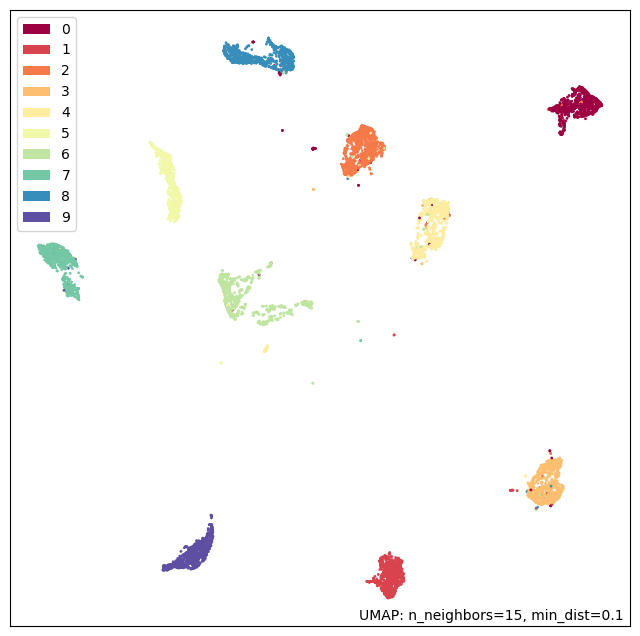

In [498]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

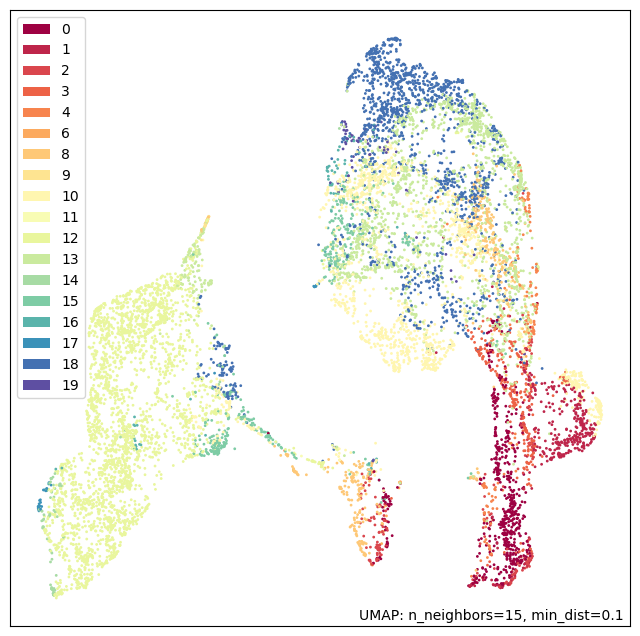

In [499]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

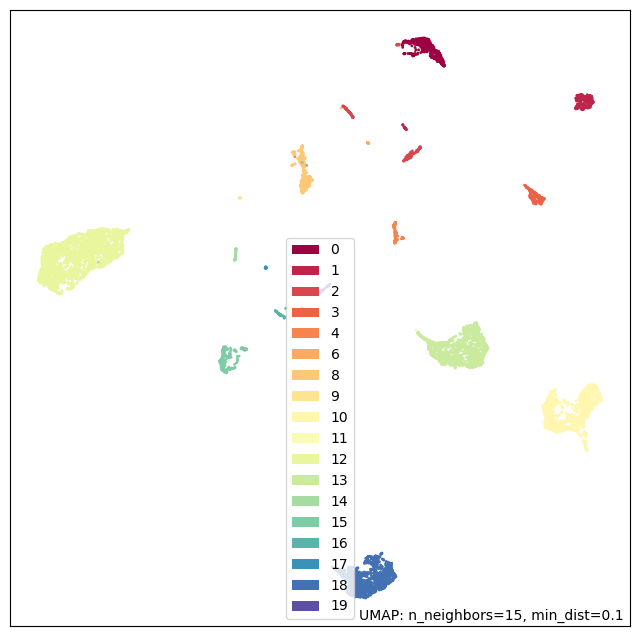

In [500]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

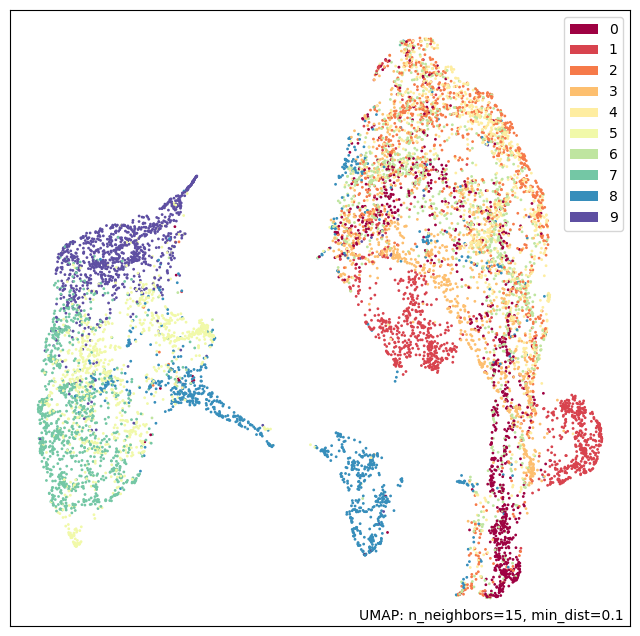

In [501]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

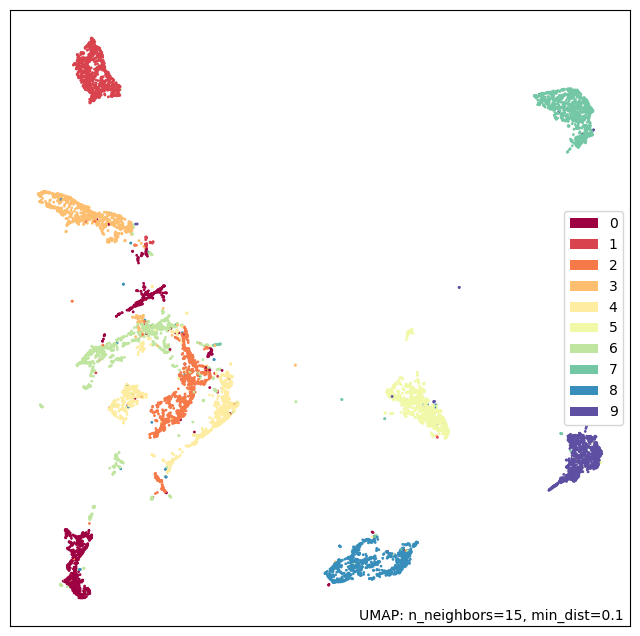

In [502]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

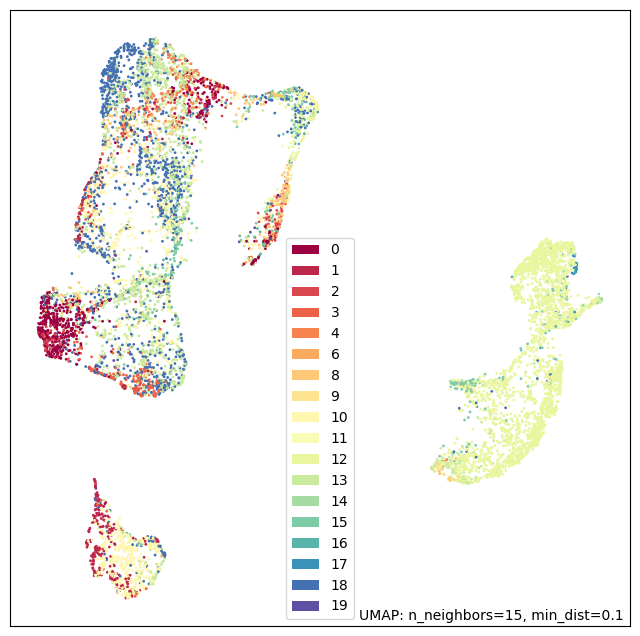

In [503]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

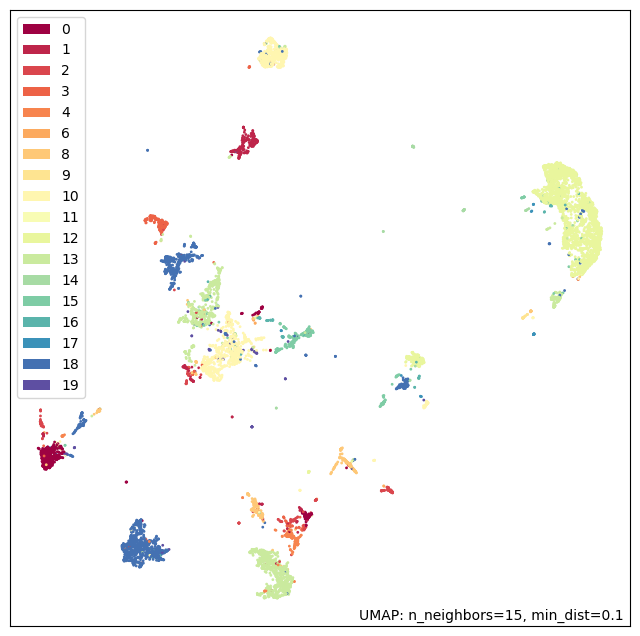

In [504]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

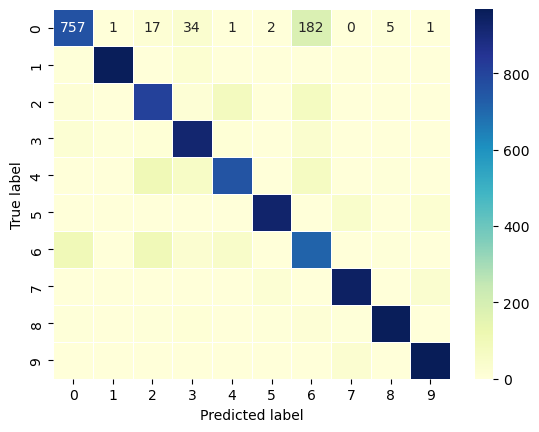

In [505]:
#Task A OG Perfomrance Evals
dataset = test_dataset
preds = []
weight_preds = []
lyrpreds = []
y_test_true = []
x_test_true = []

for tstep, (xt, yt) in enumerate(dataset):
    x_test_true.append(xt)
    y_test_true.append(yt)
    _, _, pred, lyr, weight_pred = test_step(xt, yt, WGN)
    preds.append(pred)
    weight_preds.append(weight_pred)
    lyrpreds.append(lyr)
tstacc_fn.reset_states()

y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
A_OG = accuracy_score(y_test_arg, y_pred )

#confusionmat
y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
cm = confusion_matrix(y_test_arg, y_pred)

plt.figure()
sns.heatmap(cm, fmt = 'd' , cmap="YlGnBu",  annot=True, linewidths=.5)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

In [506]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

avg = None

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "micro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\n\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "macro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "weighted"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)


Averging =  None 
accuracy =  0.8719 
precision =  [0.83461963 0.98971193 0.77246654 0.84263495 0.83795782 0.9707113
 0.65324794 0.92465753 0.97961264 0.94071914] 
recall =  [0.757 0.962 0.808 0.921 0.755 0.928 0.714 0.945 0.961 0.968] 
f1 score =  [0.79391715 0.97565923 0.78983382 0.88007645 0.79431878 0.94887526
 0.68227425 0.9347181  0.97021706 0.95416461]

classwise metrics =  (array([0.83461963, 0.98971193, 0.77246654, 0.84263495, 0.83795782,
       0.9707113 , 0.65324794, 0.92465753, 0.97961264, 0.94071914]), array([0.757, 0.962, 0.808, 0.921, 0.755, 0.928, 0.714, 0.945, 0.961,
       0.968]), array([0.79391715, 0.97565923, 0.78983382, 0.88007645, 0.79431878,
       0.94887526, 0.68227425, 0.9347181 , 0.97021706, 0.95416461]), array([1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000]))

Averging =  micro 

accuracy =  0.8719 
precision =  0.8719 
recall =  0.8719 
f1 score =  0.8719

classwise metrics =  (0.8719, 0.8719, 0.8719, None)

Averging =  macro 
accuracy =  0.8

<Axes: >

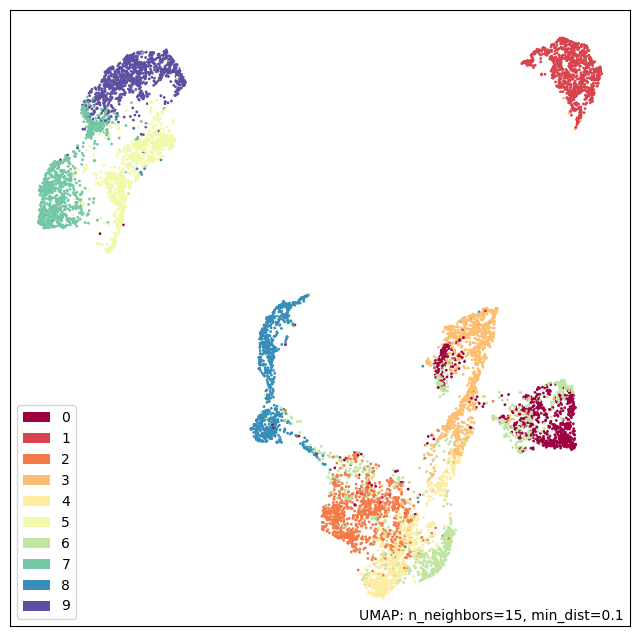

In [507]:
import umap
import umap.plot

sz=10000

imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

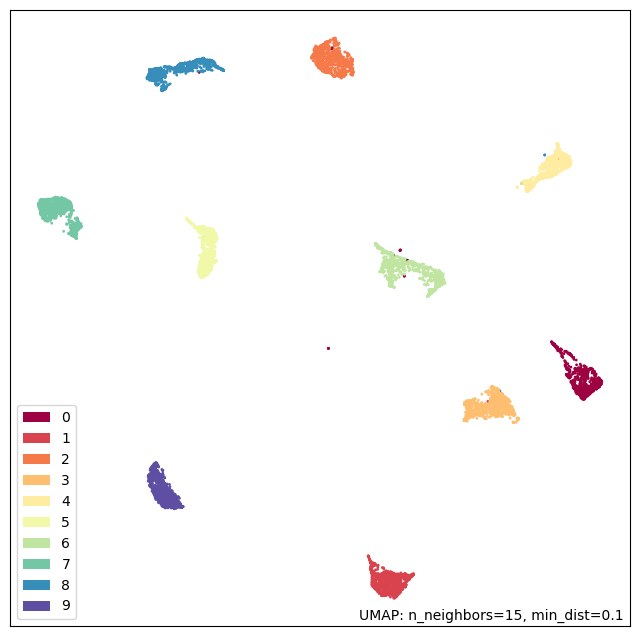

In [508]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

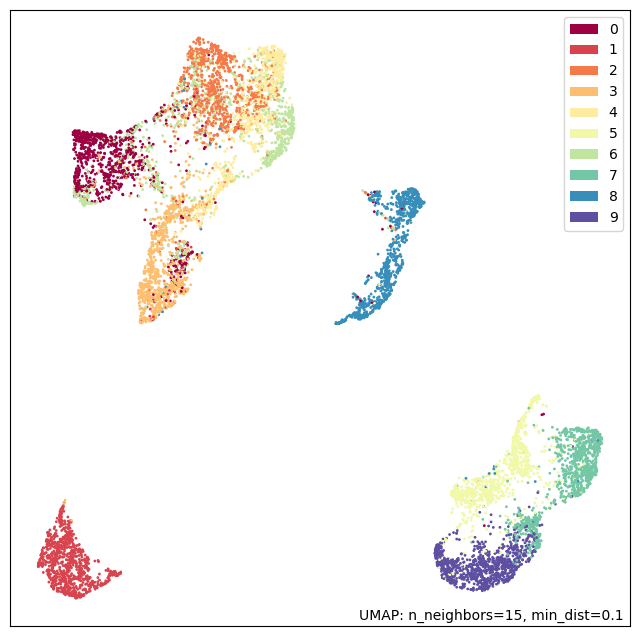

In [509]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

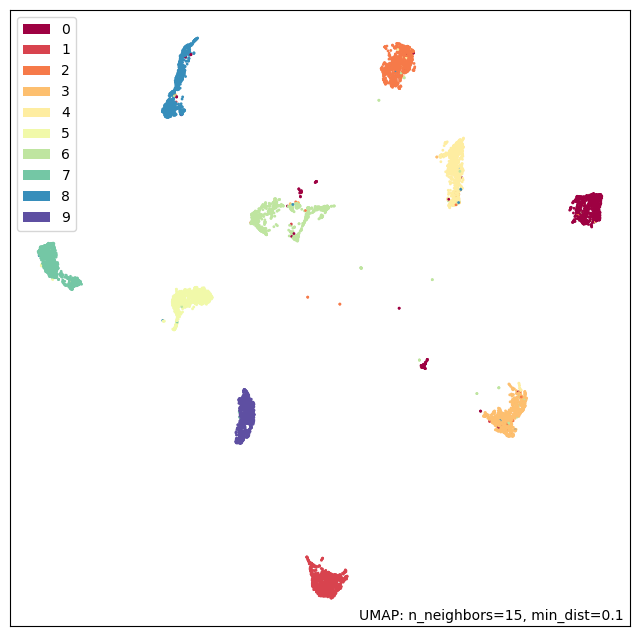

In [510]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

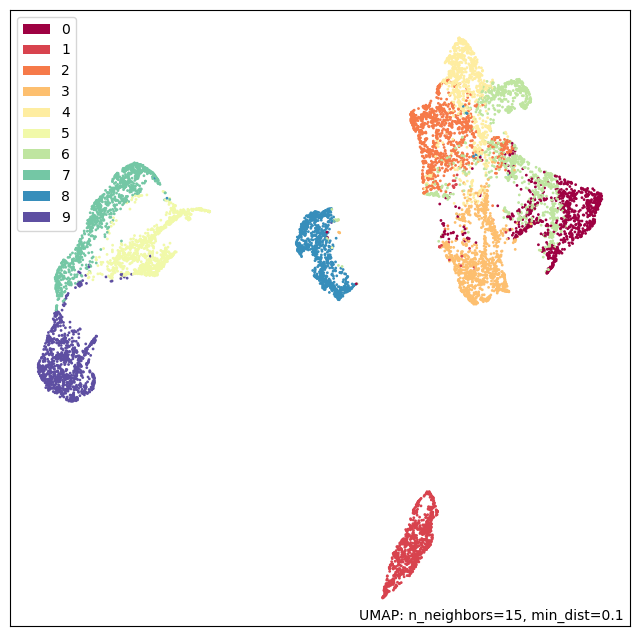

In [511]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

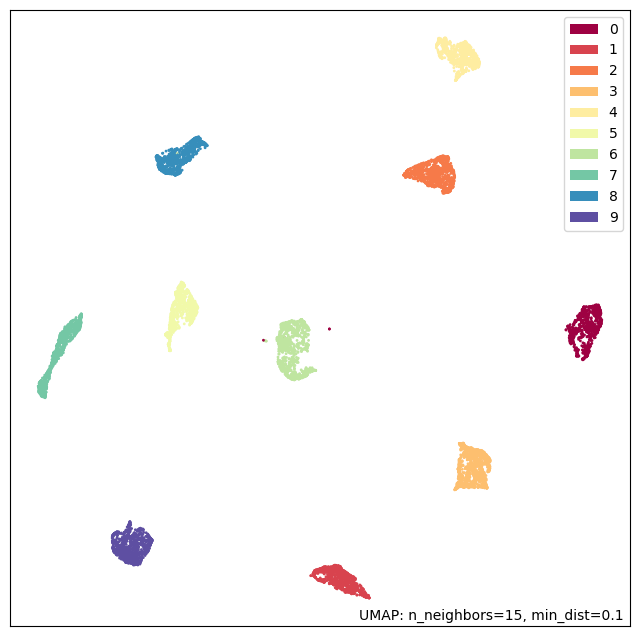

In [512]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

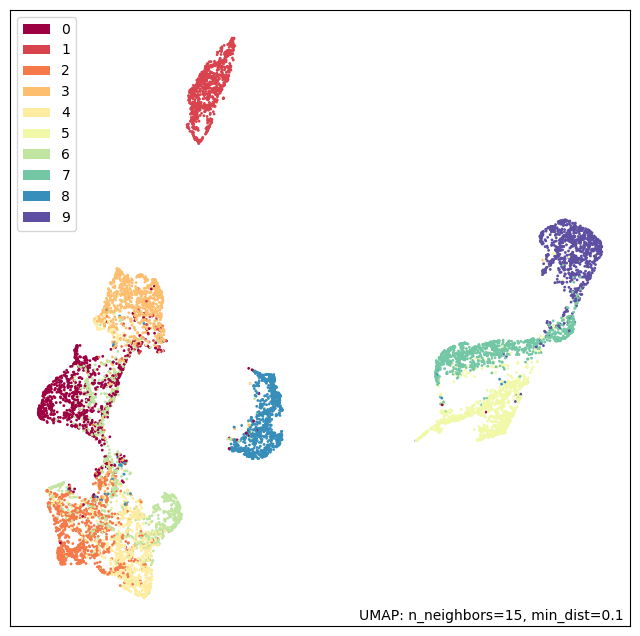

In [513]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

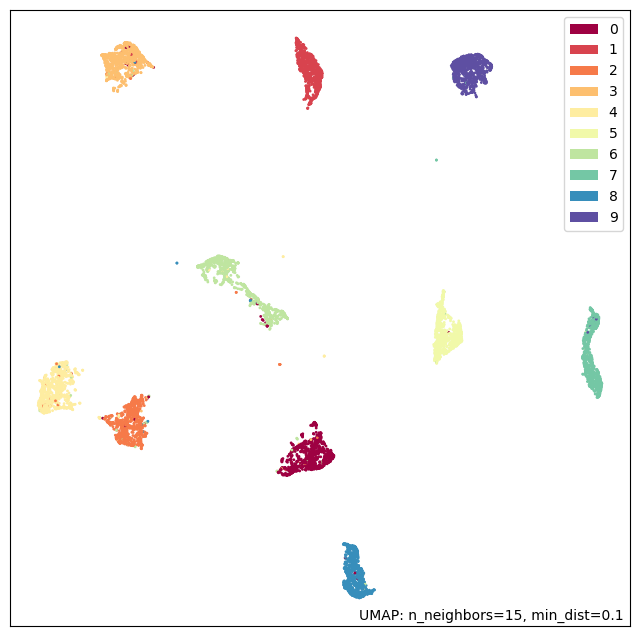

In [514]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

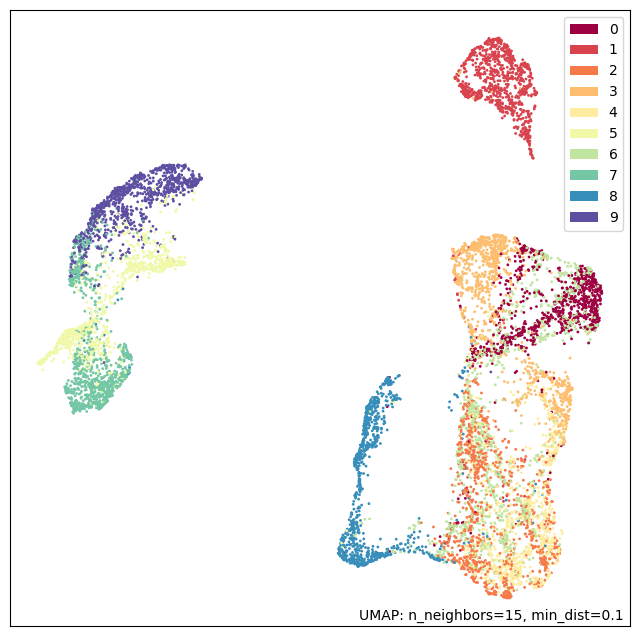

In [515]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

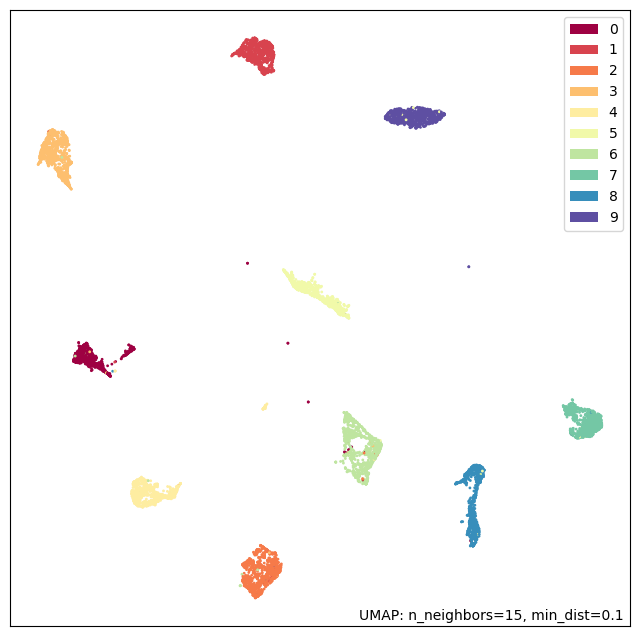

In [516]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

In [517]:
print("Task A Original Accuracy: %.2f%%" % (100*A_OG))
print("Task B EWC method penalty Accuracy: %.2f%%" % (100*B_EWC))
print("Task B SGD method Accuracy: %.2f%%" % (100*B_No_P))
print("Task A EWC method penalty Accuracy: %.2f%%" % (100*A_EWC))
print("Task A SGD method Accuracy: %.2f%%" % (100*A_No_P))



Task A Original Accuracy: 87.19%
Task B EWC method penalty Accuracy: 63.35%
Task B SGD method Accuracy: 97.50%
Task A EWC method penalty Accuracy: 68.46%
Task A SGD method Accuracy: 11.57%


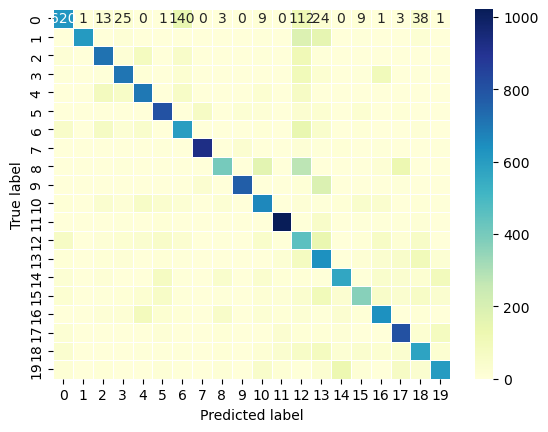

In [518]:
import pandas as pd
import seaborn as sns
from sklearn.metrics import accuracy_score, confusion_matrix

#Current Task B Perfomrance Evals
dataset = abtest_dataset
preds = []
weight_preds = []
lyrpreds = []
y_test_true = []
x_test_true = []

for tstep, (xt, yt) in enumerate(dataset):
    x_test_true.append(xt)
    y_test_true.append(yt)
    _, _, pred, lyr, weight_pred = test_step(xt, yt, WGN_ewcB)
    preds.append(pred)
    weight_preds.append(weight_pred)
    lyrpreds.append(lyr)
tstacc_fn.reset_states()

y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
B_EWC = accuracy_score(y_test_arg, y_pred )

#confusionmat
cm = confusion_matrix(y_test_arg, y_pred)

plt.figure()
sns.heatmap(cm, fmt = 'd' , cmap="YlGnBu",  annot=True, linewidths=.5)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()



In [519]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

avg = None

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "micro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\n\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "macro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "weighted"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)


Averging =  None 
accuracy =  0.65905 
precision =  [0.68281938 0.98703404 0.72379032 0.75505857 0.66761905 0.72686025
 0.61825726 0.89970789 0.70577933 0.93406593 0.60661765 0.87350427
 0.2637931  0.4140625  0.69962917 0.64736842 0.62011719 0.67674223
 0.57657658 0.68552036] 
recall =  [0.62       0.609      0.718      0.709      0.701      0.801
 0.596      0.924      0.403      0.765      0.67346939 0.90044053
 0.44476744 0.62970297 0.57637475 0.41367713 0.66283925 0.78404669
 0.59137577 0.60059465] 
f1 score =  [0.64989518 0.75324675 0.72088353 0.7313048  0.68390244 0.7621313
 0.60692464 0.91169216 0.51304901 0.8411215  0.63829787 0.8867679
 0.33116883 0.49960723 0.63204913 0.50478796 0.6407669  0.72645336
 0.58388241 0.64025357]

classwise metrics =  (array([0.68281938, 0.98703404, 0.72379032, 0.75505857, 0.66761905,
       0.72686025, 0.61825726, 0.89970789, 0.70577933, 0.93406593,
       0.60661765, 0.87350427, 0.2637931 , 0.4140625 , 0.69962917,
       0.64736842, 0.62011719, 

<Axes: >

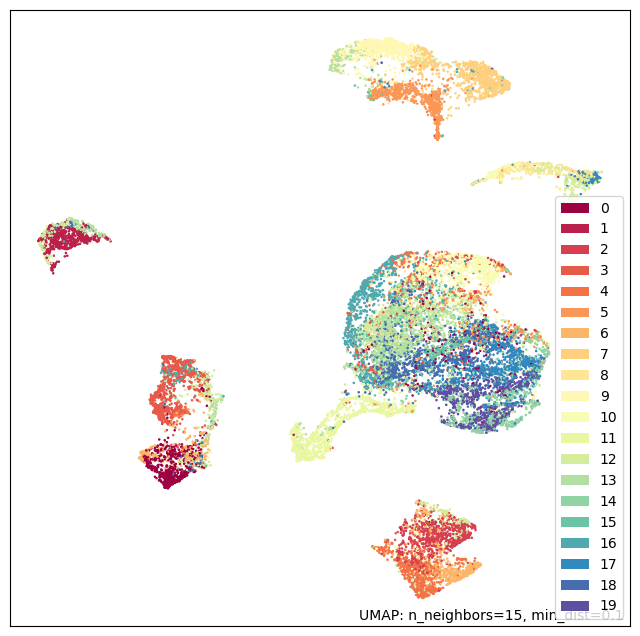

In [520]:
import umap
import umap.plot

sz=20000

imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

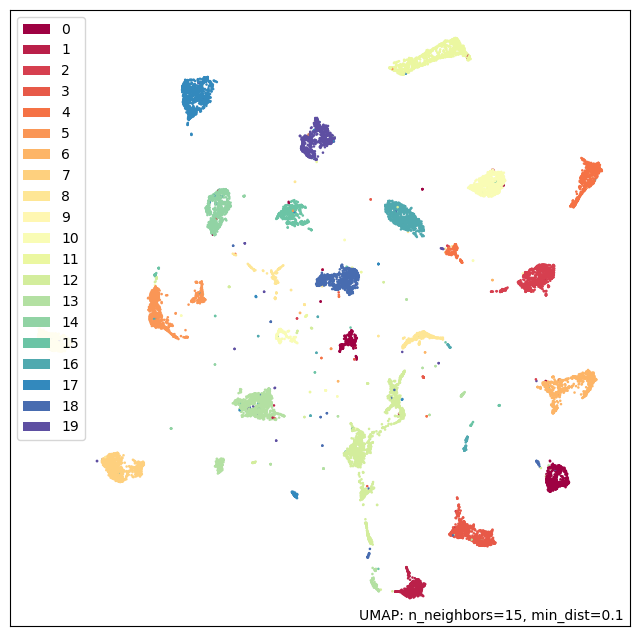

In [521]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

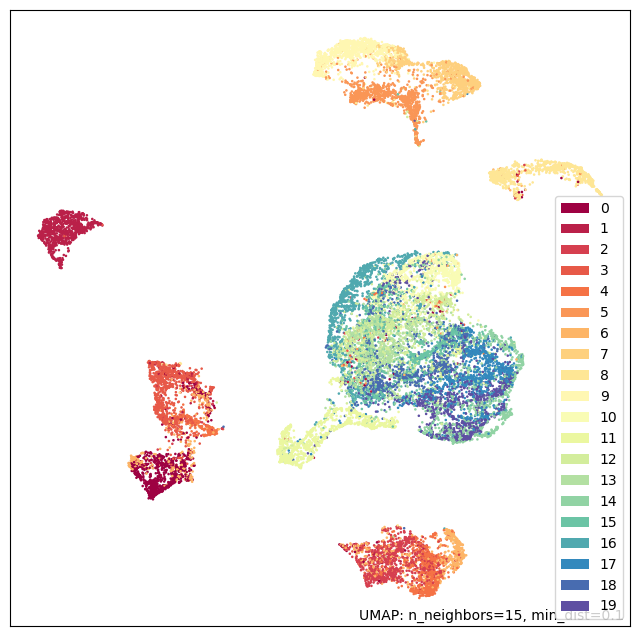

In [522]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

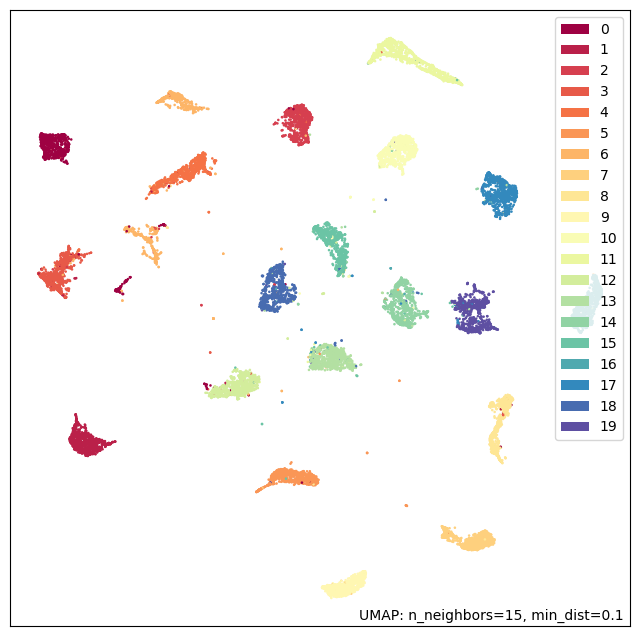

In [523]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

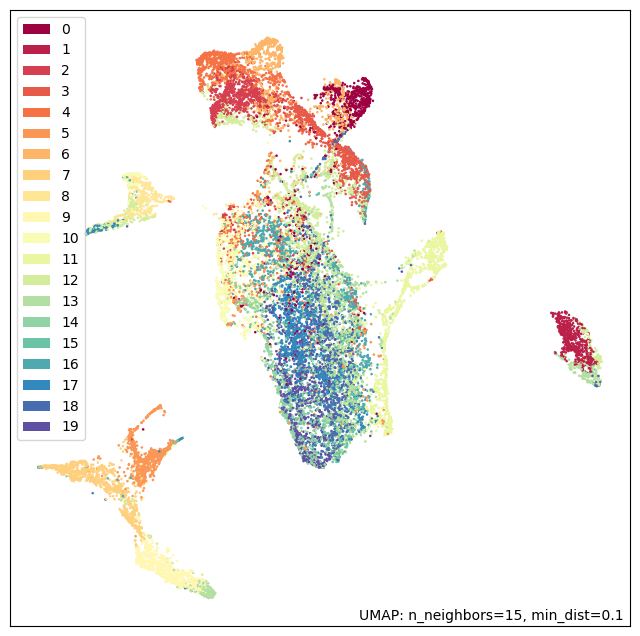

In [524]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

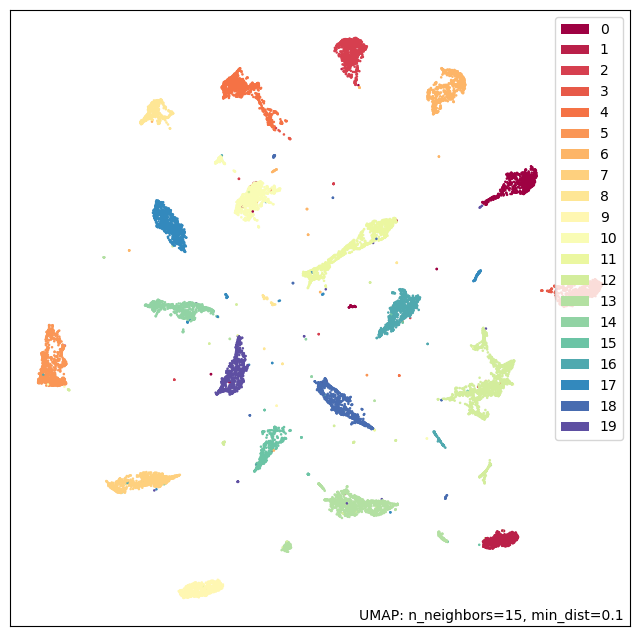

In [525]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

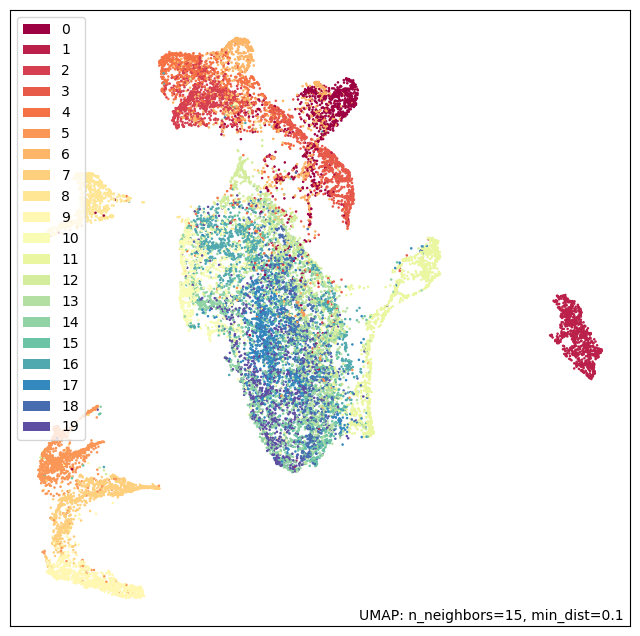

In [526]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

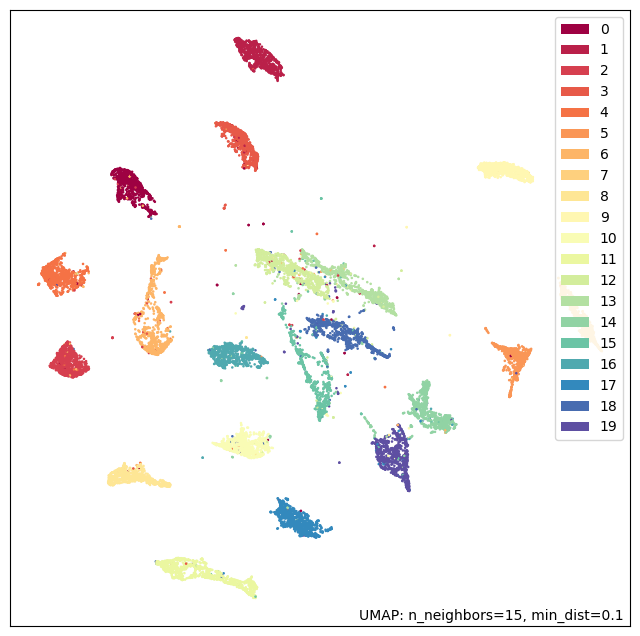

In [527]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

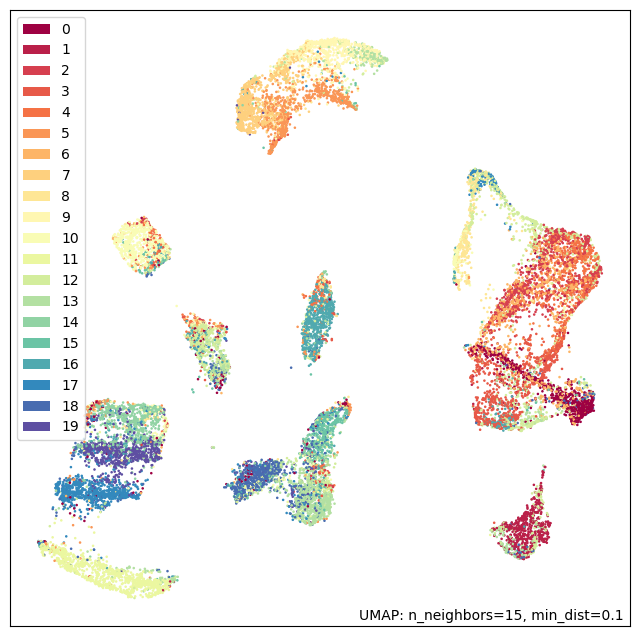

In [528]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

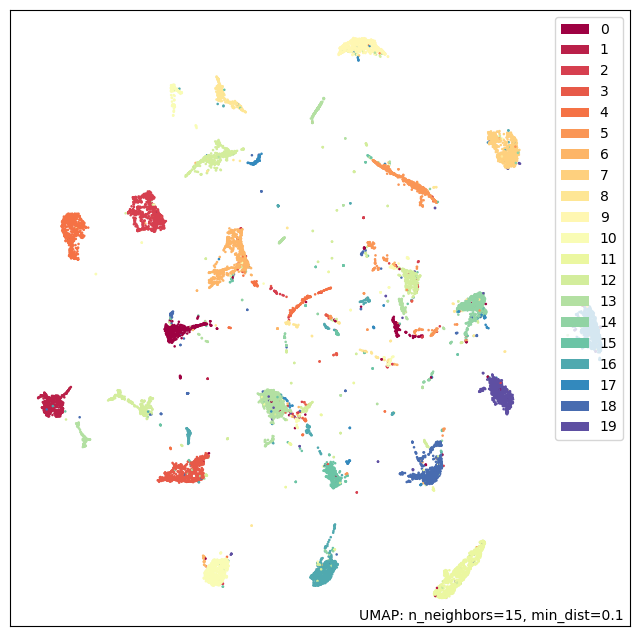

In [529]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

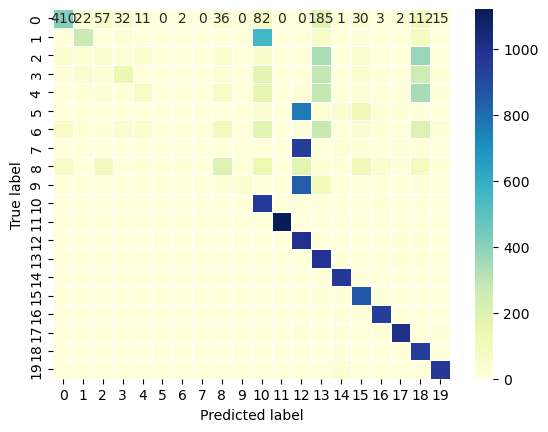

In [530]:
#Current Task B Perfomrance Evals

dataset = abtest_dataset
preds = []
weight_preds = []
lyrpreds = []
y_test_true = []
x_test_true = []

for tstep, (xt, yt) in enumerate(dataset):
    x_test_true.append(xt)
    y_test_true.append(yt)
    _, _, pred, lyr, weight_pred = test_step(xt, yt, WGN_NoP_B)
    preds.append(pred)
    weight_preds.append(weight_pred)
    lyrpreds.append(lyr)
tstacc_fn.reset_states()

y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
B_No_P = accuracy_score(y_test_arg, y_pred )

#confusionmat
cm = confusion_matrix(y_test_arg, y_pred)

plt.figure()
sns.heatmap(cm, fmt = 'd' , cmap="YlGnBu",  annot=True, linewidths=.5)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

In [531]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

avg = None

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "micro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\n\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "macro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "weighted"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)


Averging =  None 
accuracy =  0.54535 
precision =  [0.67656766 0.7320442  0.16       0.56589147 0.38011696 0.
 0.         0.         0.44251627 0.96428571 0.40557668 0.99291408
 0.26505704 0.37807692 0.88553114 0.67987322 0.89809524 0.94001874
 0.38602194 0.91825095] 
recall =  [0.41       0.265      0.04       0.146      0.065      0.
 0.         0.         0.204      0.027      0.97959184 0.9876652
 0.96802326 0.97326733 0.98472505 0.96188341 0.98434238 0.97568093
 0.97535934 0.95738355] 
f1 score =  [0.51058531 0.38913363 0.064      0.23211447 0.11101623 0.
 0.         0.         0.27926078 0.05252918 0.57364804 0.99028269
 0.4161633  0.54459834 0.93249759 0.79665738 0.93924303 0.9575179
 0.55312955 0.93740902]

classwise metrics =  (array([0.67656766, 0.7320442 , 0.16      , 0.56589147, 0.38011696,
       0.        , 0.        , 0.        , 0.44251627, 0.96428571,
       0.40557668, 0.99291408, 0.26505704, 0.37807692, 0.88553114,
       0.67987322, 0.89809524, 0.94001874, 0.38602

/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj

<Axes: >

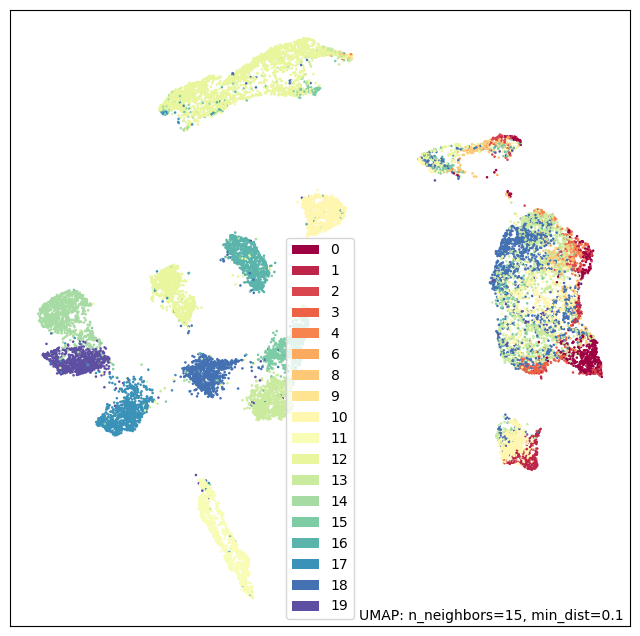

In [532]:
import umap
import umap.plot

sz=20000

imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

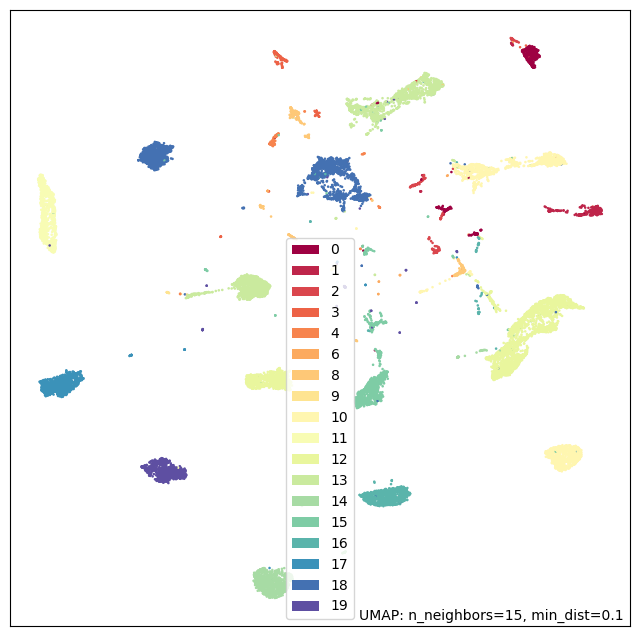

In [533]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

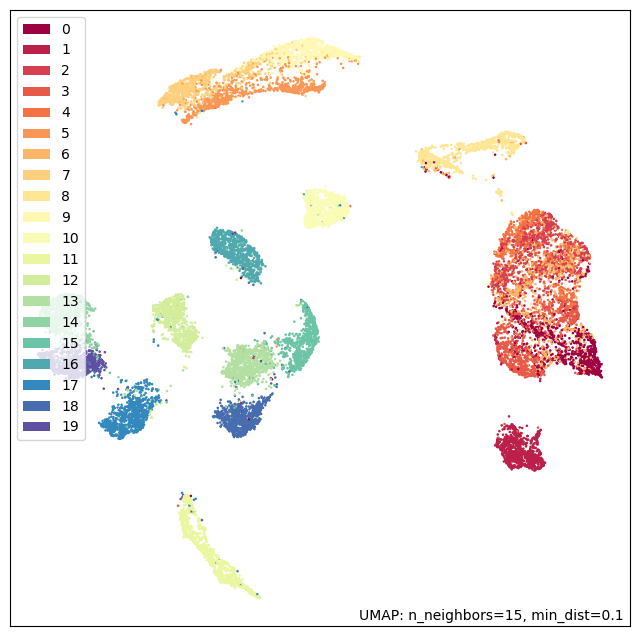

In [534]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

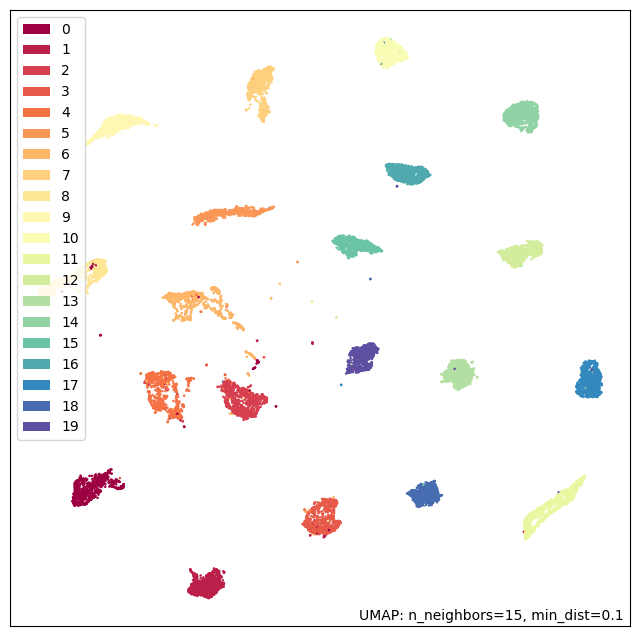

In [535]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

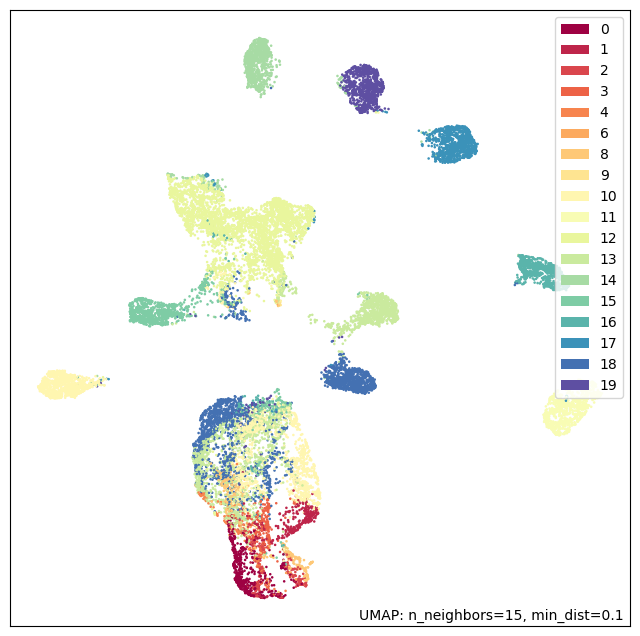

In [536]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

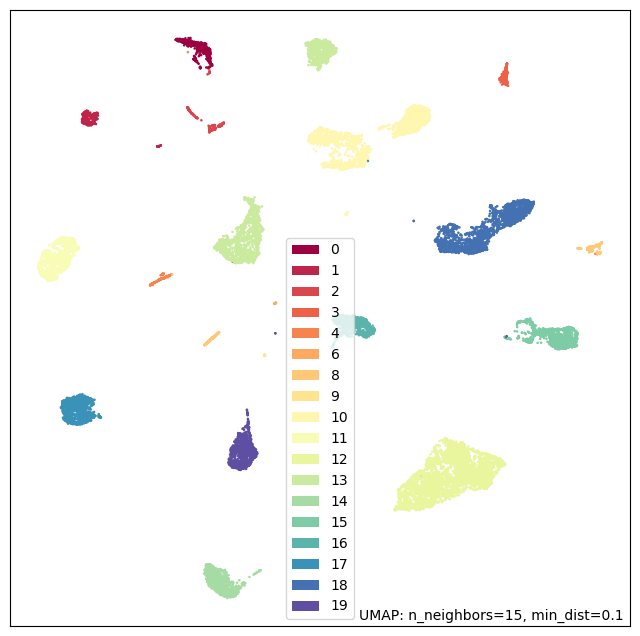

In [537]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

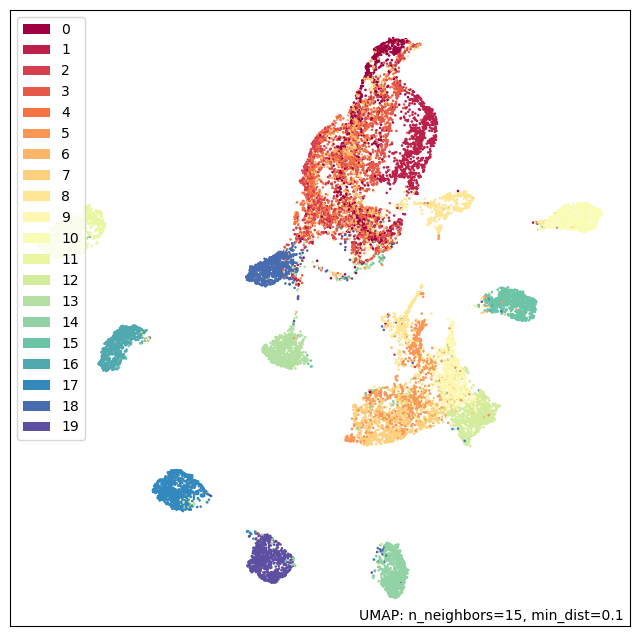

In [538]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

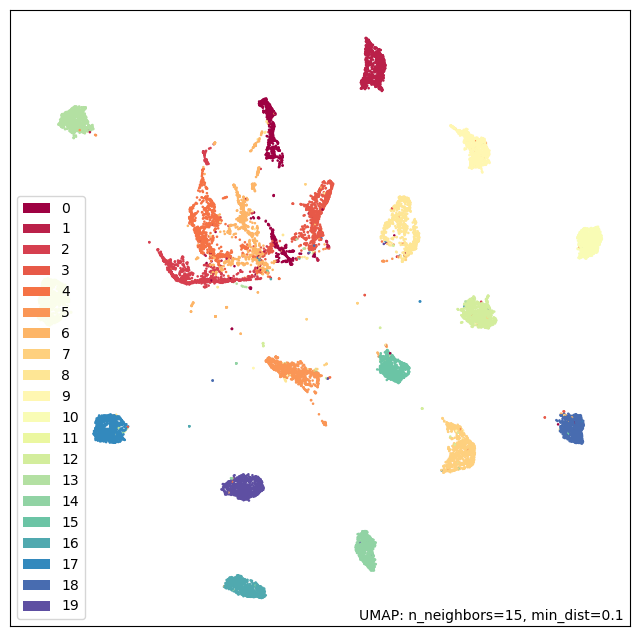

In [539]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

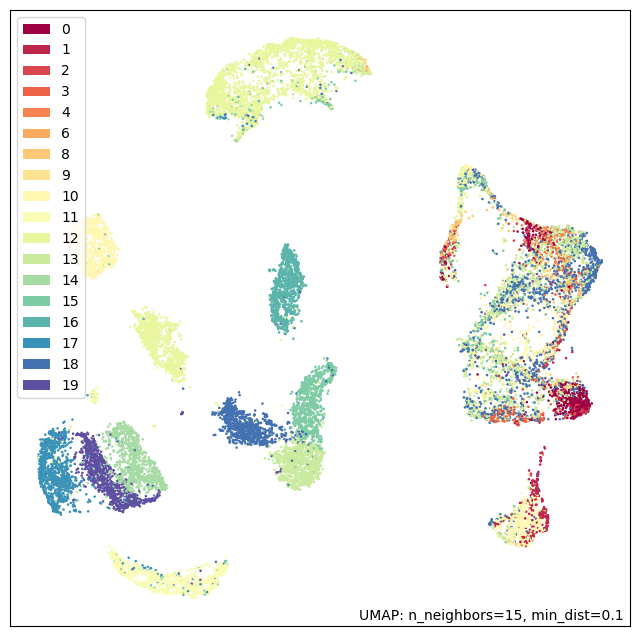

In [540]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

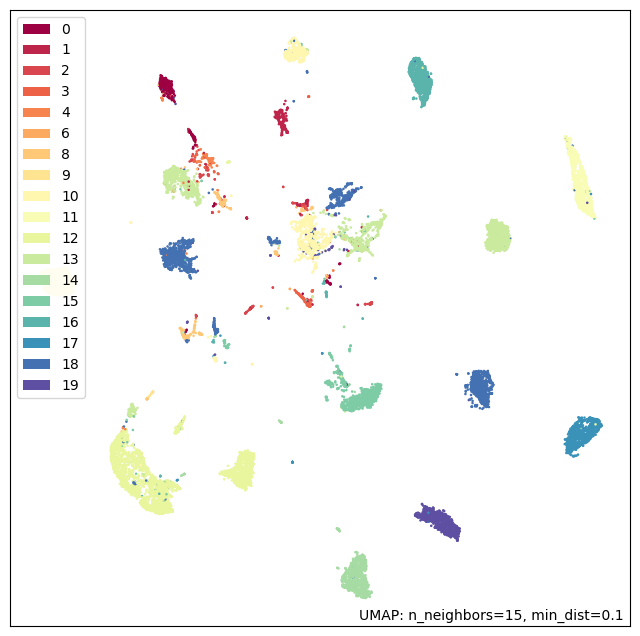

In [541]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

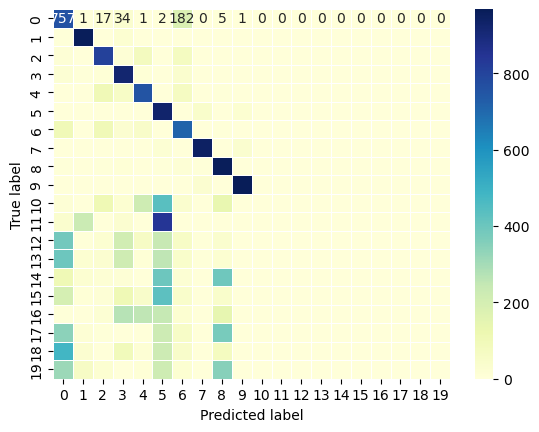

In [542]:
#Task A OG Perfomrance Evals
dataset = abtest_dataset
preds = []
weight_preds = []
lyrpreds = []
y_test_true = []
x_test_true = []
for tstep, (xt, yt) in enumerate(dataset):
    x_test_true.append(xt)
    y_test_true.append(yt)
    _, _, pred, lyr, weight_pred = test_step(xt, yt, WGN)
    preds.append(pred)
    weight_preds.append(weight_pred)
    lyrpreds.append(lyr)
tstacc_fn.reset_states()

y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
A_OG = accuracy_score(y_test_arg, y_pred )

#confusionmat
y_test_arg = np.argmax(y_test_true, axis=-1)
y_pred = np.argmax(preds, axis=-1)
cm = confusion_matrix(y_test_arg, y_pred)

plt.figure()
sns.heatmap(cm, fmt = 'd' , cmap="YlGnBu",  annot=True, linewidths=.5)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

In [543]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

avg = None

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "micro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\n\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "macro"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)

avg = "weighted"

acs = accuracy_score(y_test_arg, y_pred)
pcs = precision_score(y_test_arg, y_pred, average = avg)
rcs = recall_score(y_test_arg, y_pred, average = avg)
fcs = f1_score(y_test_arg, y_pred, average = avg)

prfs = precision_recall_fscore_support(y_test_arg, y_pred, average = avg)

print("\nAverging = ", avg, "\naccuracy = ", acs, "\nprecision = ", pcs, "\nrecall = ", rcs, "\nf1 score = ", fcs)
print("\nclasswise metrics = ", prfs)


Averging =  None 
accuracy =  0.43595 
precision =  [0.2364886  0.70218978 0.62587142 0.44643723 0.49378679 0.20755983
 0.49377593 0.91040462 0.37568413 0.93707648 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.        ] 
recall =  [0.757 0.962 0.808 0.921 0.755 0.928 0.714 0.945 0.961 0.968 0.    0.
 0.    0.    0.    0.    0.    0.    0.    0.   ] 
f1 score =  [0.36039038 0.81181435 0.70536883 0.6013712  0.59707394 0.33924328
 0.5838103  0.92737978 0.54019112 0.95228726 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.        ]

classwise metrics =  (array([0.2364886 , 0.70218978, 0.62587142, 0.44643723, 0.49378679,
       0.20755983, 0.49377593, 0.91040462, 0.37568413, 0.93707648,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ]), array([0.757, 0.962, 0.808, 0.921, 0.755, 0.928, 0.714, 0.945, 0.961,
       0.968, 0.   , 0

/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/shriraj

<Axes: >

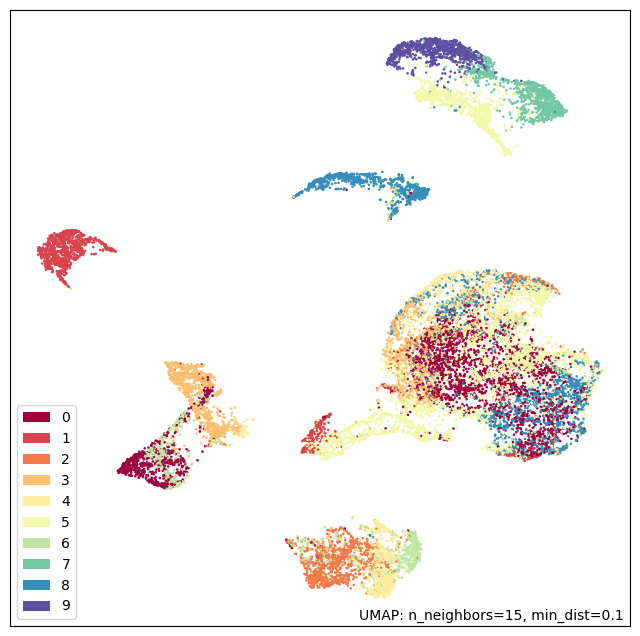

In [544]:
import umap
import umap.plot

sz=20000

imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

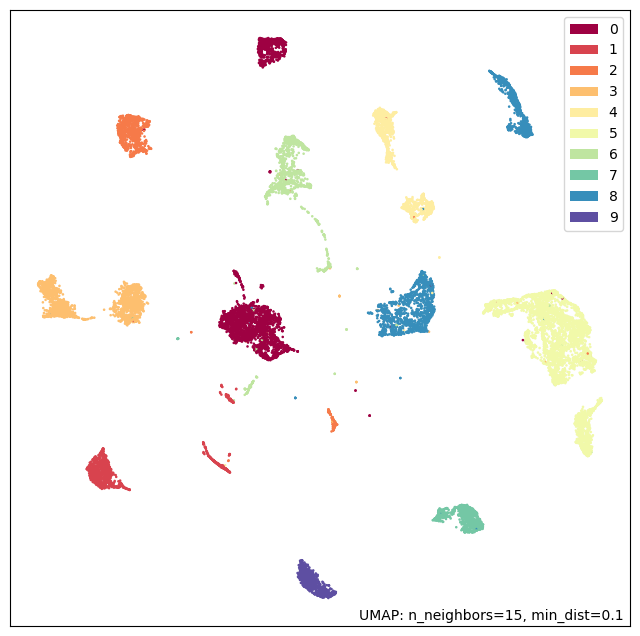

In [545]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

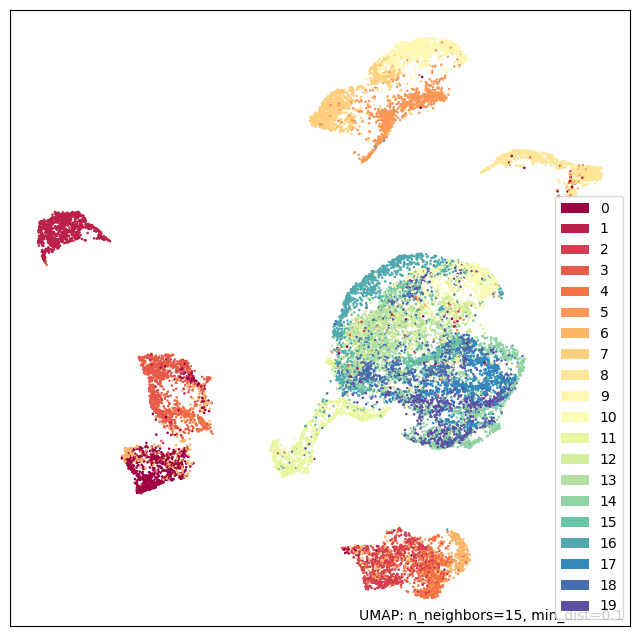

In [546]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

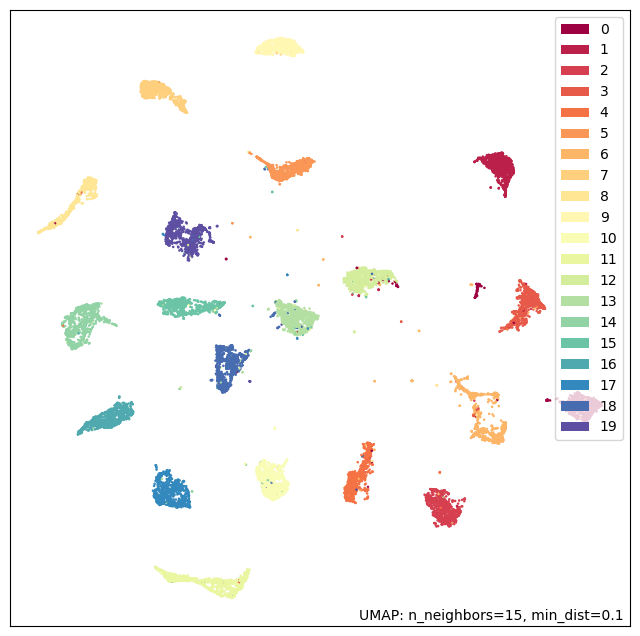

In [547]:
imgs = np.array(weight_preds).reshape(sz,num_weights_to_generate)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

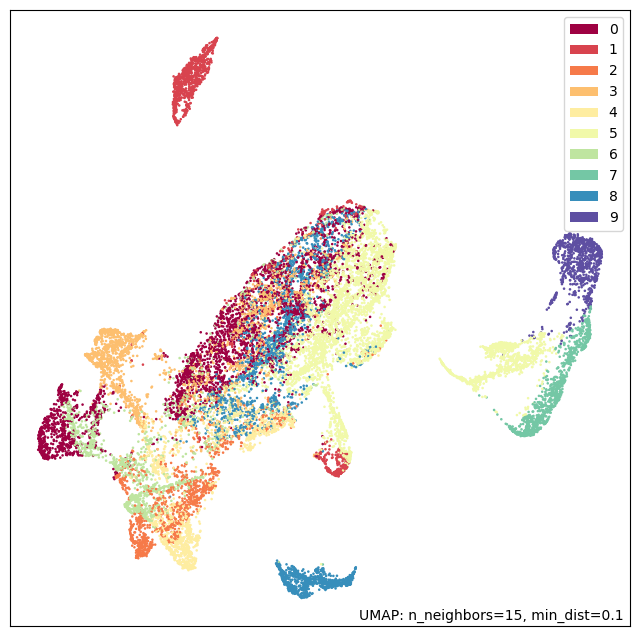

In [548]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

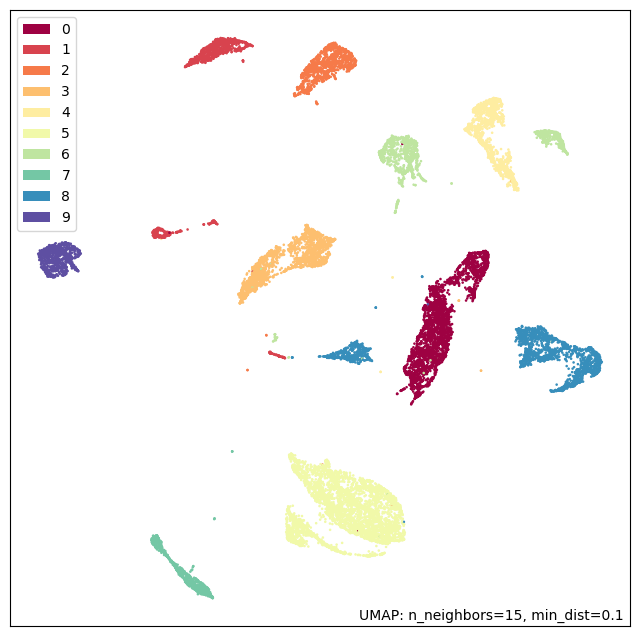

In [549]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

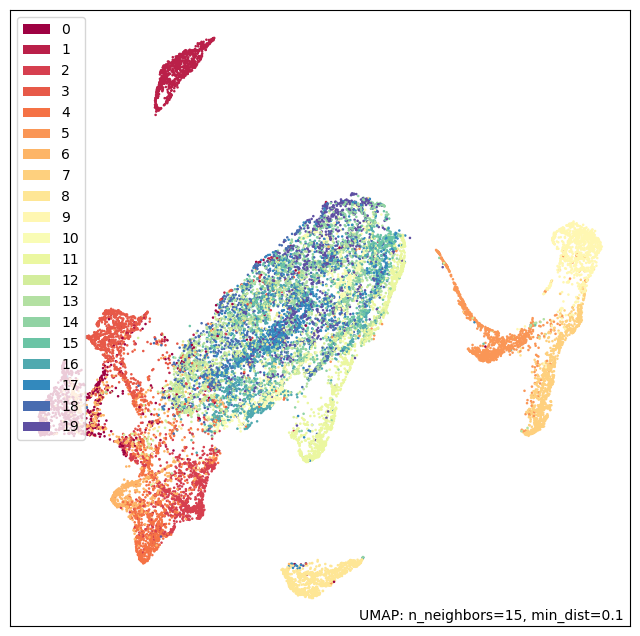

In [550]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

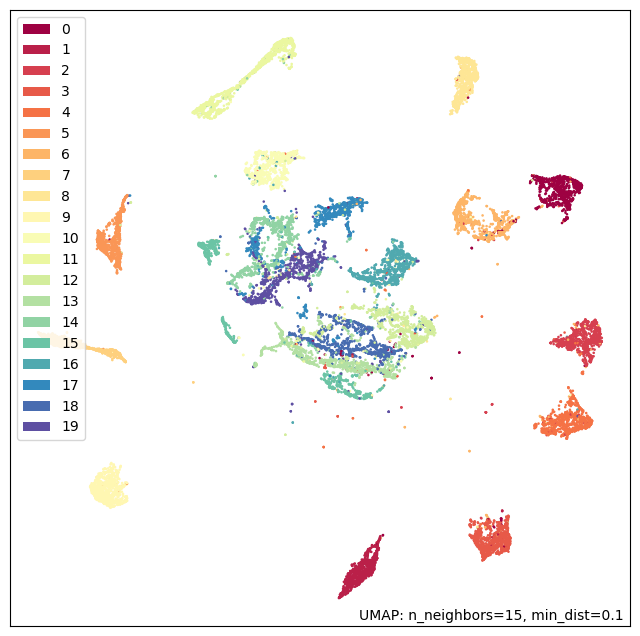

In [551]:
imgs = np.array(lyrpreds).reshape(sz,20)
labels = np.argmax(np.asarray(y_test_true).reshape(sz,20), axis=1)

mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

<Axes: >

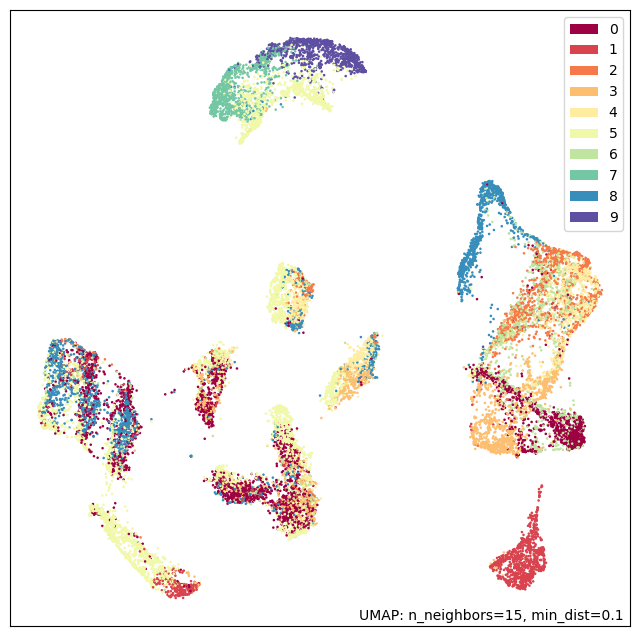

In [552]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs)
umap.plot.points(mapper, labels=labels)

<Axes: >

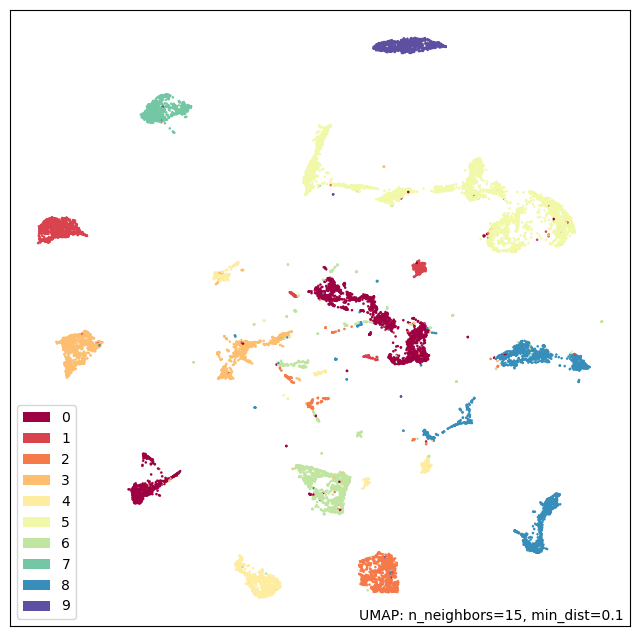

In [553]:
imgs = np.asarray(x_test_true).reshape(sz, 784).astype("float32") / 255
labels = np.argmax(np.array(preds).reshape(sz,20), axis=1)
mapper = umap.UMAP().fit(imgs, labels)
umap.plot.points(mapper, labels=labels)

In [554]:
print("Task A Original Accuracy: %.2f%%" % (100*A_OG))
print("Task B EWC method penalty Accuracy: %.2f%%" % (100*B_EWC))
print("Task B SGD method Accuracy: %.2f%%" % (100*B_No_P))



Task A Original Accuracy: 43.59%
Task B EWC method penalty Accuracy: 65.91%
Task B SGD method Accuracy: 54.53%
